# IBM Applied Data Science Capstone Project

# The Battle of Neighborhoods (Week 2)

# Problem Statement

The objective is to locate and recommend the ideal location for opening an Italian restaurant.

In [1]:
import pandas as pd
import numpy as np

pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

import requests
from bs4 import BeautifulSoup 

from geopy.geocoders import Nominatim # convert an address into latitude and longitude values

#!conda install -c conda-forge folium

import os
!pip install folium
import folium 

import matplotlib.pyplot as plt
import matplotlib.cm as cm
import matplotlib.colors as colors
import matplotlib as mp
import re
import csv
%matplotlib inline

print('Libraries imported.')

     |████████████████████████████████| 94 kB 5.4 MB/s  eta 0:00:01
Libraries imported.


# Download and Explore Dataset.

New York City has a total of 5 boroughs and 306 neighborhoods. In order to segement the neighborhoods and explore them, we will essentially need a dataset that contains the 5 boroughs and the neighborhoods that exist in each borough as well as the the latitude and logitude coordinates of each neighborhood.

Then, we will scrape data from wikipedia into a dataframe using BeautifulSoup package. The data source is https://en.wikipedia.org/wiki/New_York_City. This was used to get the population demographics of the five NYC boroughs.

In [2]:
response_obj = requests.get('https://en.wikipedia.org/wiki/New_York_City').text
soup = BeautifulSoup(response_obj,'html.parser')
#soup = BeautifulSoup(response_obj,'lxml')
Neighborhoods_NYC_Table = soup.find('table', {'class':'wikitable sortable'})

In [3]:
rows = Neighborhoods_NYC_Table.select("tbody > tr")[3:8]

boroughs = []
for row in rows:
    borough = {}
    tds = row.select('td')
    borough["borough"] = tds[0].text.strip()
    borough["county"] = tds[1].text.strip()
    borough["population"] = float(tds[2].text.strip().replace(",",""))
    borough["gdp_billions"] = float(tds[3].text.strip().replace(",",""))
    borough["gdp_per_capita"] = float(tds[4].text.strip().replace(",",""))
    borough["land_sqm"] = float(tds[5].text.strip().replace(",",""))
    borough["land_sqkm"] = float(tds[6].text.strip().replace(",",""))
    borough["persons_sqm"] = float(tds[7].text.strip().replace(",",""))
    borough["persons_sqkm"] = float(tds[8].text.strip().replace(",",""))
    
    boroughs.append(borough)

print(boroughs)

[{'borough': 'The Bronx', 'county': 'Bronx', 'population': 1418207.0, 'gdp_billions': 42.695, 'gdp_per_capita': 30100.0, 'land_sqm': 42.1, 'land_sqkm': 109.04, 'persons_sqm': 33867.0, 'persons_sqkm': 13006.0}, {'borough': 'Brooklyn', 'county': 'Kings', 'population': 2559903.0, 'gdp_billions': 91.559, 'gdp_per_capita': 35800.0, 'land_sqm': 70.82, 'land_sqkm': 183.42, 'persons_sqm': 36147.0, 'persons_sqkm': 13957.0}, {'borough': 'Manhattan', 'county': 'New York', 'population': 1628706.0, 'gdp_billions': 600.244, 'gdp_per_capita': 368500.0, 'land_sqm': 22.83, 'land_sqkm': 59.13, 'persons_sqm': 71341.0, 'persons_sqkm': 27544.0}, {'borough': 'Queens', 'county': 'Queens', 'population': 2253858.0, 'gdp_billions': 93.31, 'gdp_per_capita': 41400.0, 'land_sqm': 108.53, 'land_sqkm': 281.09, 'persons_sqm': 20767.0, 'persons_sqkm': 8018.0}, {'borough': 'Staten Island', 'county': 'Richmond', 'population': 476143.0, 'gdp_billions': 14.514, 'gdp_per_capita': 30500.0, 'land_sqm': 58.37, 'land_sqkm': 15

In [4]:
df = pd.DataFrame(boroughs, columns=["borough","county", "population", "gdp_per_capita", "persons_sqkm"]) 
df.head()

,borough,county,population,gdp_per_capita,persons_sqkm
0,The Bronx,Bronx,1418207.0,30100.0,13006.0
1,Brooklyn,Kings,2559903.0,35800.0,13957.0
2,Manhattan,New York,1628706.0,368500.0,27544.0
3,Queens,Queens,2253858.0,41400.0,8018.0
4,Staten Island,Richmond,476143.0,30500.0,3150.0


Neighborhoods using FourSquare API & New York City data that contains list Boroughs, Neighborhoods along with their latitude and longitude.

In [5]:
def geo_location(address):
    # get geo location of address
    geolocator = Nominatim(user_agent="ny_agent")
    location = geolocator.geocode(address)
    latitude = location.latitude
    longitude = location.longitude
    return latitude,longitude

Define a function to interact with FourSquare API and get top 100 venues within a radius of 500 metres for a given latitude and longitude.

In [6]:
def get_venues(lat,lng):
    
    #set variables
    radius=1000
    LIMIT=100
    CLIENT_ID = '1EVBZSDTXZBSLMZURSV2F1HHL2PDL1T454KB0CLTZJNVZWZ4' # your Foursquare ID
    CLIENT_SECRET = 'NBO5YJZMBIKQD1JHJEFGG5MPABVZ4A1M0EDTXBHIOGIZ5UTA' # your Foursquare Secret
    VERSION = '20200605' # Foursquare API version
    
    #url to fetch data from foursquare api
    url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}'.format(
            CLIENT_ID, 
            CLIENT_SECRET, 
            VERSION, 
            lat, 
            lng, 
            radius, 
            LIMIT)
    
    # get all the data
    results = requests.get(url).json()
    print(results)
    venue_data=results["response"]['groups'][0]['items']
    venue_details=[]
    for row in venue_data:
        try:
            venue_id=row['venue']['id']
            venue_name=row['venue']['name']
            venue_category=row['venue']['categories'][0]['name']
            venue_details.append([venue_id,venue_name,venue_category])
        except KeyError:
            pass
        
    column_names=['ID','Name','Category']
    df = pd.DataFrame(venue_details,columns=column_names)
    return df

Define a function to get venue details like like count, rating, tip counts for a given venue id to be used for ranking.

In [7]:
def get_venue_details(venue_id):
    
    CLIENT_ID = '1EVBZSDTXZBSLMZURSV2F1HHL2PDL1T454KB0CLTZJNVZWZ4' # your Foursquare ID
    CLIENT_SECRET = 'NBO5YJZMBIKQD1JHJEFGG5MPABVZ4A1M0EDTXBHIOGIZ5UTA' # your Foursquare Secret
    VERSION = '20200605' # Foursquare API version
    
    #url to fetch data from foursquare api
    url = 'https://api.foursquare.com/v2/venues/{}?&client_id={}&client_secret={}&v={}'.format(
            venue_id,
            CLIENT_ID, 
            CLIENT_SECRET, 
            VERSION)
    # get all the data
    results = requests.get(url).json()
    print(results)
    venue_data=results['response']['venue']
    venue_details=[]
    try:
        venue_id=venue_data['id']
        venue_name=venue_data['name']
        venue_likes=venue_data['likes']['count']
        venue_rating=venue_data['rating']
        venue_tips=venue_data['tips']['count']
        venue_details.append([venue_id,venue_name,venue_likes,venue_rating,venue_tips])
    except KeyError:
        pass
    column_names=['ID','Name','Likes','Rating','Tips']
    df = pd.DataFrame(venue_details,columns=column_names)
    return df

Define a function to get New York City data such as Boroughs, Neighborhoods along with their latitude and longitude.

In [8]:
def get_new_york_data():
    url='https://cocl.us/new_york_dataset'
    resp=requests.get(url).json()
    # all data is present in features label
    features=resp['features']
    
    # define the dataframe columns
    column_names = ['Borough', 'Neighborhood', 'Latitude', 'Longitude'] 
    # instantiate the dataframe
    new_york_data = pd.DataFrame(columns=column_names)
    
    for data in features:
        borough = data['properties']['borough'] 
        neighborhood_name = data['properties']['name']
        neighborhood_latlon = data['geometry']['coordinates']
        neighborhood_lat = neighborhood_latlon[1]
        neighborhood_lon = neighborhood_latlon[0]
        new_york_data = new_york_data.append({'Borough': borough,
                                          'Neighborhood': neighborhood_name,
                                          'Latitude': neighborhood_lat,
                                          'Longitude': neighborhood_lon}, ignore_index=True)
    return new_york_data

In [9]:
# get new york data
new_york_data = get_new_york_data()

In [10]:
new_york_data.head()

,Borough,Neighborhood,Latitude,Longitude
0,Bronx,Wakefield,40.894705,-73.847201
1,Bronx,Co-op City,40.874294,-73.829939
2,Bronx,Eastchester,40.887556,-73.827806
3,Bronx,Fieldston,40.895437,-73.905643
4,Bronx,Riverdale,40.890834,-73.912585


In [11]:
new_york_data.shape

(306, 4)

Based on the dataset, there are a total of 306 different Neighborhoods in New York to select from

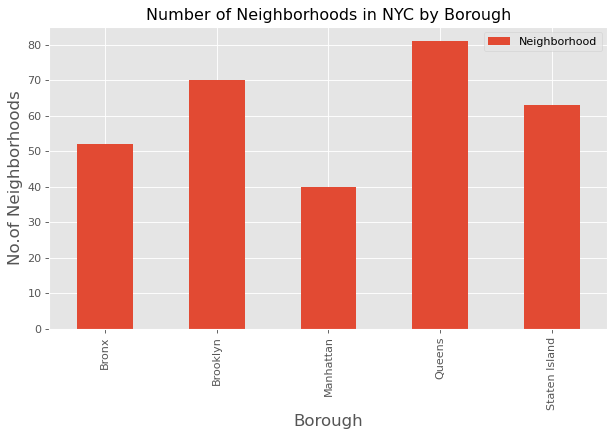

In [13]:
from matplotlib import pyplot as plt
plt.style.use('ggplot')

plt.figure(figsize=(9,5), dpi = 80)
# title
plt.title('Number of Neighborhoods in NYC by Borough')
#On x-axis
plt.xlabel('Borough', fontsize = 15)
#On y-axis
plt.ylabel('No.of Neighborhoods', fontsize=15)
#giving a bar plot
new_york_data.groupby('Borough')['Neighborhood'].count().plot(kind='bar')
#legend
plt.legend()
plt.show()

Based on the data above, Queens is the most densely populated NYC borough.

In [14]:
# prepare neighborhood list that contains italian restaurant
column_names=['Borough', 'Neighborhood', 'ID','Name']
italian_rest_ny=pd.DataFrame(columns=column_names)
count=1
for row in new_york_data.values.tolist():
    Borough, Neighborhood, Latitude, Longitude=row
    venues = get_venues(Latitude,Longitude)
    italian_resturants=venues[venues['Category']=='Italian Restaurant']   
    print('(',count,'/',len(new_york_data),')','Italian Restaurants in '+Neighborhood+', '+Borough+':'+str(len(italian_resturants)))
    print(row)
    for resturant_detail in italian_resturants.values.tolist():
        id, name , category=resturant_detail
        italian_rest_ny = italian_rest_ny.append({'Borough': Borough,
                                                'Neighborhood': Neighborhood, 
                                                'ID': id,
                                                'Name' : name
                                               }, ignore_index=True)
    count+=1

{'meta': {'code': 200, 'requestId': '600522b514532e7aaf9249f2'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Wakefield', 'headerFullLocation': 'Wakefield, Bronx', 'headerLocationGranularity': 'neighborhood', 'totalResults': 50, 'suggestedBounds': {'ne': {'lat': 40.903705185610015, 'lng': -73.83531662200086}, 'sw': {'lat': 40.88570516760999, 'lng': -73.85908441909719}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c537892fd2ea593cb077a28', 'name': 'Lollipops Gelato', 'location': {'address': '4120 Baychester Ave', 'crossStreet': 'Edenwald & Bussing Ave', 'lat': 40.894123150205274, 'lng': -73.84589162362325, 'labeledLatLngs': [{'label': 'display', 'lat': 40.894123150205274, 'lng': -73.84

{'meta': {'code': 200, 'requestId': '600522b5ac791133548371fa'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Co-Op City', 'headerFullLocation': 'Co-Op City, Bronx', 'headerLocationGranularity': 'neighborhood', 'totalResults': 88, 'suggestedBounds': {'ne': {'lat': 40.88329420203013, 'lng': -73.81805887418497}, 'sw': {'lat': 40.865294184030105, 'lng': -73.84181934206299}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '524b6ca6498e92aa03e03ff4', 'name': 'Dumplin Shop', 'location': {'address': '1530 E 222nd St', 'lat': 40.876042191838856, 'lng': -73.83595004760689, 'labeledLatLngs': [{'label': 'display', 'lat': 40.876042191838856, 'lng': -73.83595004760689}, {'label': 'entrance', 'lat': 40.875906, 'lng': -73.836173}], 'distance':

{'meta': {'code': 200, 'requestId': '600522b678a0a07d3bbb2d10'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Eastchester', 'headerFullLocation': 'Eastchester, Bronx', 'headerLocationGranularity': 'neighborhood', 'totalResults': 68, 'suggestedBounds': {'ne': {'lat': 40.89655568635079, 'lng': -73.8159238326733}, 'sw': {'lat': 40.878555668350764, 'lng': -73.83968906165494}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c54720972cf0f47df1094d4', 'name': 'Cozy Cottage Restaurant', 'location': {'address': '4105 Boston Rd', 'lat': 40.88633207186384, 'lng': -73.82761561924221, 'labeledLatLngs': [{'label': 'display', 'lat': 40.88633207186384, 'lng': -73.82761561924221}, {'label': 'entrance', '

{'meta': {'code': 200, 'requestId': '600522b6278dbf6d11523a59'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Fieldston', 'headerFullLocation': 'Fieldston, Bronx', 'headerLocationGranularity': 'neighborhood', 'totalResults': 55, 'suggestedBounds': {'ne': {'lat': 40.904437435903844, 'lng': -73.89375856582964}, 'sw': {'lat': 40.88643741790382, 'lng': -73.91752662600399}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '49e33171f964a5206a621fe3', 'name': 'Wave Hill', 'location': {'address': '675 W 252nd St', 'crossStreet': 'Independence Ave', 'lat': 40.900062189494726, 'lng': -73.9124461576627, 'labeledLatLngs': [{'label': 'display', 'lat': 40.900062189494726, 'lng': -73.9124461576627}, {'lab

{'meta': {'code': 200, 'requestId': '600522b7879fa652d7882035'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Riverdale', 'headerFullLocation': 'Riverdale, Bronx', 'headerLocationGranularity': 'neighborhood', 'totalResults': 45, 'suggestedBounds': {'ne': {'lat': 40.899834502891316, 'lng': -73.90070225777352}, 'sw': {'lat': 40.88183448489129, 'lng': -73.92446866439788}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c268383136d20a15a83e561', 'name': 'Riverdale Ave', 'location': {'lat': 40.890424929507866, 'lng': -73.91024841803598, 'labeledLatLngs': [{'label': 'display', 'lat': 40.890424929507866, 'lng': -73.91024841803598}], 'distance': 201, 'postalCode': '10463', 'cc': 'US', 'city': 'Bronx', 'state': 'NY', 'country': 'United

{'meta': {'code': 200, 'requestId': '600522b7ce054c46ccad6e70'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Kingsbridge', 'headerFullLocation': 'Kingsbridge, Bronx', 'headerLocationGranularity': 'neighborhood', 'totalResults': 102, 'suggestedBounds': {'ne': {'lat': 40.89068738020522, 'lng': -73.8909364263634}, 'sw': {'lat': 40.8726873622052, 'lng': -73.91469954812868}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4af8b2c0f964a520460f22e3', 'name': 'Garden Gourmet Market', 'location': {'address': '5665 Broadway', 'crossStreet': 'btwn W 233rd & W 234th St', 'lat': 40.88135023917183, 'lng': -73.90338943716417, 'labeledLatLngs': [{'label': 'display', 'lat': 40.88135023917183, 'lng': -73.

{'meta': {'code': 200, 'requestId': '600522b7c754223a4ef2c01d'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Marble Hill', 'headerFullLocation': 'Marble Hill, New York', 'headerLocationGranularity': 'neighborhood', 'totalResults': 79, 'suggestedBounds': {'ne': {'lat': 40.88555078779965, 'lng': -73.89877901972629}, 'sw': {'lat': 40.86755076979963, 'lng': -73.92254029753333}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4baf59e8f964a520a6f93be3', 'name': 'Bikram Yoga', 'location': {'address': '5500 Broadway', 'crossStreet': '230th Street', 'lat': 40.876843690797934, 'lng': -73.90620384419528, 'labeledLatLngs': [{'label': 'display', 'lat': 40.876843690797934, 'lng': -73.90620384419528}],

{'meta': {'code': 200, 'requestId': '600522b82ab32f7886a41ecc'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Woodlawn Heights', 'headerFullLocation': 'Woodlawn Heights, Bronx', 'headerLocationGranularity': 'neighborhood', 'totalResults': 51, 'suggestedBounds': {'ne': {'lat': 40.90727262113806, 'lng': -73.85543042870555}, 'sw': {'lat': 40.88927260313804, 'lng': -73.87919950757797}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4ba50da6f964a52046d638e3', 'name': 'Katonah Pizza and Pasta', 'location': {'address': '4307 Katonah Ave', 'lat': 40.89878411126604, 'lng': -73.86745706580207, 'labeledLatLngs': [{'label': 'display', 'lat': 40.89878411126604, 'lng': -73.86745706580207}, {'label': '

{'meta': {'code': 200, 'requestId': '600522b8b16446703b3d64f4'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Norwood', 'headerFullLocation': 'Norwood, Bronx', 'headerLocationGranularity': 'neighborhood', 'totalResults': 78, 'suggestedBounds': {'ne': {'lat': 40.88622416499447, 'lng': -73.8675099798121}, 'sw': {'lat': 40.86822414699445, 'lng': -73.89127149932409}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4bb626e0f562ef3b2fb32f97', 'name': "Sal's Pizzeria", 'location': {'address': '3167 Bainbridge Ave', 'crossStreet': 'E 205th St', 'lat': 40.875269350530566, 'lng': -73.87956260705728, 'labeledLatLngs': [{'label': 'display', 'lat': 40.875269350530566, 'lng': -73.87956260705728}, {'lab

{'meta': {'code': 200, 'requestId': '600522b8e53c096fdf59bec6'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Williamsbridge', 'headerFullLocation': 'Williamsbridge, Bronx', 'headerLocationGranularity': 'neighborhood', 'totalResults': 58, 'suggestedBounds': {'ne': {'lat': 40.89003888719212, 'lng': -73.84556498527213}, 'sw': {'lat': 40.872038869192096, 'lng': -73.869327874212}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4bbf1a10006dc9b6eb00fc3f', 'name': "Frank's Soup Bowl", 'location': {'address': '3580 Bronxwood Ave', 'crossStreet': 'Gunhill Road', 'lat': 40.877494, 'lng': -73.85914100000001, 'labeledLatLngs': [{'label': 'display', 'lat': 40.877494, 'lng': -73.85914100000001}, {'lab

{'meta': {'code': 200, 'requestId': '600522b91c80e062c56ae908'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Baychester', 'headerFullLocation': 'Baychester, Bronx', 'headerLocationGranularity': 'neighborhood', 'totalResults': 101, 'suggestedBounds': {'ne': {'lat': 40.87585811625271, 'lng': -73.8239186982885}, 'sw': {'lat': 40.857858098252684, 'lng': -73.84767649787385}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4be2ecf6b02ec9b6a5064ec0', 'name': 'Caridad & Louie', 'location': {'address': '1660 E Gun Hill Rd', 'lat': 40.86584304086998, 'lng': -73.83770669702484, 'labeledLatLngs': [{'label': 'display', 'lat': 40.86584304086998, 'lng': -73.83770669702484}, {'label': 'entrance', 'lat':

{'meta': {'code': 200, 'requestId': '600522b918aab40723fe868e'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Pelham Parkway', 'headerFullLocation': 'Pelham Parkway, Bronx', 'headerLocationGranularity': 'neighborhood', 'totalResults': 68, 'suggestedBounds': {'ne': {'lat': 40.86641350708866, 'lng': -73.84287843417286}, 'sw': {'lat': 40.848413489088635, 'lng': -73.86663284618712}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '51cca5f5498e2220a7f4f0cf', 'name': 'Peach Wave', 'location': {'address': '2125 Williamsbridge Rd', 'crossStreet': 'Pelham Parkway', 'lat': 40.85605141607515, 'lng': -73.85570606675319, 'labeledLatLngs': [{'label': 'display', 'lat': 40.85605141607515, 'lng': -73.85570

{'meta': {'code': 200, 'requestId': '600522b9ff7d1a6e890939b7'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'City Island', 'headerFullLocation': 'City Island, Bronx', 'headerLocationGranularity': 'neighborhood', 'totalResults': 47, 'suggestedBounds': {'ne': {'lat': 40.85624671391814, 'lng': -73.77461306906787}, 'sw': {'lat': 40.838246695918116, 'lng': -73.7983638362804}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b87d10cf964a5206ecd31e3', 'name': 'City Island Diner', 'location': {'address': '304 City Island Ave', 'lat': 40.847237825113424, 'lng': -73.78624488983156, 'labeledLatLngs': [{'label': 'display', 'lat': 40.847237825113424, 'lng': -73.78624488983156}, {'label': 'entrance', 

{'meta': {'code': 200, 'requestId': '600522bacde0a63d8a52b76e'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Bedford Park', 'headerFullLocation': 'Bedford Park, Bronx', 'headerLocationGranularity': 'neighborhood', 'totalResults': 73, 'suggestedBounds': {'ne': {'lat': 40.87918517397534, 'lng': -73.87363268753589}, 'sw': {'lat': 40.86118515597531, 'lng': -73.89739168084671}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4e20d96152b1f82ffb98c3a5', 'name': 'E. Mosholu Parkway South and Bainbridge Ave', 'location': {'lat': 40.87224819764808, 'lng': -73.88228625969055, 'labeledLatLngs': [{'label': 'display', 'lat': 40.87224819764808, 'lng': -73.88228625969055}], 'distance': 355, 'cc': 'US', 

{'meta': {'code': 200, 'requestId': '600522baac79113354837ced'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'University Heights', 'headerFullLocation': 'University Heights, Bronx', 'headerLocationGranularity': 'neighborhood', 'totalResults': 64, 'suggestedBounds': {'ne': {'lat': 40.86472708619665, 'lng': -73.89853905826202}, 'sw': {'lat': 40.84672706819663, 'lng': -73.92229286556419}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '50bd5089e4b0e53ea372c8ec', 'name': 'Salsa Con Fuego', 'location': {'address': '2297 Cedar Ave', 'lat': 40.86266522656766, 'lng': -73.9115300460878, 'labeledLatLngs': [{'label': 'display', 'lat': 40.86266522656766, 'lng': -73.9115300460878}, {'label': 'entrance

{'meta': {'code': 200, 'requestId': '600522bb3253c51e9a713860'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Morris Heights', 'headerFullLocation': 'Morris Heights, Bronx', 'headerLocationGranularity': 'neighborhood', 'totalResults': 70, 'suggestedBounds': {'ne': {'lat': 40.85689793506272, 'lng': -73.90779609088577}, 'sw': {'lat': 40.838897917062695, 'lng': -73.93154709150554}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4e39863dae60f589a5dc0dcb', 'name': 'Yoly Restaurant', 'location': {'address': 'Featherbed Lane & Nelson Ave.', 'lat': 40.8460420585989, 'lng': -73.91971559956264, 'labeledLatLngs': [{'label': 'display', 'lat': 40.8460420585989, 'lng': -73.91971559956264}], 'distance'

{'meta': {'code': 200, 'requestId': '600522bb9661b37fc4a9f951'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'West Bronx', 'headerFullLocation': 'West Bronx, Bronx', 'headerLocationGranularity': 'neighborhood', 'totalResults': 141, 'suggestedBounds': {'ne': {'lat': 40.86999680538655, 'lng': -73.8845487112793}, 'sw': {'lat': 40.851996787386526, 'lng': -73.90830440835317}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '5647571c498e97b3fdee10fd', 'name': 'Fresh Frutii', 'location': {'address': '2449 Creston Ave', 'lat': 40.861625, 'lng': -73.89894699999999, 'labeledLatLngs': [{'label': 'display', 'lat': 40.861625, 'lng': -73.89894699999999}, {'label': 'entrance', 'lat': 40.861669, 'lng': -7

{'meta': {'code': 200, 'requestId': '600522bb879fa652d7882a3a'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'West Farms', 'headerFullLocation': 'West Farms, Bronx', 'headerLocationGranularity': 'neighborhood', 'totalResults': 75, 'suggestedBounds': {'ne': {'lat': 40.85169616686054, 'lng': -73.87548160710183}, 'sw': {'lat': 40.83369614886052, 'lng': -73.89923074354492}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4d39a9bacc48224b57ae354f', 'name': 'North Star Cafe', 'location': {'address': '850 E Tremont Ave', 'crossStreet': 'Corner of Marmion', 'lat': 40.84333558876738, 'lng': -73.88698194733944, 'labeledLatLngs': [{'label': 'display', 'lat': 40.84333558876738, 'lng': -73.88698194733

{'meta': {'code': 200, 'requestId': '600522bc1b871d59f8c6a8db'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'West Farms', 'headerFullLocation': 'West Farms, Bronx', 'headerLocationGranularity': 'neighborhood', 'totalResults': 51, 'suggestedBounds': {'ne': {'lat': 40.84847506572654, 'lng': -73.86587075794037}, 'sw': {'lat': 40.830475047726516, 'lng': -73.88961874027052}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b006a75f964a520f43d22e3', 'name': 'River Park', 'location': {'address': '1040 East 180th St', 'crossStreet': 'Boston Rd', 'lat': 40.84306197093502, 'lng': -73.87752023628035, 'labeledLatLngs': [{'label': 'display', 'lat': 40.84306197093502, 'lng': -73.87752023628035}], 'dis

{'meta': {'code': 200, 'requestId': '600522bcc754223a4ef2ca3c'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Highbridge', 'headerFullLocation': 'Highbridge, Bronx', 'headerLocationGranularity': 'neighborhood', 'totalResults': 39, 'suggestedBounds': {'ne': {'lat': 40.84562301970607, 'lng': -73.91422861327878}, 'sw': {'lat': 40.827623001706044, 'lng': -73.93797557388383}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '5578d1fc498efdba911d7b1b', 'name': 'High Bridge', 'location': {'address': 'Harlem River Dr. & W. 172nd St.', 'lat': 40.84204906609031, 'lng': -73.9270467509362, 'distance': 609, 'postalCode': '10452', 'cc': 'US', 'city': 'New York', 'state': 'NY', 'country': 'United States',

{'meta': {'code': 200, 'requestId': '600522bc1c80e062c56af0e0'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'West Bronx', 'headerFullLocation': 'West Bronx, Bronx', 'headerLocationGranularity': 'neighborhood', 'totalResults': 99, 'suggestedBounds': {'ne': {'lat': 40.82875437959495, 'lng': -73.89755114730674}, 'sw': {'lat': 40.810754361594924, 'lng': -73.92129206784197}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4f0f4fe14fc6e3adf353a950', 'name': 'Blink Fitness', 'location': {'address': '744 Saint Anns Ave', 'crossStreet': "St. Ann's Avenue & E 156 St", 'lat': 40.819348335992856, 'lng': -73.91037296422388, 'labeledLatLngs': [{'label': 'display', 'lat': 40.819348335992856, 'lng': -73

{'meta': {'code': 200, 'requestId': '600522bd3253c51e9a713d35'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Mott Haven', 'headerFullLocation': 'Mott Haven, Bronx', 'headerLocationGranularity': 'neighborhood', 'totalResults': 57, 'suggestedBounds': {'ne': {'lat': 40.81523875835178, 'lng': -73.90423183249315}, 'sw': {'lat': 40.79723874035176, 'lng': -73.92796791725836}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4bb28791715eef3b9f5e85bb', 'name': 'Pio Pio', 'location': {'address': '264 Cypress Ave', 'crossStreet': 'at E 139th St', 'lat': 40.80604732187535, 'lng': -73.91418540969559, 'labeledLatLngs': [{'label': 'display', 'lat': 40.80604732187535, 'lng': -73.91418540969559}, {'label'

{'meta': {'code': 200, 'requestId': '600522bde53c096fdf59c91b'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Port Morris', 'headerFullLocation': 'Port Morris, Bronx', 'headerLocationGranularity': 'neighborhood', 'totalResults': 40, 'suggestedBounds': {'ne': {'lat': 40.81066363675622, 'lng': -73.9013541695751}, 'sw': {'lat': 40.792663618756194, 'lng': -73.9250886181476}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '5151c128e4b026975853f870', 'name': 'The Bronx Brewery', 'location': {'address': '856 E 136th St', 'crossStreet': 'between Willow Ave and Walnut Ave', 'lat': 40.80177432001329, 'lng': -73.91029715538025, 'labeledLatLngs': [{'label': 'display', 'lat': 40.80177432001329, 'lng':

{'meta': {'code': 200, 'requestId': '600522bdcde0a63d8a52bea5'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Longwood', 'headerFullLocation': 'Longwood, Bronx', 'headerLocationGranularity': 'neighborhood', 'totalResults': 70, 'suggestedBounds': {'ne': {'lat': 40.82409905445823, 'lng': -73.88391857367989}, 'sw': {'lat': 40.80609903645821, 'lng': -73.9076578282093}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '50494b11805554bc694d756f', 'name': 'Seis Vecinos Restaurant', 'location': {'address': '640 Prospect Ave', 'crossStreet': 'Kelly St.', 'lat': 40.8153190612793, 'lng': -73.90306091308594, 'labeledLatLngs': [{'label': 'entrance', 'lat': 40.815284, 'lng': -73.903206}, {'label': 'display', 'lat': 40.8153190612793, 'lng':

{'meta': {'code': 200, 'requestId': '600522be5d7adf267bcc77f0'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Morrisania', 'headerFullLocation': 'Morrisania, Bronx', 'headerLocationGranularity': 'neighborhood', 'totalResults': 67, 'suggestedBounds': {'ne': {'lat': 40.83259199485535, 'lng': -73.88963534233052}, 'sw': {'lat': 40.814591976855326, 'lng': -73.91337763653065}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4d893cf17139b1f73ed0b1d4', 'name': 'Margherita Pizza & Mexican Cuisine', 'location': {'address': '945 east 163 rd street', 'lat': 40.821000372481556, 'lng': -73.89627705627265, 'labeledLatLngs': [{'label': 'display', 'lat': 40.821000372481556, 'lng': -73.89627705627265}], 'd

{'meta': {'code': 200, 'requestId': '600522bee88fa63309aafb95'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Soundview', 'headerFullLocation': 'Soundview, Bronx', 'headerLocationGranularity': 'neighborhood', 'totalResults': 60, 'suggestedBounds': {'ne': {'lat': 40.83001220691403, 'lng': -73.85387541017815}, 'sw': {'lat': 40.812012188914004, 'lng': -73.87761678092033}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b21c961f964a520674124e3', 'name': 'White Castle', 'location': {'address': '1677 Bruckner Blvd', 'lat': 40.82505041848416, 'lng': -73.87101066684222, 'labeledLatLngs': [{'label': 'display', 'lat': 40.82505041848416, 'lng': -73.87101066684222}, {'label': 'entrance', 'lat': 40.8

{'meta': {'code': 200, 'requestId': '600522bec542016be31db6b1'}, 'response': {'headerLocation': 'Harding Park', 'headerFullLocation': 'Harding Park, Bronx', 'headerLocationGranularity': 'neighborhood', 'totalResults': 7, 'suggestedBounds': {'ne': {'lat': 40.8155511290359, 'lng': -73.8422760636469}, 'sw': {'lat': 40.79755111103588, 'lng': -73.86601226013842}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c3b27a1def90f47946ffd2d', 'name': 'Clason Point Park', 'location': {'lat': 40.80601244585228, 'lng': -73.84957637783666, 'labeledLatLngs': [{'label': 'display', 'lat': 40.80601244585228, 'lng': -73.84957637783666}], 'distance': 389, 'cc': 'US', 'city': 'Bronx', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['Bronx, NY', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d163941735', 'na

{'meta': {'code': 200, 'requestId': '600522bf18aab40723fe93c4'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Country Club', 'headerFullLocation': 'Country Club, Bronx', 'headerLocationGranularity': 'neighborhood', 'totalResults': 69, 'suggestedBounds': {'ne': {'lat': 40.853245945947386, 'lng': -73.8122244216425}, 'sw': {'lat': 40.83524592794736, 'lng': -73.8359741134345}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b92ba13f964a520b71534e3', 'name': "Barino's Market", 'location': {'address': '3244 Ampere Ave', 'crossStreet': '@ Research Ave', 'lat': 40.84611596460709, 'lng': -73.81941147024399, 'labeledLatLngs': [{'label': 'display', 'lat': 40.84611596460709, 'lng': -73.8194114702439

{'meta': {'code': 200, 'requestId': '600522bfb16446703b3d75c0'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Parkchester', 'headerFullLocation': 'Parkchester, Bronx', 'headerLocationGranularity': 'neighborhood', 'totalResults': 92, 'suggestedBounds': {'ne': {'lat': 40.8469378312673, 'lng': -73.8441293895535}, 'sw': {'lat': 40.828937813267274, 'lng': -73.86787682116216}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b4929d2f964a520656826e3', 'name': 'Taqueria Tlaxcali', 'location': {'address': '2103 Starling Ave', 'crossStreet': 'Olmstead St & Odell St', 'lat': 40.83609833012624, 'lng': -73.85494781241097, 'labeledLatLngs': [{'label': 'display', 'lat': 40.83609833012624, 'lng': -73.854

{'meta': {'code': 200, 'requestId': '600522c05d7adf267bcc7ca2'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'East Bronx', 'headerFullLocation': 'East Bronx, Bronx', 'headerLocationGranularity': 'neighborhood', 'totalResults': 66, 'suggestedBounds': {'ne': {'lat': 40.84961950543271, 'lng': -73.83031987986506}, 'sw': {'lat': 40.83161948743269, 'lng': -73.85406827222381}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b720280f964a520d9692de3', 'name': 'Estrellita Poblana IV', 'location': {'address': '45 Westchester Sq', 'crossStreet': 'at Roberts Ave.', 'lat': 40.842072240941214, 'lng': -73.84404435344297, 'labeledLatLngs': [{'label': 'display', 'lat': 40.842072240941214, 'lng': -73.84404

{'meta': {'code': 200, 'requestId': '600522c0c542016be31dba9f'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Van Nest', 'headerFullLocation': 'Van Nest, Bronx', 'headerLocationGranularity': 'neighborhood', 'totalResults': 66, 'suggestedBounds': {'ne': {'lat': 40.85260848024719, 'lng': -73.85442444907767}, 'sw': {'lat': 40.83460846224717, 'lng': -73.87817391243453}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b82c608f964a52001e430e3', 'name': 'Morris Park Pizza', 'location': {'address': '656 Morris Park Ave', 'crossStreet': 'at Unionport Rd.', 'lat': 40.844961992094355, 'lng': -73.867605559151, 'labeledLatLngs': [{'label': 'display', 'lat': 40.844961992094355, 'lng': -73.867605559151

{'meta': {'code': 200, 'requestId': '600522c1f77af50c9b56864d'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Morris Park', 'headerFullLocation': 'Morris Park, Bronx', 'headerLocationGranularity': 'neighborhood', 'totalResults': 98, 'suggestedBounds': {'ne': {'lat': 40.856549072536346, 'lng': -73.83852634251353}, 'sw': {'lat': 40.83854905453632, 'lng': -73.86227721809489}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4ae0c38ef964a5203d8221e3', 'name': "Ann Clair's Salumeria", 'location': {'address': '1130 Morris Park Ave', 'crossStreet': 'Williamsbridge Road', 'lat': 40.85004616007053, 'lng': -73.8517963510315, 'labeledLatLngs': [{'label': 'display', 'lat': 40.85004616007053, 'lng': -7

{'meta': {'code': 200, 'requestId': '600522c1884093478702be40'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Belmont', 'headerFullLocation': 'Belmont, Bronx', 'headerLocationGranularity': 'neighborhood', 'totalResults': 151, 'suggestedBounds': {'ne': {'lat': 40.86627710973896, 'lng': -73.87657477979636}, 'sw': {'lat': 40.848277091738936, 'lng': -73.90032914289972}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4acf80aef964a52025d420e3', 'name': "Tino's Delicatessen", 'location': {'address': '2410 Arthur Ave', 'crossStreet': 'E. 187 St.', 'lat': 40.85588217093613, 'lng': -73.88716612015719, 'labeledLatLngs': [{'label': 'display', 'lat': 40.85588217093613, 'lng': -73.88716612015719}, {'l

{'meta': {'code': 200, 'requestId': '600522c209586a1e9cc78442'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Spuyten Duyvil', 'headerFullLocation': 'Spuyten Duyvil, Bronx', 'headerLocationGranularity': 'neighborhood', 'totalResults': 49, 'suggestedBounds': {'ne': {'lat': 40.89039498627087, 'lng': -73.90530897371018}, 'sw': {'lat': 40.87239496827085, 'lng': -73.92907199049769}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c58d06dec2520a1e4bf4d12', 'name': 'Henry Hudson Memorial Park', 'location': {'address': 'Kappock St + Palisade Ave', 'crossStreet': 'Independence Ave', 'lat': 40.8807484604287, 'lng': -73.91918989994824, 'labeledLatLngs': [{'label': 'display', 'lat': 40.8807484604287, 'lng': -73.91918989994824}], 'distance

{'meta': {'code': 200, 'requestId': '600522c255e19a6657aecef5'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'North Riverdale', 'headerFullLocation': 'North Riverdale, Bronx', 'headerLocationGranularity': 'neighborhood', 'totalResults': 45, 'suggestedBounds': {'ne': {'lat': 40.91754283850667, 'lng': -73.8926441639702}, 'sw': {'lat': 40.899542820506646, 'lng': -73.91641693420834}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4ce56d672b4e721e46b8342b', 'name': "Nona's Pizza", 'location': {'address': '6100 Riverdale Ave', 'crossStreet': 'W 261 St', 'lat': 40.910155696805184, 'lng': -73.90302574970092, 'labeledLatLngs': [{'label': 'display', 'lat': 40.910155696805184, 'lng': -73.9030257497

{'meta': {'code': 200, 'requestId': '600522c271e86c414c63e474'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Pelham Bay', 'headerFullLocation': 'Pelham Bay, Bronx', 'headerLocationGranularity': 'neighborhood', 'totalResults': 67, 'suggestedBounds': {'ne': {'lat': 40.85964141840336, 'lng': -73.82019779040037}, 'sw': {'lat': 40.84164140040334, 'lng': -73.84394977440904}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c249bffa852c9285f52e36c', 'name': 'Empire Bagels', 'location': {'address': '3101 Westchester Ave', 'lat': 40.8493916428526, 'lng': -73.83052713165733, 'labeledLatLngs': [{'label': 'display', 'lat': 40.8493916428526, 'lng': -73.83052713165733}, {'label': 'entrance', 'lat': 40

{'meta': {'code': 200, 'requestId': '600522c318aab40723fe9b6d'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Throgs Neck', 'headerFullLocation': 'Throgs Neck, Bronx', 'headerLocationGranularity': 'neighborhood', 'totalResults': 62, 'suggestedBounds': {'ne': {'lat': 40.83557952586923, 'lng': -73.81433107805908}, 'sw': {'lat': 40.817579507869205, 'lng': -73.83807444182237}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '53b89de7498e8be468fd777d', 'name': 'Cabo', 'location': {'address': '3764 E Tremont Ave', 'lat': 40.825959684250584, 'lng': -73.82135166456302, 'labeledLatLngs': [{'label': 'display', 'lat': 40.825959684250584, 'lng': -73.82135166456302}, {'label': 'entrance', 'lat': 40.825

{'meta': {'code': 200, 'requestId': '600522c31c80e062c56afff4'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Throgs Neck', 'headerFullLocation': 'Throgs Neck, Bronx', 'headerLocationGranularity': 'neighborhood', 'totalResults': 47, 'suggestedBounds': {'ne': {'lat': 40.830986127163506, 'lng': -73.80201428461045}, 'sw': {'lat': 40.81298610916348, 'lng': -73.82575600396193}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4bf471c198ac0f47190664a8', 'name': 'Muscle Maker Grill', 'location': {'address': '4041 E Tremont Ave', 'crossStreet': 'at Miles Ave', 'lat': 40.81939123374593, 'lng': -73.81729767562672, 'labeledLatLngs': [{'label': 'display', 'lat': 40.81939123374593, 'lng': -73.817297675

{'meta': {'code': 200, 'requestId': '600522c3ca6cb15547172017'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Castle Hill', 'headerFullLocation': 'Castle Hill, Bronx', 'headerLocationGranularity': 'neighborhood', 'totalResults': 40, 'suggestedBounds': {'ne': {'lat': 40.828014385988325, 'lng': -73.83615696798391}, 'sw': {'lat': 40.8100143679883, 'lng': -73.85989762367079}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c7af4b0a8683704ba64154d', 'name': 'Franks Original Pizza Italia', 'location': {'address': '768 Castle Hill Ave', 'lat': 40.82286427195636, 'lng': -73.84890931755929, 'labeledLatLngs': [{'label': 'display', 'lat': 40.82286427195636, 'lng': -73.84890931755929}, {'label': 'entrance', 'lat': 40.822782, 'lng': -73.84

{'meta': {'code': 200, 'requestId': '600522c4cde0a63d8a52cc5e'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Allerton', 'headerFullLocation': 'Allerton, Bronx', 'headerLocationGranularity': 'neighborhood', 'totalResults': 78, 'suggestedBounds': {'ne': {'lat': 40.88037079092372, 'lng': -73.85144390715257}, 'sw': {'lat': 40.8623707729237, 'lng': -73.87520332590296}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4f32177b19836c91c7b4f4d8', 'name': 'Lash West Indian and American Cuisine', 'location': {'address': '800 Burke Ave', 'lat': 40.871159000000006, 'lng': -73.86305, 'labeledLatLngs': [{'label': 'display', 'lat': 40.871159000000006, 'lng': -73.86305}, {'label': 'entrance', 'lat': 40.8

{'meta': {'code': 200, 'requestId': '600522c49661b37fc4aa0cdd'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Pelham Gardens', 'headerFullLocation': 'Pelham Gardens, Bronx', 'headerLocationGranularity': 'neighborhood', 'totalResults': 41, 'suggestedBounds': {'ne': {'lat': 40.87196563377999, 'lng': -73.8297337466906}, 'sw': {'lat': 40.85396561577997, 'lng': -73.85349014993388}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c9518076b35a143d5dc21dc', 'name': "Fratelli's", 'location': {'address': '2507 Eastchester Rd', 'lat': 40.86301897888721, 'lng': -73.84360740712835, 'labeledLatLngs': [{'label': 'display', 'lat': 40.86301897888721, 'lng': -73.84360740712835}, {'label': 'entrance', 'lat

{'meta': {'code': 200, 'requestId': '600522c4aca2493433627f09'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Concourse', 'headerFullLocation': 'Concourse, Bronx', 'headerLocationGranularity': 'neighborhood', 'totalResults': 64, 'suggestedBounds': {'ne': {'lat': 40.84328381633852, 'lng': -73.9037163563786}, 'sw': {'lat': 40.825283798338496, 'lng': -73.92746247909028}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4aac07c5f964a520bf5b20e3', 'name': 'Bronx Museum of the Arts', 'location': {'address': '1040 Grand Concourse', 'crossStreet': 'at E 165th St.', 'lat': 40.83130668787119, 'lng': -73.9199493992818, 'labeledLatLngs': [{'label': 'display', 'lat': 40.83130668787119, 'lng': -73.91994

{'meta': {'code': 200, 'requestId': '600522c472d6e6460fd3213a'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'East Bronx', 'headerFullLocation': 'East Bronx, Bronx', 'headerLocationGranularity': 'neighborhood', 'totalResults': 92, 'suggestedBounds': {'ne': {'lat': 40.83877430687162, 'lng': -73.83866299066841}, 'sw': {'lat': 40.8207742888716, 'lng': -73.86240749837029}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4d9a67b8422ea1cdc8f0e54c', 'name': 'Juices for Life', 'location': {'address': '1026 Castle Hill Ave', 'lat': 40.82826262417189, 'lng': -73.85015410207522, 'labeledLatLngs': [{'label': 'display', 'lat': 40.82826262417189, 'lng': -73.85015410207522}, {'label': 'entrance', 'lat':

{'meta': {'code': 200, 'requestId': '600522c5a59dd21afa81645c'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Edenwald', 'headerFullLocation': 'Edenwald, Bronx', 'headerLocationGranularity': 'neighborhood', 'totalResults': 49, 'suggestedBounds': {'ne': {'lat': 40.893561312037335, 'lng': -73.83620064193612}, 'sw': {'lat': 40.87556129403731, 'lng': -73.85996479560724}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c10f6aece57c92804a682d2', 'name': "Jackie's West Indian Bakery", 'location': {'address': '1203 E 233rd St', 'crossStreet': 'Baychester Aveue', 'lat': 40.88928305984094, 'lng': -73.84330953453158, 'labeledLatLngs': [{'label': 'display', 'lat': 40.88928305984094, 'lng': -73.84330

{'meta': {'code': 200, 'requestId': '600522c52e715e58de698e8f'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Bay Ridge', 'headerFullLocation': 'Bay Ridge, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 177, 'suggestedBounds': {'ne': {'lat': 40.63480107401067, 'lng': -74.01878477359382}, 'sw': {'lat': 40.616801056010644, 'lng': -74.04245661348243}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b895827f964a5206c2d32e3', 'name': 'Pilo Arts Day Spa and Salon', 'location': {'address': '8412 3rd Ave', 'lat': 40.62474788273414, 'lng': -74.03059056940135, 'labeledLatLngs': [{'label': 'display', 'lat': 40.62474788273414, 'lng': -74.03059056940135}, {'label': 'entrance'

{'meta': {'code': 200, 'requestId': '600522c671e86c414c63eba1'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Bensonhurst', 'headerFullLocation': 'Bensonhurst, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 112, 'suggestedBounds': {'ne': {'lat': 40.62000891102045, 'lng': -73.98334668432983}, 'sw': {'lat': 40.602008893020425, 'lng': -74.00701328328475}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4e30a139483bb3fdc436a7e3', 'name': 'Villa Fiorita', 'location': {'address': '7720 18th Ave', 'lat': 40.611931, 'lng': -73.997854, 'labeledLatLngs': [{'label': 'display', 'lat': 40.611931, 'lng': -73.997854}, {'label': 'entrance', 'lat': 40.611851, 'lng': -73.997718}], 'distance': 248, 'postalCode': '11214', 

{'meta': {'code': 200, 'requestId': '600522c611c51b2f0de96bcf'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Sunset Park', 'headerFullLocation': 'Sunset Park, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 151, 'suggestedBounds': {'ne': {'lat': 40.6541029582543, 'lng': -73.99847684302608}, 'sw': {'lat': 40.636102940254275, 'lng': -74.0221555275296}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4d3780a19784a09387e0d7e8', 'name': 'La Isla Cuchifritos', 'location': {'address': '4920 5th Ave', 'lat': 40.64524495461266, 'lng': -74.01019971163103, 'labeledLatLngs': [{'label': 'display', 'lat': 40.64524495461266, 'lng': -74.01019971163103}, {'label': 'entrance', 'lat

{'meta': {'code': 200, 'requestId': '600522c73d228505a1df63a3'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Greenpoint', 'headerFullLocation': 'Greenpoint, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 211, 'suggestedBounds': {'ne': {'lat': 40.73920099386471, 'lng': -73.94238646108975}, 'sw': {'lat': 40.72120097586469, 'lng': -73.9660954014581}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4a9a86dcf964a520cc3120e3', 'name': 'goodyoga', 'location': {'address': '114 Greenpoint Ave', 'crossStreet': 'btwn Franklin Ave & Manhattan Ave', 'lat': 40.7300096443983, 'lng': -73.95616742816873, 'labeledLatLngs': [{'label': 'display', 'lat': 40.7300096443983, 'lng': -73.

{'meta': {'code': 200, 'requestId': '600522c7dbd00c611165edec'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Gravesend', 'headerFullLocation': 'Gravesend, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 53, 'suggestedBounds': {'ne': {'lat': 40.604260022065944, 'lng': -73.96164036541857}, 'sw': {'lat': 40.58626000406592, 'lng': -73.98530138875033}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4ad8c329f964a520731421e3', 'name': "Joe's of Avenue U", 'location': {'address': '287 Avenue U', 'lat': 40.596970812269824, 'lng': -73.9736772701698, 'labeledLatLngs': [{'label': 'display', 'lat': 40.596970812269824, 'lng': -73.9736772701698}, {'label': 'entrance', 'lat': 40

{'meta': {'code': 200, 'requestId': '600522c73253c51e9a71547d'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Brighton Beach', 'headerFullLocation': 'Brighton Beach, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 91, 'suggestedBounds': {'ne': {'lat': 40.585825074666054, 'lng': -73.95326723667232}, 'sw': {'lat': 40.56782505666603, 'lng': -73.97692173903441}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '46bbef4af964a520d4491fe3', 'name': 'Taste of Russia', 'location': {'address': '219 Brighton Beach Ave', 'crossStreet': 'Brighton 1st St', 'lat': 40.57662179440902, 'lng': -73.96639525809995, 'labeledLatLngs': [{'label': 'display', 'lat': 40.57662179440902, 'lng': 

{'meta': {'code': 200, 'requestId': '600522c871e86c414c63f042'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Sheepshead Bay', 'headerFullLocation': 'Sheepshead Bay, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 115, 'suggestedBounds': {'ne': {'lat': 40.595890135783854, 'lng': -73.9313573738729}, 'sw': {'lat': 40.57789011778383, 'lng': -73.95501543578668}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4606214ef964a520c6441fe3', 'name': 'Roll N Roaster', 'location': {'address': '2901 Emmons Ave', 'crossStreet': 'at Nostrand Ave', 'lat': 40.584143455001524, 'lng': -73.93955540497697, 'labeledLatLngs': [{'label': 'display', 'lat': 40.584143455001524, 'lng': -73.93

{'meta': {'code': 200, 'requestId': '600522c8a59dd21afa816bc5'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Midwood', 'headerFullLocation': 'Midwood, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 86, 'suggestedBounds': {'ne': {'lat': 40.62343252235099, 'lng': -73.9456044997944}, 'sw': {'lat': 40.605432504350965, 'lng': -73.96927231140438}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b4b9a1ff964a5209fa126e3', 'name': 'Nagoya Sushi', 'location': {'address': '1907 Kings Hwy', 'crossStreet': 'at E 19th St', 'lat': 40.610420177453136, 'lng': -73.95443181531823, 'labeledLatLngs': [{'label': 'display', 'lat': 40.610420177453136, 'lng': -73.95443181531823}, {'labe

{'meta': {'code': 200, 'requestId': '600522c914532e7aaf92751a'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Flatbush', 'headerFullLocation': 'Flatbush, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 121, 'suggestedBounds': {'ne': {'lat': 40.64532589926678, 'lng': -73.94656327970964}, 'sw': {'lat': 40.627325881266756, 'lng': -73.97023885096843}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '5172b2d4498e646485496d05', 'name': 'Coffee Mob', 'location': {'address': '1514 Newkirk Ave', 'crossStreet': 'at E 16th St', 'lat': 40.635841273905065, 'lng': -73.96256072887337, 'labeledLatLngs': [{'label': 'display', 'lat': 40.635841273905065, 'lng': -73.96256072887337}, {'

{'meta': {'code': 200, 'requestId': '600522c92514a902842ca964'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Crown Heights', 'headerFullLocation': 'Crown Heights, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 116, 'suggestedBounds': {'ne': {'lat': 40.679829185952954, 'lng': -73.93144728194437}, 'sw': {'lat': 40.66182916795293, 'lng': -73.95513509952727}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c71917d9e706dcb9fa64862', 'name': 'Brower Park', 'location': {'address': '900 Prospect PL', 'lat': 40.67345269328077, 'lng': -73.94349347124385, 'labeledLatLngs': [{'label': 'display', 'lat': 40.67345269328077, 'lng': -73.94349347124385}], 'distance': 292, 'postal

{'meta': {'code': 200, 'requestId': '600522ca3253c51e9a715971'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'East Flatbush', 'headerFullLocation': 'East Flatbush, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 31, 'suggestedBounds': {'ne': {'lat': 40.65071777568962, 'lng': -73.92426382005436}, 'sw': {'lat': 40.6327177576896, 'lng': -73.94794130366236}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4e5d9b2db0fbc0acda43d89e', 'name': 'VIVID Caribbean American Bistro', 'location': {'address': '4617 Avenue D', 'crossStreet': 'between Schenectady & East 46th Street', 'lat': 40.642024833999244, 'lng': -73.93263601861081, 'labeledLatLngs': [{'label': 'display', 'lat': 40.642024833999244, 'lng': -73.93263601

{'meta': {'code': 200, 'requestId': '600522caf77af50c9b569a8c'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Borough Park', 'headerFullLocation': 'Borough Park, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 109, 'suggestedBounds': {'ne': {'lat': 40.65138196700354, 'lng': -73.96858224598768}, 'sw': {'lat': 40.633381949003514, 'lng': -73.99225996520181}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '55500209498e6a6680e2b147', 'name': 'Carnival Fresh Market', 'location': {'address': '130 Church Ave', 'crossStreet': 'Beverley Road', 'lat': 40.64319347990897, 'lng': -73.97846208034557, 'labeledLatLngs': [{'label': 'display', 'lat': 40.64319347990897, 'lng': -73.978

{'meta': {'code': 200, 'requestId': '600522ca55e19a6657aee17b'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Windsor Terrace', 'headerFullLocation': 'Windsor Terrace, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 95, 'suggestedBounds': {'ne': {'lat': 40.66594584475105, 'lng': -73.96823196060981}, 'sw': {'lat': 40.64794582675103, 'lng': -73.99191484799363}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4ec468af775b7dea874f43d6', 'name': 'Argyle Yarn Shop', 'location': {'address': '288 Prospect Park W', 'crossStreet': '18th Street', 'lat': 40.657870657246505, 'lng': -73.98277353571012, 'labeledLatLngs': [{'label': 'display', 'lat': 40.657870657246505, 'lng': -73

{'meta': {'code': 200, 'requestId': '600522cb42b1531852a44fbb'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Prospect Heights', 'headerFullLocation': 'Prospect Heights, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 234, 'suggestedBounds': {'ne': {'lat': 40.685822271254736, 'lng': -73.95301426918257}, 'sw': {'lat': 40.66782225325471, 'lng': -73.97670421607123}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '5a4d750e3fcee83d3f3ce36c', 'name': 'The Islands', 'location': {'address': '671 Washington Ave', 'lat': 40.67703587674722, 'lng': -73.96356321538423, 'labeledLatLngs': [{'label': 'display', 'lat': 40.67703587674722, 'lng': -73.96356321538423}], 'distance': 111

{'meta': {'code': 200, 'requestId': '600522cbf77af50c9b569d77'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Brownsville', 'headerFullLocation': 'Brownsville, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 66, 'suggestedBounds': {'ne': {'lat': 40.67294995239756, 'lng': -73.89839267465338}, 'sw': {'lat': 40.654949934397536, 'lng': -73.92207804887876}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '506ef5e6e4b06f9dbb264036', 'name': 'Tropical Coffee Shop', 'location': {'address': '584 Rockaway Ave', 'crossStreet': 'Blake Avenue', 'lat': 40.66583076337358, 'lng': -73.9099843178323, 'labeledLatLngs': [{'label': 'display', 'lat': 40.66583076337358, 'lng': -73.9099843178323}, {'label': 'entrance', 'lat'

{'meta': {'code': 200, 'requestId': '600522cce88fa63309ab18b6'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Williamsburg', 'headerFullLocation': 'Williamsburg, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 217, 'suggestedBounds': {'ne': {'lat': 40.716144402442524, 'lng': -73.9462649272095}, 'sw': {'lat': 40.6981443844425, 'lng': -73.96996565720904}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '54a96fb3498ef8abe4184a51', 'name': 'Laughing Lotus Yoga Center', 'location': {'address': '232 Broadway', 'crossStreet': 'Roebling', 'lat': 40.70921643497141, 'lng': -73.96036452112918, 'labeledLatLngs': [{'label': 'display', 'lat': 40.70921643497141, 'lng': -73.9603645

{'meta': {'code': 200, 'requestId': '600522ccd3634d4b3b547ebf'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Bushwick', 'headerFullLocation': 'Bushwick, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 114, 'suggestedBounds': {'ne': {'lat': 40.70711611917902, 'lng': -73.913409216043}, 'sw': {'lat': 40.689116101178996, 'lng': -73.9371067336979}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '598fdd1b46e1b6709690d200', 'name': 'Mood Ring', 'location': {'address': '1260 Myrtle Ave.', 'crossStreet': 'Between Hart and Cedar', 'lat': 40.69788785520163, 'lng': -73.92695542153872, 'labeledLatLngs': [{'label': 'display', 'lat': 40.69788785520163, 'lng': -73.92695542153872}

{'meta': {'code': 200, 'requestId': '600522cde88fa63309ab1ad6'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Bedford-Stuyvesant', 'headerFullLocation': 'Bedford-Stuyvesant, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 150, 'suggestedBounds': {'ne': {'lat': 40.69623161672047, 'lng': -73.9299380635078}, 'sw': {'lat': 40.678231598720444, 'lng': -73.95363171029813}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '5e4567fa2eafa100085e9ec3', 'name': 'Bar Camillo', 'location': {'address': '333 Tompkins Ave', 'lat': 40.686523, 'lng': -73.944379, 'labeledLatLngs': [{'label': 'display', 'lat': 40.686523, 'lng': -73.944379}], 'distance': 232, 'postalCode': '11216', 'cc': 

{'meta': {'code': 200, 'requestId': '600522cdcde0a63d8a52e147'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Brooklyn Heights', 'headerFullLocation': 'Brooklyn Heights, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 237, 'suggestedBounds': {'ne': {'lat': 40.704863731724096, 'lng': -73.98193389673297}, 'sw': {'lat': 40.68686371372407, 'lng': -74.00563061319552}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4a919ad7f964a520e81a20e3', 'name': 'Brooklyn Historical Society', 'location': {'address': '128 Pierrepont St', 'crossStreet': 'at Clinton St', 'lat': 40.69494199303208, 'lng': -73.9923327785124, 'labeledLatLngs': [{'label': 'display', 'lat': 40.69494199303208

{'meta': {'code': 200, 'requestId': '600522ceca6cb155471736b3'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Cobble Hill', 'headerFullLocation': 'Cobble Hill, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 230, 'suggestedBounds': {'ne': {'lat': 40.696919731485586, 'lng': -73.98671444646344}, 'sw': {'lat': 40.67891971348556, 'lng': -74.01040833790582}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '43d102bff964a520fb2d1fe3', 'name': 'Cobble Hill Park', 'location': {'address': 'Clinton St', 'crossStreet': 'btwn Congress St & Verandah Pl', 'lat': 40.688148727061524, 'lng': -73.99575586235375, 'labeledLatLngs': [{'label': 'display', 'lat': 40.688148727061524, 'lng':

{'meta': {'code': 200, 'requestId': '600522ce278dbf6d11526ed8'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Carroll Gardens', 'headerFullLocation': 'Carroll Gardens, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 229, 'suggestedBounds': {'ne': {'lat': 40.6895402400765, 'lng': -73.98280809418883}, 'sw': {'lat': 40.67154022207647, 'lng': -74.00649936237129}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '58d933702f91cb026f478e38', 'name': 'East One Coffee Roasters', 'location': {'address': '384 Court St', 'crossStreet': 'at Carroll St', 'lat': 40.681128035266816, 'lng': -73.99652634325895, 'labeledLatLngs': [{'label': 'display', 'lat': 40.681128035266816, 'lng': 

{'meta': {'code': 200, 'requestId': '600522cf78a0a07d3bbb63c3'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Red Hook', 'headerFullLocation': 'Red Hook, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 99, 'suggestedBounds': {'ne': {'lat': 40.6852532392509, 'lng': -74.00091410239183}, 'sw': {'lat': 40.667253221250874, 'lng': -74.02460384707938}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '5d30eeca3fa42a0008dee0e5', 'name': 'Red Hook Tavern', 'location': {'address': '329 Van Brunt St', 'lat': 40.677836, 'lng': -74.012036, 'labeledLatLngs': [{'label': 'display', 'lat': 40.677836, 'lng': -74.012036}], 'distance': 186, 'postalCode': '11231', 'cc': 'US', 'city': 'Ne

{'meta': {'code': 200, 'requestId': '600522d018aab40723feb805'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Gowanus', 'headerFullLocation': 'Gowanus, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 191, 'suggestedBounds': {'ne': {'lat': 40.682931152187166, 'lng': -73.9825964116474}, 'sw': {'lat': 40.66493113418714, 'lng': -74.00628533125938}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '57aa52be498e78ef8a881ebb', 'name': 'Big Reuse', 'location': {'address': '65 9th St', 'lat': 40.67387827488131, 'lng': -73.99508175947157, 'labeledLatLngs': [{'label': 'display', 'lat': 40.67387827488131, 'lng': -73.99508175947157}], 'distance': 54, 'postalCode': '11215', 'cc': 

{'meta': {'code': 200, 'requestId': '600522d01c80e062c56b1d7c'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Fort Greene', 'headerFullLocation': 'Fort Greene, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 233, 'suggestedBounds': {'ne': {'lat': 40.697527269189784, 'lng': -73.96105868996435}, 'sw': {'lat': 40.67952725118976, 'lng': -73.98475279741749}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '5a00f3538496ca58fd9e2856', 'name': 'Evelina Restaurant', 'location': {'address': '211 Dekalb Ave', 'crossStreet': 'Adelphi', 'lat': 40.689629, 'lng': -73.971018, 'labeledLatLngs': [{'label': 'display', 'lat': 40.689629, 'lng': -73.971018}], 'distance': 201, 'postalCode

{'meta': {'code': 200, 'requestId': '600522d19e0a315fef38562b'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'North Slope', 'headerFullLocation': 'North Slope, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 228, 'suggestedBounds': {'ne': {'lat': 40.68132053168198, 'lng': -73.96520612814489}, 'sw': {'lat': 40.66332051368196, 'lng': -73.9888944755336}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '3fd66200f964a52076eb1ee3', 'name': 'Community Bookstore', 'location': {'address': '143 7th Ave', 'crossStreet': 'Carroll St', 'lat': 40.67277795840776, 'lng': -73.97663364033278, 'labeledLatLngs': [{'label': 'display', 'lat': 40.67277795840776, 'lng': -73.97663364033278}

{'meta': {'code': 200, 'requestId': '600522d29e0a315fef385743'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Cypress Hills', 'headerFullLocation': 'Cypress Hills, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 46, 'suggestedBounds': {'ne': {'lat': 40.69139102044212, 'lng': -73.86477000157}, 'sw': {'lat': 40.673391002442095, 'lng': -73.88846192757593}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4bc5fe25f360ef3b29f1da2d', 'name': "Original Mike's Pizza", 'location': {'address': '3337 Fulton St', 'lat': 40.68360015531762, 'lng': -73.8724819066971, 'labeledLatLngs': [{'label': 'display', 'lat': 40.68360015531762, 'lng': -73.8724819066971}, {'label': 'entrance', 

{'meta': {'code': 200, 'requestId': '600522d271e86c414c640623'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'New Lots', 'headerFullLocation': 'New Lots, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 27, 'suggestedBounds': {'ne': {'lat': 40.67892570984706, 'lng': -73.86885489085408}, 'sw': {'lat': 40.660925691847034, 'lng': -73.89254238749324}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c3c82a417f2ef3bcf1381f4', 'name': "Napoli's Pizza", 'location': {'address': '594 Crescent St', 'crossStreet': 'Corner of Sutter and  Crescent', 'lat': 40.67290189061204, 'lng': -73.87073587686076, 'labeledLatLngs': [{'label': 'display', 'lat': 40.67290189061204, 'lng': -73.87073587686076}, {'label': 'entrance'

{'meta': {'code': 200, 'requestId': '600522d2720fd131774f5d20'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Starrett City', 'headerFullLocation': 'Starrett City, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 82, 'suggestedBounds': {'ne': {'lat': 40.65658906130875, 'lng': -73.86752991716862}, 'sw': {'lat': 40.63858904330873, 'lng': -73.89120948374888}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c50b5c90ef3a593ae43c67a', 'name': 'CVS pharmacy', 'location': {'address': '1346 Pennsylvania Ave', 'lat': 40.64731557725518, 'lng': -73.8829897895851, 'labeledLatLngs': [{'label': 'display', 'lat': 40.64731557725518, 'lng': -73.8829897895851}, {'label': 'entrance', 

{'meta': {'code': 200, 'requestId': '600522d3f77af50c9b56aca5'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Canarsie', 'headerFullLocation': 'Canarsie, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 30, 'suggestedBounds': {'ne': {'lat': 40.64456433697429, 'lng': -73.89025504719189}, 'sw': {'lat': 40.62656431897427, 'lng': -73.91393034838742}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b083d08f964a520020723e3', 'name': 'Original Pizza', 'location': {'address': '9514 Avenue L', 'crossStreet': 'btwn E 95th & E 96th St', 'lat': 40.63782347477135, 'lng': -73.89631479978561, 'labeledLatLngs': [{'label': 'display', 'lat': 40.63782347477135, 'lng': -73.89631479978

{'meta': {'code': 200, 'requestId': '600522d371e86c414c64082d'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Flatlands', 'headerFullLocation': 'Flatlands, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 51, 'suggestedBounds': {'ne': {'lat': 40.63944605275748, 'lng': -73.91727628323116}, 'sw': {'lat': 40.621446034757454, 'lng': -73.94094976966232}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c1321d0b7b9c928c029a937', 'name': 'Blue Mountain Farm', 'location': {'address': '1695 Utica Ave', 'crossStreet': 'Avenue I', 'lat': 40.6309744234342, 'lng': -73.92809302702906, 'labeledLatLngs': [{'label': 'display', 'lat': 40.6309744234342, 'lng': -73.92809302702906}], 'd

{'meta': {'code': 200, 'requestId': '600522d3aca2493433629fda'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Mill Basin', 'headerFullLocation': 'Mill Basin, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 25, 'suggestedBounds': {'ne': {'lat': 40.61533643068564, 'lng': -73.89635324563275}, 'sw': {'lat': 40.597336412685614, 'lng': -73.92001818991571}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4be6df68bcef2d7f7d8805e5', 'name': 'Jamaica Bay Riding Academy', 'location': {'address': 'Belt Pkwy', 'crossStreet': '7000 Shore Parkway', 'lat': 40.60778969727803, 'lng': -73.89741617925309, 'labeledLatLngs': [{'label': 'display', 'lat': 40.60778969727803, 'lng': -73.89741617925309}], 'distance': 924, 'postalC

{'meta': {'code': 200, 'requestId': '600522d4884093478702e582'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Manhattan Beach', 'headerFullLocation': 'Manhattan Beach, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 58, 'suggestedBounds': {'ne': {'lat': 40.58691351208658, 'lng': -73.93170978531597}, 'sw': {'lat': 40.56891349408656, 'lng': -73.95536467252174}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4bb78f733db7b713aa29209a', 'name': 'Manhattan Beach', 'location': {'lat': 40.577369807675716, 'lng': -73.94553127479593, 'labeledLatLngs': [{'label': 'display', 'lat': 40.577369807675716, 'lng': -73.94553127479593}], 'distance': 179, 'postalCode': '11235', 'cc': 

{'meta': {'code': 200, 'requestId': '600522d4ccdb8b3199164728'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Coney Island', 'headerFullLocation': 'Coney Island, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 101, 'suggestedBounds': {'ne': {'lat': 40.58329257371602, 'lng': -73.9768561547084}, 'sw': {'lat': 40.565292555716, 'lng': -74.00050976172435}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4dfd172ad4c001cca36ee4ac', 'name': 'MCU Park', 'location': {'address': '1904 Surf Ave', 'lat': 40.574684916876095, 'lng': -73.98464798927307, 'labeledLatLngs': [{'label': 'display', 'lat': 40.574684916876095, 'lng': -73.98464798927307}], 'distance': 343, 'postalCode': '1

{'meta': {'code': 200, 'requestId': '600522d4879fa652d78860a2'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Bath Beach', 'headerFullLocation': 'Bath Beach, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 102, 'suggestedBounds': {'ne': {'lat': 40.60851871182239, 'lng': -73.98692094912916}, 'sw': {'lat': 40.59051869382237, 'lng': -74.01058347974121}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4e4c72d418a822288dd34fd7', 'name': 'Bay Parkway Water Front', 'location': {'lat': 40.595941083263355, 'lng': -74.00091684248035, 'labeledLatLngs': [{'label': 'display', 'lat': 40.595941083263355, 'lng': -74.00091684248035}], 'distance': 438, 'cc': 'US', 'neighborhood': 'B

{'meta': {'code': 200, 'requestId': '600522d5b16446703b3da3e5'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Borough Park', 'headerFullLocation': 'Borough Park, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 58, 'suggestedBounds': {'ne': {'lat': 40.64213052175803, 'lng': -73.9786610113523}, 'sw': {'lat': 40.624130503758, 'lng': -74.00233544954392}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4ba7c919f964a52026b339e3', 'name': 'Orchidea', 'location': {'address': '4815 12th Ave', 'lat': 40.636390000000006, 'lng': -73.993899, 'labeledLatLngs': [{'label': 'display', 'lat': 40.636390000000006, 'lng': -73.993899}, {'label': 'entrance', 'lat': 40.636427, 'lng': -73.

{'meta': {'code': 200, 'requestId': '600522d511c51b2f0de98bac'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Dyker Heights', 'headerFullLocation': 'Dyker Heights, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 93, 'suggestedBounds': {'ne': {'lat': 40.62821946672265, 'lng': -74.007479002604}, 'sw': {'lat': 40.610219448722624, 'lng': -74.03114851011644}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '5792ab2e498e1f75f8d0ac24', 'name': 'BurgerFi', 'location': {'address': '719 86th St', 'lat': 40.61880988, 'lng': -74.02133452, 'labeledLatLngs': [{'label': 'display', 'lat': 40.61880988, 'lng': -74.02133452}, {'label': 'entrance', 'lat': 40.618754, 'lng': -74.021395}]

{'meta': {'code': 200, 'requestId': '600522d52e715e58de69b1ed'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Gerritsen Beach', 'headerFullLocation': 'Gerritsen Beach, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 64, 'suggestedBounds': {'ne': {'lat': 40.59984844290206, 'lng': -73.91827197577221}, 'sw': {'lat': 40.581848424902034, 'lng': -73.9419314380517}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b92aeccf964a520141134e3', 'name': 'Gerritsen Beach Bagels', 'location': {'address': '2712 Gerritsen Ave', 'crossStreet': 'btwn Everett Ave. & Florence Ave.', 'lat': 40.59305539598851, 'lng': -73.92559432081805, 'labeledLatLngs': [{'label': 'display', 'lat': 40.5

{'meta': {'code': 200, 'requestId': '600522d69fc7d574b2e7d566'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Marine Park', 'headerFullLocation': 'Marine Park, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 96, 'suggestedBounds': {'ne': {'lat': 40.618747788894616, 'lng': -73.91951096492812}, 'sw': {'lat': 40.60074777089459, 'lng': -73.94317711724182}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4f75aa42e4b09b052968ea8c', 'name': 'Marine Park Track', 'location': {'address': 'Fillmore Ave', 'crossStreet': 'at Stuart St', 'lat': 40.6074459029332, 'lng': -73.93712734958784, 'labeledLatLngs': [{'label': 'display', 'lat': 40.6074459029332, 'lng': -73.93712734958784}

{'meta': {'code': 200, 'requestId': '600522d61c80e062c56b2936'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Clinton Hill', 'headerFullLocation': 'Clinton Hill, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 162, 'suggestedBounds': {'ne': {'lat': 40.702229430881516, 'lng': -73.95599517239582}, 'sw': {'lat': 40.68422941288149, 'lng': -73.97969095193152}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '56b32020498ebc3a63a82b02', 'name': 'Cardiff Giant', 'location': {'address': '415 Myrtle Ave', 'crossStreet': 'Vanderbilt', 'lat': 40.69321522119974, 'lng': -73.96920306047333, 'labeledLatLngs': [{'label': 'display', 'lat': 40.69321522119974, 'lng': -73.96920306047333

{'meta': {'code': 200, 'requestId': '600522d7e88fa63309ab3087'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Downtown Brooklyn', 'headerFullLocation': 'Downtown Brooklyn, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 229, 'suggestedBounds': {'ne': {'lat': 40.699844030098035, 'lng': -73.97161590869055}, 'sw': {'lat': 40.68184401209801, 'lng': -73.99531083993142}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '5722dcad498e1dc59a10bca0', 'name': 'Alamo Drafthouse Cinema', 'location': {'address': '445 Albee Square West', 'crossStreet': 'Fulton St.', 'lat': 40.69101558292192, 'lng': -73.98368571874677, 'labeledLatLngs': [{'label': 'display', 'lat': 40.69101558292192

{'meta': {'code': 200, 'requestId': '600522d81cd7b40999bfc727'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Boerum Hill', 'headerFullLocation': 'Boerum Hill, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 228, 'suggestedBounds': {'ne': {'lat': 40.694682921091456, 'lng': -73.97190169305864}, 'sw': {'lat': 40.67668290309143, 'lng': -73.99559478925732}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4d9f5a9efc4f721e7e5a9d5f', 'name': 'Rucola', 'location': {'address': '190 Dean St', 'crossStreet': 'at Bond St', 'lat': 40.685659406438404, 'lng': -73.98576926297605, 'labeledLatLngs': [{'label': 'display', 'lat': 40.685659406438404, 'lng': -73.98576926297605}, {'label

{'meta': {'code': 200, 'requestId': '600522d80070522c6844fb23'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Prospect Lefferts Gardens', 'headerFullLocation': 'Prospect Lefferts Gardens, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 129, 'suggestedBounds': {'ne': {'lat': 40.66742002646983, 'lng': -73.94305696541402}, 'sw': {'lat': 40.649420008469804, 'lng': -73.96674037614024}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '5389f295498e264f18c5d652', 'name': 'PLG Coffee House and Tavern', 'location': {'address': '499 Rogers Ave', 'crossStreet': 'Midwood St', 'lat': 40.66000670620193, 'lng': -73.95336193974975, 'labeledLatLngs': [{'label': 'display', 'lat': 40.6

{'meta': {'code': 200, 'requestId': '600522d92ab32f7886a465b4'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Ocean Hill', 'headerFullLocation': 'Ocean Hill, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 74, 'suggestedBounds': {'ne': {'lat': 40.68740256379537, 'lng': -73.9012230636421}, 'sw': {'lat': 40.66940254579534, 'lng': -73.9249135721058}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '58bad25c4bc2f1632aace318', 'name': 'Daily Press Coffee', 'location': {'address': '38 Somers St', 'crossStreet': 'Rockaway Ave', 'lat': 40.6784899444382, 'lng': -73.91090903870442, 'labeledLatLngs': [{'label': 'display', 'lat': 40.6784899444382, 'lng': -73.91090903870442}], '

{'meta': {'code': 200, 'requestId': '600522d99e0a315fef3866d2'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'City Line', 'headerFullLocation': 'City Line, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 66, 'suggestedBounds': {'ne': {'lat': 40.6875699662748, 'lng': -73.85613069683599}, 'sw': {'lat': 40.66956994827478, 'lng': -73.87982126479069}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '54a70248498e077a282174f5', 'name': "Dunkin'", 'location': {'address': '439 Crescent St', 'crossStreet': 'Liberty Avenue', 'lat': 40.67810537947875, 'lng': -73.8704221693115, 'labeledLatLngs': [{'label': 'display', 'lat': 40.67810537947875, 'lng': -73.8704221693115}, {'label':

{'meta': {'code': 200, 'requestId': '600522d973c756627c3bfdad'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Midwood', 'headerFullLocation': 'Midwood, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 68, 'suggestedBounds': {'ne': {'lat': 40.63459590769844, 'lng': -73.94575935131311}, 'sw': {'lat': 40.61659588969842, 'lng': -73.96943111848364}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '40be6a00f964a520c4001fe3', 'name': 'Di Fara Pizza', 'location': {'address': '1424 Avenue J', 'crossStreet': 'at E 15th St', 'lat': 40.625134711225336, 'lng': -73.96147853933067, 'labeledLatLngs': [{'label': 'display', 'lat': 40.625134711225336, 'lng': -73.96147853933067}], 'dist

{'meta': {'code': 200, 'requestId': '600522da9fc7d574b2e7dde4'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': 'With specials', 'key': 'specials'}]}, 'headerLocation': 'Flatbush', 'headerFullLocation': 'Flatbush, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 126, 'suggestedBounds': {'ne': {'lat': 40.6560086121852, 'lng': -73.95077348684782}, 'sw': {'lat': 40.63800859418517, 'lng': -73.97445284747315}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4d085ce3611ff04d92c31afb', 'name': 'Downtown Natural Market', 'location': {'address': '1701 Church Ave', 'lat': 40.64927097526767, 'lng': -73.96370682296741, 'labeledLatLngs': [{'label': 'display', 'lat': 40.64927097526767, 'lng': -73.96370682296741}, {'label': 'entr

{'meta': {'code': 200, 'requestId': '600522da42b1531852a470c9'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Bergen Beach', 'headerFullLocation': 'Bergen Beach, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 78, 'suggestedBounds': {'ne': {'lat': 40.632845253784204, 'lng': -73.90423926615898}, 'sw': {'lat': 40.61484523578418, 'lng': -73.9279104128675}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4bfd730555539c7439abbcf3', 'name': 'Duane Reade', 'location': {'address': '2265 Ralph Ave', 'crossStreet': 'btwn Avenue M & 65th St.', 'lat': 40.6225443, 'lng': -73.9170047, 'labeledLatLngs': [{'label': 'display', 'lat': 40.6225443, 'lng': -73.9170047}], 'distance': 16

{'meta': {'code': 200, 'requestId': '600522dbf5b91f334725ddd4'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'East Williamsburg', 'headerFullLocation': 'East Williamsburg, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 161, 'suggestedBounds': {'ne': {'lat': 40.71749241941549, 'lng': -73.92700754781126}, 'sw': {'lat': 40.69949240141547, 'lng': -73.95070875757264}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4ed10a15e5faa5ec0385bbc0', 'name': 'Dun-Well Doughnuts', 'location': {'address': '222 Montrose Ave', 'crossStreet': 'btwn Bushwick Ave & Humboldt St', 'lat': 40.70742942024318, 'lng': -73.9402601122856, 'labeledLatLngs': [{'label': 'display', 'lat': 40.70742

{'meta': {'code': 200, 'requestId': '600522dc2514a902842cd145'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Williamsburg', 'headerFullLocation': 'Williamsburg, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 225, 'suggestedBounds': {'ne': {'lat': 40.723822915532025, 'lng': -73.94695684425962}, 'sw': {'lat': 40.705822897532, 'lng': -73.97066030749203}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '59a013947564f768b785adfb', 'name': 'Overthrow Boxing', 'location': {'address': '256 Grand St', 'lat': 40.71341935159598, 'lng': -73.95875922304612, 'labeledLatLngs': [{'label': 'display', 'lat': 40.71341935159598, 'lng': -73.95875922304612}], 'distance': 156, 'postalCo

{'meta': {'code': 200, 'requestId': '600522dd2514a902842cd27c'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Williamsburg', 'headerFullLocation': 'Williamsburg, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 223, 'suggestedBounds': {'ne': {'lat': 40.71986148165065, 'lng': -73.9461499250363}, 'sw': {'lat': 40.70186146365063, 'lng': -73.96985197803032}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '55135426498e9dee8f19cc5f', 'name': "L'Industrie Pizzeria", 'location': {'address': '254 S 2nd St', 'crossStreet': 'Havemeyer', 'lat': 40.7116752206617, 'lng': -73.95769662100513, 'labeledLatLngs': [{'label': 'display', 'lat': 40.7116752206617, 'lng': -73.95769662100513

{'meta': {'code': 200, 'requestId': '600522dd0bf2b44878f09a65'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Ocean Parkway', 'headerFullLocation': 'Ocean Parkway, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 92, 'suggestedBounds': {'ne': {'lat': 40.62205977567943, 'lng': -73.95653311767879}, 'sw': {'lat': 40.60405975767941, 'lng': -73.98020044303203}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4a060d32f964a520b1721fe3', 'name': "Taci's Beyti Restaurant", 'location': {'address': '1953 Coney Island Ave', 'crossStreet': 'at Avenue P', 'lat': 40.60960801100409, 'lng': -73.96211811405868, 'labeledLatLngs': [{'label': 'display', 'lat': 40.60960801100409, 'lng': 

{'meta': {'code': 200, 'requestId': '600522dec754223a4ef312ee'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Bay Ridge', 'headerFullLocation': 'Bay Ridge, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 116, 'suggestedBounds': {'ne': {'lat': 40.62376813594227, 'lng': -74.02014518013148}, 'sw': {'lat': 40.60576811794225, 'lng': -74.0438131106282}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '525c26bc11d277827d14468f', 'name': 'Campania Coal Fired Pizza', 'location': {'address': '9824 4th Ave', 'crossStreet': 'btwn 99th St & Marine Ave', 'lat': 40.613465980586724, 'lng': -74.0332371696127, 'labeledLatLngs': [{'label': 'display', 'lat': 40.613465980586724, 'lng': 

{'meta': {'code': 200, 'requestId': '600522de76ecee3013329f32'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Chinatown', 'headerFullLocation': 'Chinatown, New York', 'headerLocationGranularity': 'neighborhood', 'totalResults': 239, 'suggestedBounds': {'ne': {'lat': 40.72461843131433, 'lng': -73.98242748932805}, 'sw': {'lat': 40.70661841331431, 'lng': -74.00613123579151}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b1896caf964a52069d423e3', 'name': 'Cheeky Sandwiches', 'location': {'address': '35 Orchard St', 'crossStreet': 'btwn Canal St & Hester St', 'lat': 40.715821, 'lng': -73.99183, 'labeledLatLngs': [{'label': 'display', 'lat': 40.715821, 'lng': -73.99183}, {'label': 'entrance'

{'meta': {'code': 200, 'requestId': '600522df76ecee301332a05f'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Hudson Heights', 'headerFullLocation': 'Hudson Heights, New York', 'headerLocationGranularity': 'neighborhood', 'totalResults': 145, 'suggestedBounds': {'ne': {'lat': 40.86090253455306, 'lng': -73.92502406180459}, 'sw': {'lat': 40.84290251655304, 'lng': -73.94877649790008}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '59f76cd528374e40d82f761b', 'name': 'The Uptown Garrison', 'location': {'address': '821 West 181st street', 'crossStreet': 'Pinehurst', 'lat': 40.85125539385438, 'lng': -73.93947295544035, 'labeledLatLngs': [{'label': 'display', 'lat': 40.85125539385438, 'lng': -73

{'meta': {'code': 200, 'requestId': '600522df0070522c68450a56'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Inwood', 'headerFullLocation': 'Inwood, New York', 'headerLocationGranularity': 'neighborhood', 'totalResults': 143, 'suggestedBounds': {'ne': {'lat': 40.87668397349916, 'lng': -73.90933137409966}, 'sw': {'lat': 40.85868395549914, 'lng': -73.93308946997827}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b6d8b8cf964a520a77b2ce3', 'name': 'Inwood Farmers Market', 'location': {'address': 'on Isham St.', 'crossStreet': 'btw Seaman & Park Terrace West', 'lat': 40.8690623647046, 'lng': -73.92055952849027, 'labeledLatLngs': [{'label': 'display', 'lat': 40.8690623647046, 'lng': -73.920

{'meta': {'code': 200, 'requestId': '600522e03253c51e9a7188b3'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'West Harlem', 'headerFullLocation': 'West Harlem, New York', 'headerLocationGranularity': 'neighborhood', 'totalResults': 147, 'suggestedBounds': {'ne': {'lat': 40.83260429381195, 'lng': -73.93781676953219}, 'sw': {'lat': 40.814604275811924, 'lng': -73.96155906813513}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '572e70e4498e66d841e9c25e', 'name': 'ROKC', 'location': {'address': '3452 Broadway', 'crossStreet': 'btwn W. 140 & W. 141 St', 'lat': 40.82365436586723, 'lng': -73.95250628936665, 'labeledLatLngs': [{'label': 'display', 'lat': 40.82365436586723, 'lng': -73.9525062893666

{'meta': {'code': 200, 'requestId': '600522e09e0a315fef38765b'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Manhattanville', 'headerFullLocation': 'Manhattanville, New York', 'headerLocationGranularity': 'neighborhood', 'totalResults': 136, 'suggestedBounds': {'ne': {'lat': 40.82593443849781, 'lng': -73.94551543786207}, 'sw': {'lat': 40.80793442049779, 'lng': -73.96925534917554}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4f29cf06e4b022d4180801f3', 'name': 'Jin Ramen', 'location': {'address': '3183 Broadway', 'crossStreet': 'at W 125th St', 'lat': 40.815406172563904, 'lng': -73.95854739270733, 'labeledLatLngs': [{'label': 'display', 'lat': 40.815406172563904, 'lng': -73.95854739270

{'meta': {'code': 200, 'requestId': '600522e118aab40723fedae7'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Central Harlem', 'headerFullLocation': 'Central Harlem, New York', 'headerLocationGranularity': 'neighborhood', 'totalResults': 161, 'suggestedBounds': {'ne': {'lat': 40.82497607642415, 'lng': -73.93134134185891}, 'sw': {'lat': 40.80697605842413, 'lng': -73.95508091021918}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '57f9286fcd10f93045e82291', 'name': 'Belle Harlem', 'location': {'address': '2363 Adam Clayton Powell Jr Blvd', 'crossStreet': 'btwn 138th and 139th St', 'lat': 40.81689, 'lng': -73.94268, 'labeledLatLngs': [{'label': 'display', 'lat': 40.81689, 'lng': -73.94268}],

{'meta': {'code': 200, 'requestId': '600522e19e0a315fef387851'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'East Harlem', 'headerFullLocation': 'East Harlem, New York', 'headerLocationGranularity': 'neighborhood', 'totalResults': 176, 'suggestedBounds': {'ne': {'lat': 40.80124947563034, 'lng': -73.93231668999123}, 'sw': {'lat': 40.78324945763032, 'lng': -73.95604777297926}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '57aba4b9498e20d64404646c', 'name': 'East Harlem Bottling Co.', 'location': {'address': '1711 Lexington Ave', 'lat': 40.793024298345586, 'lng': -73.94572705216947, 'labeledLatLngs': [{'label': 'display', 'lat': 40.793024298345586, 'lng': -73.94572705216947}], 'distance':

{'meta': {'code': 200, 'requestId': '600522e2a59dd21afa81a1f6'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Upper East Side', 'headerFullLocation': 'Upper East Side, New York', 'headerLocationGranularity': 'neighborhood', 'totalResults': 235, 'suggestedBounds': {'ne': {'lat': 40.78463858230182, 'lng': -73.94864505712788}, 'sw': {'lat': 40.76663856430179, 'lng': -73.97237020557212}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4a22d7f9f964a520977d1fe3', 'name': 'Sant Ambroeus', 'location': {'address': '1000 Madison Ave', 'crossStreet': 'btwn 77th & 78th St.', 'lat': 40.77532770471081, 'lng': -73.96281878358091, 'labeledLatLngs': [{'label': 'display', 'lat': 40.77532770471081, 'lng': -

{'meta': {'code': 200, 'requestId': '600522e2c046886a3e04db4f'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Yorkville', 'headerFullLocation': 'Yorkville, New York', 'headerLocationGranularity': 'neighborhood', 'totalResults': 237, 'suggestedBounds': {'ne': {'lat': 40.78492985888489, 'lng': -73.9352552184856}, 'sw': {'lat': 40.76692984088486, 'lng': -73.95898047095093}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '49ee4a7df964a52047681fe3', 'name': 'Carl Schurz Park', 'location': {'address': '599 E 86th St', 'crossStreet': 'at East End Ave', 'lat': 40.77511823969361, 'lng': -73.94376326618595, 'labeledLatLngs': [{'label': 'display', 'lat': 40.77511823969361, 'lng': -73.94376326618595}

{'meta': {'code': 200, 'requestId': '600522e371e86c414c642991'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Upper East Side', 'headerFullLocation': 'Upper East Side, New York', 'headerLocationGranularity': 'neighborhood', 'totalResults': 230, 'suggestedBounds': {'ne': {'lat': 40.77711266728734, 'lng': -73.94699845748391}, 'sw': {'lat': 40.75911264928732, 'lng': -73.97072091879127}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '5230a2787e48c8a77ab092d3', 'name': 'Whiskey & Wine Off 69', 'location': {'address': '1321 2nd Ave', 'crossStreet': 'btwn 69th and 70th St', 'lat': 40.76727170418045, 'lng': -73.95954398347956, 'labeledLatLngs': [{'label': 'display', 'lat': 40.76727170418045, 'ln

{'meta': {'code': 200, 'requestId': '600522e3cfd9f229e059b9ac'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Roosevelt Island', 'headerFullLocation': 'Roosevelt Island, New York', 'headerLocationGranularity': 'neighborhood', 'totalResults': 124, 'suggestedBounds': {'ne': {'lat': 40.771159614762844, 'lng': -73.93730752403759}, 'sw': {'lat': 40.75315959676282, 'lng': -73.96102786052147}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4db73c8a5da3b5fa68a6628b', 'name': 'Roosevelt Island Promenade', 'location': {'address': 'Roosevelt island', 'lat': 40.76087483014197, 'lng': -73.95243668606233, 'labeledLatLngs': [{'label': 'display', 'lat': 40.76087483014197, 'lng': -73.95243668606233}], 'd

{'meta': {'code': 200, 'requestId': '600522e4dbd00c6111662b34'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Upper West Side', 'headerFullLocation': 'Upper West Side, New York', 'headerLocationGranularity': 'neighborhood', 'totalResults': 230, 'suggestedBounds': {'ne': {'lat': 40.796658007534866, 'lng': -73.96519451525293}, 'sw': {'lat': 40.77865798953484, 'lng': -73.98892395735913}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4edfd5865c5cced979ab7dd1', 'name': "Jacob's Pickles", 'location': {'address': '509 Amsterdam Ave', 'crossStreet': 'btwn W 84th & W 85th St', 'lat': 40.78665323745776, 'lng': -73.9756219616424, 'labeledLatLngs': [{'label': 'display', 'lat': 40.78665323745776, 'l

{'meta': {'code': 200, 'requestId': '600522e4cb7cea4da490b145'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Lincoln Square', 'headerFullLocation': 'Lincoln Square, New York', 'headerLocationGranularity': 'neighborhood', 'totalResults': 234, 'suggestedBounds': {'ne': {'lat': 40.782528898421674, 'lng': -73.97347557247441}, 'sw': {'lat': 40.76452888042165, 'lng': -73.99719996755083}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '48e480eef964a52022521fe3', 'name': 'The Metropolitan Opera (Metropolitan Opera)', 'location': {'address': '70 Lincoln Center Plz', 'crossStreet': 'at Columbus Ave', 'lat': 40.77274188001071, 'lng': -73.9844012260437, 'labeledLatLngs': [{'label': 'display', 'lat':

{'meta': {'code': 200, 'requestId': '600522e5aca249343362c4f5'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': "Hell's Kitchen", 'headerFullLocation': "Hell's Kitchen, New York", 'headerLocationGranularity': 'neighborhood', 'totalResults': 236, 'suggestedBounds': {'ne': {'lat': 40.76810090046213, 'lng': -73.98425974060261}, 'sw': {'lat': 40.75010088246211, 'lng': -74.00797898558697}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b6a09cff964a5206ac32be3', 'name': 'Pershing Square Signature Theater', 'location': {'address': '480 W 42nd St', 'crossStreet': 'at 10th Ave', 'lat': 40.7592276, 'lng': -73.9952319, 'labeledLatLngs': [{'label': 'display', 'lat': 40.7592276, 'lng': -73.9952319}], '

{'meta': {'code': 200, 'requestId': '600522e62e715e58de69d39f'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Midtown East', 'headerFullLocation': 'Midtown East, New York', 'headerLocationGranularity': 'neighborhood', 'totalResults': 231, 'suggestedBounds': {'ne': {'lat': 40.763691111706244, 'lng': -73.9698099914776}, 'sw': {'lat': 40.74569109370622, 'lng': -73.99352766312848}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '3fd66200f964a520d7f11ee3', 'name': 'Bryant Park', 'location': {'address': 'E 42nd St', 'crossStreet': 'btwn 5th & 6th Ave', 'lat': 40.753621, 'lng': -73.983265, 'labeledLatLngs': [{'label': 'display', 'lat': 40.753621, 'lng': -73.983265}], 'distance': 179, 'postalCode

{'meta': {'code': 200, 'requestId': '600522e6c754223a4ef32462'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Murray Hill', 'headerFullLocation': 'Murray Hill, New York', 'headerLocationGranularity': 'neighborhood', 'totalResults': 234, 'suggestedBounds': {'ne': {'lat': 40.757303086252186, 'lng': -73.96647438267262}, 'sw': {'lat': 40.73930306825216, 'lng': -73.99018977580992}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '5159cf96e4b000869a178bbc', 'name': 'Ippodo Tea Co.', 'location': {'address': '125 E 39th St', 'crossStreet': 'btwn Park & Lexington Ave', 'lat': 40.749757350648515, 'lng': -73.9777326596245, 'labeledLatLngs': [{'label': 'display', 'lat': 40.749757350648515, 'lng': -73.

{'meta': {'code': 200, 'requestId': '600522e79e0a315fef388370'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Chelsea', 'headerFullLocation': 'Chelsea, New York', 'headerLocationGranularity': 'neighborhood', 'totalResults': 230, 'suggestedBounds': {'ne': {'lat': 40.75303471574799, 'lng': -73.99125939918747}, 'sw': {'lat': 40.73503469774796, 'lng': -74.0149732702688}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '5699bc8e498ed04928d4ee79', 'name': 'Milk & Hops Chelsea', 'location': {'address': '166 9th Ave', 'crossStreet': 'btwn W 20th & 21st St', 'lat': 40.74475130697248, 'lng': -74.00259535094713, 'labeledLatLngs': [{'label': 'display', 'lat': 40.74475130697248, 'lng': -74.002595350947

{'meta': {'code': 200, 'requestId': '600522e7cfd9f229e059c1f1'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Greenwich Village', 'headerFullLocation': 'Greenwich Village, New York', 'headerLocationGranularity': 'neighborhood', 'totalResults': 232, 'suggestedBounds': {'ne': {'lat': 40.73593289436129, 'lng': -73.98806014144381}, 'sw': {'lat': 40.71793287636127, 'lng': -74.01176791747423}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '504b2a9ee4b006c435a465d3', 'name': 'Carbone', 'location': {'address': '181 Thompson St', 'crossStreet': 'btwn Bleecker & W Houston St', 'lat': 40.72790327156426, 'lng': -74.00013635911864, 'labeledLatLngs': [{'label': 'display', 'lat': 40.72790327156426, 'ln

{'meta': {'code': 200, 'requestId': '600522e8e93b3e0bd5213c62'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'East Village', 'headerFullLocation': 'East Village, New York', 'headerLocationGranularity': 'neighborhood', 'totalResults': 229, 'suggestedBounds': {'ne': {'lat': 40.736846786270256, 'lng': -73.97037211426077}, 'sw': {'lat': 40.71884676827023, 'lng': -73.99408021586756}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '510c85e7e4b0056826b88297', 'name': 'Kura', 'location': {'address': '130 Saint Marks Pl', 'crossStreet': 'btwn 1st Ave & Ave A', 'lat': 40.726802644699376, 'lng': -73.98344407523645, 'labeledLatLngs': [{'label': 'display', 'lat': 40.726802644699376, 'lng': -73.9834440

{'meta': {'code': 200, 'requestId': '600522e978a0a07d3bbb99a9'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Lower East Side', 'headerFullLocation': 'Lower East Side, New York', 'headerLocationGranularity': 'neighborhood', 'totalResults': 230, 'suggestedBounds': {'ne': {'lat': 40.72680675792766, 'lng': -73.96903805717203}, 'sw': {'lat': 40.70880673992764, 'lng': -73.99274258281379}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4f458580e4b0288c74fd21fc', 'name': 'Stanton Street Yoga', 'location': {'address': '196a Stanton St', 'crossStreet': 'Attorney St', 'lat': 40.71990787398364, 'lng': -73.98311496524775, 'labeledLatLngs': [{'label': 'display', 'lat': 40.71990787398364, 'lng': -73.9

{'meta': {'code': 200, 'requestId': '600522e93253c51e9a719bd1'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Tribeca', 'headerFullLocation': 'Tribeca, New York', 'headerLocationGranularity': 'neighborhood', 'totalResults': 228, 'suggestedBounds': {'ne': {'lat': 40.73052197644323, 'lng': -73.99883036124909}, 'sw': {'lat': 40.712521958443205, 'lng': -74.02253620993265}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4ba0e528f964a5205c8537e3', 'name': 'Pier 26 - Hudson River Park', 'location': {'address': 'West St', 'crossStreet': 'at Beach St', 'lat': 40.72094711352765, 'lng': -74.0129479765892, 'labeledLatLngs': [{'label': 'display', 'lat': 40.72094711352765, 'lng': -74.0129479765892}], 

{'meta': {'code': 200, 'requestId': '600522eae88fa63309ab5836'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Little Italy', 'headerFullLocation': 'Little Italy, New York', 'headerLocationGranularity': 'neighborhood', 'totalResults': 234, 'suggestedBounds': {'ne': {'lat': 40.72832380295908, 'lng': -73.9854521391542}, 'sw': {'lat': 40.71032378495906, 'lng': -74.00915720500726}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '5f5e1b49af65ef27d803a4f0', 'name': 'The Tyger', 'location': {'address': '1 Howard St', 'crossStreet': 'Centre St', 'lat': 40.718835, 'lng': -73.99948, 'labeledLatLngs': [{'label': 'display', 'lat': 40.718835, 'lng': -73.99948}], 'distance': 191, 'postalCode': '10013', 

{'meta': {'code': 200, 'requestId': '600522eae53c096fdf5a294f'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'SoHo', 'headerFullLocation': 'SoHo, New York', 'headerLocationGranularity': 'neighborhood', 'totalResults': 236, 'suggestedBounds': {'ne': {'lat': 40.731183850317954, 'lng': -73.9888036273915}, 'sw': {'lat': 40.71318383231793, 'lng': -74.01250971180367}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b6705a3f964a5207e352be3', 'name': 'Sam Brocato Salon', 'location': {'address': '42 Wooster St', 'crossStreet': 'btwn Grand & Broome St', 'lat': 40.72237108289381, 'lng': -74.00256220830157, 'labeledLatLngs': [{'label': 'display', 'lat': 40.72237108289381, 'lng': -74.00256220830157}]

{'meta': {'code': 200, 'requestId': '600522ebba07166a6ae7fe04'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'West Village', 'headerFullLocation': 'West Village, New York', 'headerLocationGranularity': 'neighborhood', 'totalResults': 235, 'suggestedBounds': {'ne': {'lat': 40.74343394472435, 'lng': -73.99432475689704}, 'sw': {'lat': 40.72543392672433, 'lng': -74.0180352056392}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4a27289cf964a52062911fe3', 'name': "L'Artusi", 'location': {'address': '228 W 10th St', 'crossStreet': 'btwn Bleecker & Hudson St', 'lat': 40.733887817554255, 'lng': -74.00511448337453, 'labeledLatLngs': [{'label': 'display', 'lat': 40.733887817554255, 'lng': -74.00511

{'meta': {'code': 200, 'requestId': '600522ec5d7adf267bccd8e5'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Upper West Side', 'headerFullLocation': 'Upper West Side, New York', 'headerLocationGranularity': 'neighborhood', 'totalResults': 231, 'suggestedBounds': {'ne': {'lat': 40.80630705070288, 'lng': -73.95241973196427}, 'sw': {'lat': 40.78830703270285, 'lng': -73.97615262284883}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4fbf8018e4b083733d12db5a', 'name': 'Saiguette', 'location': {'address': '935 Columbus Ave', 'crossStreet': 'at W 106th St', 'lat': 40.79920874028028, 'lng': -73.96277971431024, 'labeledLatLngs': [{'label': 'display', 'lat': 40.79920874028028, 'lng': -73.96277971

{'meta': {'code': 200, 'requestId': '600522ec55e19a6657af2891'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'West Harlem', 'headerFullLocation': 'West Harlem, New York', 'headerLocationGranularity': 'neighborhood', 'totalResults': 210, 'suggestedBounds': {'ne': {'lat': 40.81699974716584, 'lng': -73.95202792173082}, 'sw': {'lat': 40.798999729165814, 'lng': -73.97576463637581}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4bb64fc7f562ef3bf2f52f97', 'name': 'Alma Mater Statue', 'location': {'address': 'W. 116th St.', 'crossStreet': 'btwn. Broadway and Amsterdam', 'lat': 40.80772569502726, 'lng': -73.96225166494271, 'labeledLatLngs': [{'label': 'display', 'lat': 40.80772569502726, 'lng': 

{'meta': {'code': 200, 'requestId': '600522ed32d7e642f90afd86'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'With specials', 'key': 'specials'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Gramercy Park', 'headerFullLocation': 'Gramercy Park, New York', 'headerLocationGranularity': 'neighborhood', 'totalResults': 232, 'suggestedBounds': {'ne': {'lat': 40.746209841715014, 'lng': -73.96952022929419}, 'sw': {'lat': 40.72820982371499, 'lng': -73.99323166737663}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '545fd218498e729596469903', 'name': 'Malt & Mold', 'location': {'address': '362 2nd Ave', 'crossStreet': 'btwn 21st & 22nd St', 'lat': 40.736677, 'lng': -73.981472, 'labeledLatLngs': [{'label': 'display', 'lat': 40.736677, 'lng': -73.981472}], 'distance': 

{'meta': {'code': 200, 'requestId': '600522ed42b1531852a497e9'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Battery Park City', 'headerFullLocation': 'Battery Park City, New York', 'headerLocationGranularity': 'neighborhood', 'totalResults': 172, 'suggestedBounds': {'ne': {'lat': 40.72093199294566, 'lng': -74.00501808805635}, 'sw': {'lat': 40.702931974945635, 'lng': -74.028720522116}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c1164576e5dc9b69506b02d', 'name': 'Battery Park City Esplanade', 'location': {'address': 'Battery Park City', 'crossStreet': 'From Chambers St to Battery Park', 'lat': 40.71162184551406, 'lng': -74.01790738105774, 'labeledLatLngs': [{'label': 'display', 'lat

{'meta': {'code': 200, 'requestId': '600522eeaca249343362d6d6'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Financial District', 'headerFullLocation': 'Financial District, New York', 'headerLocationGranularity': 'neighborhood', 'totalResults': 230, 'suggestedBounds': {'ne': {'lat': 40.71610711627049, 'lng': -73.9988150868478}, 'sw': {'lat': 40.69810709827047, 'lng': -74.02251580357759}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '5ada32224f0e584592628c1f', 'name': 'Manhatta', 'location': {'address': '28 Liberty St', 'lat': 40.70765446542056, 'lng': -74.00913779853676, 'labeledLatLngs': [{'label': 'display', 'lat': 40.70765446542056, 'lng': -74.00913779853676}], 'distance': 142, 'pos

{'meta': {'code': 200, 'requestId': '600522eee88fa63309ab61f8'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Astoria', 'headerFullLocation': 'Astoria, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 228, 'suggestedBounds': {'ne': {'lat': 40.777508602354935, 'lng': -73.9037924417168}, 'sw': {'lat': 40.75950858435491, 'lng': -73.92751504436788}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4bdf502a89ca76b062b75d5e', 'name': 'Favela Grill', 'location': {'address': '33-18 28th Ave', 'crossStreet': 'btwn 33rd & 34th St.', 'lat': 40.76734843380796, 'lng': -73.91789747356819, 'labeledLatLngs': [{'label': 'display', 'lat': 40.76734843380796, 'lng': -73.91789747356819}], 

{'meta': {'code': 200, 'requestId': '600522ef1b871d59f8c7153f'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Woodside', 'headerFullLocation': 'Woodside, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 142, 'suggestedBounds': {'ne': {'lat': 40.755349097602235, 'lng': -73.88998432022036}, 'sw': {'lat': 40.73734907960221, 'lng': -73.91369901654532}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '3fd66200f964a5204ef11ee3', 'name': 'SriPraPhai', 'location': {'address': '64-13 39th Ave', 'crossStreet': 'btwn 64th & 65th St', 'lat': 40.7463421117063, 'lng': -73.89924799709517, 'labeledLatLngs': [{'label': 'display', 'lat': 40.7463421117063, 'lng': -73.89924799709517}], 'd

{'meta': {'code': 200, 'requestId': '600522ef18aab40723fef8fb'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Jackson Heights', 'headerFullLocation': 'Jackson Heights, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 181, 'suggestedBounds': {'ne': {'lat': 40.760981389073685, 'lng': -73.87096273912181}, 'sw': {'lat': 40.74298137107366, 'lng': -73.89467944416549}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4be5c91ad4f7c9b645ec2520', 'name': 'Pollos a la Brasa Mario', 'location': {'address': '84-10 37th Ave', 'crossStreet': '83 St', 'lat': 40.74980641853157, 'lng': -73.88324280348476, 'labeledLatLngs': [{'label': 'display', 'lat': 40.74980641853157, 'lng': -73.88324

{'meta': {'code': 200, 'requestId': '600522f0a59dd21afa81bfaa'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Elmhurst', 'headerFullLocation': 'Elmhurst, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 188, 'suggestedBounds': {'ne': {'lat': 40.753048514122035, 'lng': -73.8697992848833}, 'sw': {'lat': 40.73504849612201, 'lng': -73.89351316088445}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '52f693e6498ed9d2a3fbad75', 'name': 'Eim Khao Mun Kai Elmhurst อิ่ม ข้าวมันไก่เอ็มเฮิสท์', 'location': {'address': '8132 Broadway Elmhurst', 'lat': 40.74301419509326, 'lng': -73.8830565603355, 'labeledLatLngs': [{'label': 'display', 'lat': 40.74301419509326, 'lng': -73.883056560

{'meta': {'code': 200, 'requestId': '600522f0ba07166a6ae80946'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Old Howard Beach', 'headerFullLocation': 'Old Howard Beach, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 59, 'suggestedBounds': {'ne': {'lat': 40.66322528638488, 'lng': -73.82629668516635}, 'sw': {'lat': 40.645225268384856, 'lng': -73.84997860683926}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4af23b33f964a520c9e621e3', 'name': "Lenny's Clam Bar", 'location': {'address': '16102 Crossbay Blvd', 'crossStreet': 'at 161st Ave', 'lat': 40.65574925807263, 'lng': -73.83900434409004, 'labeledLatLngs': [{'label': 'display', 'lat': 40.65574925807263, 'lng': -73

{'meta': {'code': 200, 'requestId': '600522f13253c51e9a71ab90'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'South Corona', 'headerFullLocation': 'South Corona, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 108, 'suggestedBounds': {'ne': {'lat': 40.75138175915668, 'lng': -73.84496833258144}, 'sw': {'lat': 40.733381741156656, 'lng': -73.8686816143237}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4a46a4f6f964a52039a91fe3', 'name': 'The Lemon Ice King of Corona', 'location': {'address': '52-02 108th St', 'crossStreet': 'at Corona Ave', 'lat': 40.743190534274085, 'lng': -73.85499497513518, 'labeledLatLngs': [{'label': 'display', 'lat': 40.743190534274085, 'lng': -

{'meta': {'code': 200, 'requestId': '600522f1e1508a23afa6a35d'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Forest Hills', 'headerFullLocation': 'Forest Hills, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 109, 'suggestedBounds': {'ne': {'lat': 40.73426379116504, 'lng': -73.83262141716648}, 'sw': {'lat': 40.71626377316502, 'lng': -73.85632859861317}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b7ff72ff964a520684730e3', 'name': 'Forest Hills Bagels', 'location': {'address': '10441 Queens Blvd', 'lat': 40.7236, 'lng': -73.84782, 'labeledLatLngs': [{'label': 'display', 'lat': 40.7236, 'lng': -73.84782}], 'distance': 337, 'postalCode': '11375', 'cc': 'US', 'city

{'meta': {'code': 200, 'requestId': '600522f4e93b3e0bd52154bd'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Kew Gardens', 'headerFullLocation': 'Kew Gardens, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 45, 'suggestedBounds': {'ne': {'lat': 40.71417904441481, 'lng': -73.81796904296544}, 'sw': {'lat': 40.69617902641479, 'lng': -73.84166907354862}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4adf9cacf964a520167c21e3', 'name': 'Tu Casa Restaurant', 'location': {'address': '11905 Metropolitan Ave', 'lat': 40.706112585751946, 'lng': -73.83158644780553, 'labeledLatLngs': [{'label': 'display', 'lat': 40.706112585751946, 'lng': -73.83158644780553}], 'distance': 181,

{'meta': {'code': 200, 'requestId': '600522f4f5b91f3347261277'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Richmond Hill', 'headerFullLocation': 'Richmond Hill, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 63, 'suggestedBounds': {'ne': {'lat': 40.70694732371764, 'lng': -73.81998448566394}, 'sw': {'lat': 40.68894730571762, 'lng': -73.84368194327381}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4bcb5757b6c49c74e8fd9191', 'name': "Alfie's Pizza", 'location': {'address': '8608 117th St', 'crossStreet': 'at Myrtle Ave', 'lat': 40.69986036500267, 'lng': -73.83251858445236, 'labeledLatLngs': [{'label': 'display', 'lat': 40.69986036500267, 'lng': -73.83251858445236

{'meta': {'code': 200, 'requestId': '600522f42ab32f7886a49f10'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Flushing', 'headerFullLocation': 'Flushing, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 175, 'suggestedBounds': {'ne': {'lat': 40.773454205978474, 'lng': -73.81991242558728}, 'sw': {'lat': 40.75545418797845, 'lng': -73.84363358100437}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4ae39cb6f964a520439721e3', 'name': 'Debasaki', 'location': {'address': '33-67 Farrington St', 'lat': 40.764851521130126, 'lng': -73.83176733519196, 'labeledLatLngs': [{'label': 'display', 'lat': 40.764851521130126, 'lng': -73.83176733519196}], 'distance': 44, 'postalCode': '11

{'meta': {'code': 200, 'requestId': '600522f53253c51e9a71b491'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Long Island City', 'headerFullLocation': 'Long Island City, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 150, 'suggestedBounds': {'ne': {'lat': 40.75921735510529, 'lng': -73.92734420122923}, 'sw': {'lat': 40.74121733710527, 'lng': -73.95106027708087}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '5c421048dbde11002535721b', 'name': 'Chip', 'location': {'address': '42-15 Crescent St', 'crossStreet': 'btwn Queens Plaza S & 42nd Rd', 'lat': 40.75006923486371, 'lng': -73.94083142280579, 'labeledLatLngs': [{'label': 'display', 'lat': 40.75006923486371, 'lng': 

{'meta': {'code': 200, 'requestId': '600522f50070522c68453896'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Sunnyside', 'headerFullLocation': 'Sunnyside, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 123, 'suggestedBounds': {'ne': {'lat': 40.74917629251925, 'lng': -73.91505992787097}, 'sw': {'lat': 40.73117627451923, 'lng': -73.93877242336058}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b7ff78ff964a5207c4730e3', 'name': "Nita's European Bakery", 'location': {'address': '4010 Greenpoint Ave', 'crossStreet': '40th Street', 'lat': 40.73968122217404, 'lng': -73.92476940874033, 'labeledLatLngs': [{'label': 'display', 'lat': 40.73968122217404, 'lng': -73.92476940

{'meta': {'code': 200, 'requestId': '600522f646ba4d41987c6e7d'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'East Elmhurst', 'headerFullLocation': 'East Elmhurst, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 95, 'suggestedBounds': {'ne': {'lat': 40.77307324783092, 'lng': -73.8551809668639}, 'sw': {'lat': 40.7550732298309, 'lng': -73.87890198631153}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4d31f5e32c76a1438f706bc7', 'name': 'Lorenz Latin Dance Studio', 'location': {'address': '105-02 Northern Blvd', 'crossStreet': 'at 105th St.', 'lat': 40.75762668608243, 'lng': -73.86364298362538, 'labeledLatLngs': [{'label': 'display', 'lat': 40.75762668608243, 'lng': -7

{'meta': {'code': 200, 'requestId': '600522f69fc7d574b2e81988'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Maspeth', 'headerFullLocation': 'Maspeth, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 81, 'suggestedBounds': {'ne': {'lat': 40.73442738309362, 'lng': -73.88436351640821}, 'sw': {'lat': 40.716427365093594, 'lng': -73.90807075612896}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4add1b9af964a520196421e3', 'name': "Rosa's Pizza", 'location': {'address': '5526 69th St', 'crossStreet': 'Clinton Ave', 'lat': 40.72686299417401, 'lng': -73.89551730598838, 'labeledLatLngs': [{'label': 'display', 'lat': 40.72686299417401, 'lng': -73.89551730598838}], 'distance':

{'meta': {'code': 200, 'requestId': '600522f7ce054c46ccadf646'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Ridgewood', 'headerFullLocation': 'Ridgewood, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 163, 'suggestedBounds': {'ne': {'lat': 40.717323165138595, 'lng': -73.88958460083505}, 'sw': {'lat': 40.69932314713857, 'lng': -73.91328575035674}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '51609091498eedc7cf34d817', 'name': 'Taquerias Kermes', 'location': {'address': '66-36 Fresh Pond Rd', 'crossStreet': 'at Woodbine St', 'lat': 40.70789873691417, 'lng': -73.89776182399763, 'labeledLatLngs': [{'label': 'display', 'lat': 40.70789873691417, 'lng': -73.8977618239

{'meta': {'code': 200, 'requestId': '600522f7f5b91f3347261a36'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Glendale', 'headerFullLocation': 'Glendale, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 68, 'suggestedBounds': {'ne': {'lat': 40.71176243867839, 'lng': -73.85889208901852}, 'sw': {'lat': 40.69376242067837, 'lng': -73.88259125969358}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4bf59791004ed13a56e540a0', 'name': "Cook's Arts & Crafts Shoppe", 'location': {'address': '80-09 Myrtle Ave', 'crossStreet': '80th Street', 'lat': 40.70316969249906, 'lng': -73.86783671477868, 'labeledLatLngs': [{'label': 'display', 'lat': 40.70316969249906, 'lng': -73.867836714

{'meta': {'code': 200, 'requestId': '600522f89fc7d574b2e81ca9'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Rego Park', 'headerFullLocation': 'Rego Park, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 112, 'suggestedBounds': {'ne': {'lat': 40.73797410380736, 'lng': -73.84597261743508}, 'sw': {'lat': 40.71997408580734, 'lng': -73.86968112067231}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c50f9ae9d642d7f357fc6dc', 'name': 'Avellino Ristorante & Pizzeria', 'location': {'address': '9703 64th Ave', 'crossStreet': 'at Queens Blvd', 'lat': 40.72976798666398, 'lng': -73.86045074006529, 'labeledLatLngs': [{'label': 'display', 'lat': 40.72976798666398, 'lng': -73.860

{'meta': {'code': 200, 'requestId': '600522f8c754223a4ef34b5f'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Woodhaven', 'headerFullLocation': 'Woodhaven, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 64, 'suggestedBounds': {'ne': {'lat': 40.6988868881579, 'lng': -73.84626317009759}, 'sw': {'lat': 40.68088687015788, 'lng': -73.86995776098883}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4d1e43a26e8c37047b3ee59f', 'name': 'Spa New Jin Nail Salon', 'location': {'address': '89th Street', 'crossStreet': 'Jamaica Avenue', 'lat': 40.69245012306085, 'lng': -73.8555293128256, 'labeledLatLngs': [{'label': 'display', 'lat': 40.69245012306085, 'lng': -73.8555293128256}],

{'meta': {'code': 200, 'requestId': '600522f99fc7d574b2e81ed7'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Ozone Park', 'headerFullLocation': 'Ozone Park, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 80, 'suggestedBounds': {'ne': {'lat': 40.68970847726543, 'lng': -73.8313569977462}, 'sw': {'lat': 40.6717084592654, 'lng': -73.85504832572273}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4e3ef1fab61cb577be8bb2ab', 'name': 'Mia Halal Food', 'location': {'address': '105-07 Crossbay Blvd', 'crossStreet': 'LIBERTY AVE & 107TH AVE', 'lat': 40.68000268652495, 'lng': -73.84443760252918, 'labeledLatLngs': [{'label': 'display', 'lat': 40.68000268652495, 'lng': -73.8444

{'meta': {'code': 200, 'requestId': '600522f918aab40723ff0dfa'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'South Ozone Park', 'headerFullLocation': 'South Ozone Park, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 42, 'suggestedBounds': {'ne': {'lat': 40.677549586671965, 'lng': -73.7980212825784}, 'sw': {'lat': 40.65954956867194, 'lng': -73.82170829040241}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '5177fc9f498e807a87354dbe', 'name': "Biordi's Italian-American Deli", 'location': {'address': '12802 135th Ave', 'lat': 40.668712, 'lng': -73.811585, 'labeledLatLngs': [{'label': 'display', 'lat': 40.668712, 'lng': -73.811585}], 'distance': 146, 'postalCode': '114

{'meta': {'code': 200, 'requestId': '600522f9ccdb8b319916961d'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'College Point', 'headerFullLocation': 'College Point, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 75, 'suggestedBounds': {'ne': {'lat': 40.79390275826022, 'lng': -73.8311810601475}, 'sw': {'lat': 40.77590274026019, 'lng': -73.854909517775}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4bf86c605ec320a16ec788d3', 'name': 'La Cheesecake', 'location': {'address': '126-06 14th Ave', 'crossStreet': 'btwn 126th & 127th St', 'lat': 40.78517323544634, 'lng': -73.8418485146766, 'labeledLatLngs': [{'label': 'display', 'lat': 40.78517323544634, 'lng': -73.84184851

{'meta': {'code': 200, 'requestId': '600522fa1c80e062c56b749c'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Whitestone', 'headerFullLocation': 'Whitestone, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 65, 'suggestedBounds': {'ne': {'lat': 40.79029077502695, 'lng': -73.80233858249069}, 'sw': {'lat': 40.77229075702693, 'lng': -73.82606574972657}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4be211e01dd22d7f584993bd', 'name': 'Tasty Grill', 'location': {'address': '1422 150th St', 'crossStreet': 'btwn14th Ave & Cross Island Pkwy', 'lat': 40.78820362662151, 'lng': -73.81380954785857, 'labeledLatLngs': [{'label': 'display', 'lat': 40.78820362662151, 'lng': -73.813

{'meta': {'code': 200, 'requestId': '600522fa4c759760ac972a43'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Bayside', 'headerFullLocation': 'Bayside, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 116, 'suggestedBounds': {'ne': {'lat': 40.775040641810655, 'lng': -73.76241276985324}, 'sw': {'lat': 40.75704062381063, 'lng': -73.78613449152014}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '566e263c498e6356a9f22248', 'name': 'The French Workshop', 'location': {'address': '3839 Bell Blvd', 'crossStreet': 'at 39th Ave', 'lat': 40.76540402414712, 'lng': -73.7718613465587, 'labeledLatLngs': [{'label': 'display', 'lat': 40.76540402414712, 'lng': -73.7718613465587}], 'di

{'meta': {'code': 200, 'requestId': '600522fa32d7e642f90b1b6d'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Northeastern Queens', 'headerFullLocation': 'Northeastern Queens, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 107, 'suggestedBounds': {'ne': {'lat': 40.770729558032635, 'lng': -73.77990234577642}, 'sw': {'lat': 40.75272954003261, 'lng': -73.8036225287848}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b96ab2af964a520bfdc34e3', 'name': "Durso's Pasta & Ravioli Company", 'location': {'address': '189-01 Crocheron Ave', 'crossStreet': 'at Utopia Pkwy', 'lat': 40.7633382071267, 'lng': -73.7930568493998, 'labeledLatLngs': [{'label': 'display', 'lat': 40.7633

{'meta': {'code': 200, 'requestId': '600522fb46ba4d41987c7958'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Little Neck', 'headerFullLocation': 'Little Neck, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 72, 'suggestedBounds': {'ne': {'lat': 40.779826201826715, 'lng': -73.72703604077704}, 'sw': {'lat': 40.76182618382669, 'lng': -73.75075947083776}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '53696c9b498ef94c9f2bc134', 'name': 'Tei Nei Ya', 'location': {'address': '25120 Northern Blvd', 'lat': 40.76933551580838, 'lng': -73.73662086699395, 'labeledLatLngs': [{'label': 'display', 'lat': 40.76933551580838, 'lng': -73.73662086699395}], 'distance': 253, 'postalCode

{'meta': {'code': 200, 'requestId': '600522fb1cd7b40999c012cf'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Douglaston', 'headerFullLocation': 'Douglaston, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 67, 'suggestedBounds': {'ne': {'lat': 40.77584610690764, 'lng': -73.73063720268303}, 'sw': {'lat': 40.75784608890762, 'lng': -73.75435921186357}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '558b4dc1498ec23a57168bcc', 'name': 'Parkway Diner', 'location': {'address': '44-25 Douglaston Pkwy', 'lat': 40.76579929362379, 'lng': -73.744849411363, 'labeledLatLngs': [{'label': 'display', 'lat': 40.76579929362379, 'lng': -73.744849411363}], 'distance': 229, 'postalCode':

{'meta': {'code': 200, 'requestId': '600522fc2ab32f7886a4af42'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Glen Oaks', 'headerFullLocation': 'Glen Oaks, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 45, 'suggestedBounds': {'ne': {'lat': 40.75844080874333, 'lng': -73.70362329054527}, 'sw': {'lat': 40.74044079074331, 'lng': -73.72733908943763}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4bb7b06998c7ef3b02333002', 'name': "Ralph's Famous Italian Ices", 'location': {'address': '264-21 Union Tpke', 'crossStreet': 'at 265th St.', 'lat': 40.74914704204528, 'lng': -73.70820093993929, 'labeledLatLngs': [{'label': 'display', 'lat': 40.74914704204528, 'lng': -73.70820

{'meta': {'code': 200, 'requestId': '600522fc76ecee301332dd63'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Bellerose', 'headerFullLocation': 'Bellerose, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 54, 'suggestedBounds': {'ne': {'lat': 40.73757319076676, 'lng': -73.70827396806854}, 'sw': {'lat': 40.71957317276674, 'lng': -73.73198232846951}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4dfa72cc18381da9362cd170', 'name': 'Foot Relaxing Station', 'location': {'address': '250-60 Jericho Tpke', 'lat': 40.72668995133916, 'lng': -73.71403277186324, 'labeledLatLngs': [{'label': 'display', 'lat': 40.72668995133916, 'lng': -73.71403277186324}], 'distance': 555, 'post

{'meta': {'code': 200, 'requestId': '600522fc14532e7aaf92e301'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Northeastern Queens', 'headerFullLocation': 'Northeastern Queens, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 61, 'suggestedBounds': {'ne': {'lat': 40.73157825322806, 'lng': -73.80902453689374}, 'sw': {'lat': 40.713578235228034, 'lng': -73.83273076177757}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4bfae007bc8695218c017b6b', 'name': "Max and Mina's", 'location': {'address': '71-26 Main St', 'crossStreet': 'at 71st Rd.', 'lat': 40.72717045616057, 'lng': -73.82234631862603, 'labeledLatLngs': [{'label': 'display', 'lat': 40.72717045616057, 'lng': -73.82

{'meta': {'code': 200, 'requestId': '600522fd278dbf6d1152d03c'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Fresh Meadows', 'headerFullLocation': 'Fresh Meadows, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 88, 'suggestedBounds': {'ne': {'lat': 40.74339447433131, 'lng': -73.77085815269476}, 'sw': {'lat': 40.72539445633129, 'lng': -73.79456858737052}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4f9af161e4b03d83eba7bee5', 'name': 'Fresh Meadows Natural', 'location': {'address': '6974 188th St', 'crossStreet': '73rd ave', 'lat': 40.733394099973125, 'lng': -73.78366224909708, 'labeledLatLngs': [{'label': 'display', 'lat': 40.733394099973125, 'lng': -73.783662249

{'meta': {'code': 200, 'requestId': '600522fd2ab32f7886a4b20c'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Briarwood', 'headerFullLocation': 'Briarwood, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 81, 'suggestedBounds': {'ne': {'lat': 40.719935481522725, 'lng': -73.79989718491893}, 'sw': {'lat': 40.7019354635227, 'lng': -73.82359926425374}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4bf55fe7e5eba593f3ad2090', 'name': "John's Pizza", 'location': {'address': '83-40 Parsons Blvd', 'crossStreet': 'at Hoover Ave', 'lat': 40.71459886097731, 'lng': -73.80759119544372, 'labeledLatLngs': [{'label': 'display', 'lat': 40.71459886097731, 'lng': -73.80759119544372}], 

{'meta': {'code': 200, 'requestId': '600522fdb16446703b3df980'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Jamaica', 'headerFullLocation': 'Jamaica, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 97, 'suggestedBounds': {'ne': {'lat': 40.71365736968718, 'lng': -73.78505173641027}, 'sw': {'lat': 40.69565735168716, 'lng': -73.80875158135551}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '56153d98498ea3c98dd59e71', 'name': "Don Nico's", 'location': {'address': '90-08 161st St', 'crossStreet': 'Btwn Jamaica & 90', 'lat': 40.70513359256214, 'lng': -73.79925760949355, 'labeledLatLngs': [{'label': 'display', 'lat': 40.70513359256214, 'lng': -73.79925760949355}], 'dista

{'meta': {'code': 200, 'requestId': '600522feaca249343362f9fc'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Oakland Gardens', 'headerFullLocation': 'Oakland Gardens, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 51, 'suggestedBounds': {'ne': {'lat': 40.75461858041856, 'lng': -73.743092544427}, 'sw': {'lat': 40.736618562418535, 'lng': -73.76680698025963}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b997b84f964a520f87d35e3', 'name': "Gino's Pizzeria", 'location': {'address': '6132 Springfield Blvd', 'lat': 40.74844544086946, 'lng': -73.75649772102554, 'labeledLatLngs': [{'label': 'display', 'lat': 40.74844544086946, 'lng': -73.75649772102554}], 'distance': 340

{'meta': {'code': 200, 'requestId': '600522fe3253c51e9a71c927'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Queens Village', 'headerFullLocation': 'Queens Village, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 45, 'suggestedBounds': {'ne': {'lat': 40.72789310116737, 'lng': -73.72686238954508}, 'sw': {'lat': 40.709893083167344, 'lng': -73.75056730202341}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c3e2a1f0e0d0f47452b157f', 'name': 'Kyodai Karate Do', 'location': {'address': '21948 Jamaica Ave', 'lat': 40.71880300000001, 'lng': -73.73452449999999, 'labeledLatLngs': [{'label': 'display', 'lat': 40.71880300000001, 'lng': -73.73452449999999}], 'distance': 353, '

{'meta': {'code': 200, 'requestId': '600522fe09586a1e9cc8065d'}, 'response': {'headerLocation': 'Hollis', 'headerFullLocation': 'Hollis, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 27, 'suggestedBounds': {'ne': {'lat': 40.72024345091905, 'lng': -73.74739899887606}, 'sw': {'lat': 40.702243432919026, 'lng': -73.77110118783582}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4cda2239d4ecb1f7801d7248', 'name': 'Hollis Deli', 'location': {'address': 'Francis Lewis & Hollis', 'lat': 40.707314, 'lng': -73.751114, 'labeledLatLngs': [{'label': 'display', 'lat': 40.707314, 'lng': -73.751114}], 'distance': 814, 'postalCode': '11429', 'cc': 'US', 'city': 'Hollis', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['Francis Lewis & Hollis', 'Hollis, NY 11429', 'United States']}, 'cat

{'meta': {'code': 200, 'requestId': '600522ff0bf2b44878f0e105'}, 'response': {'headerLocation': 'Jamaica', 'headerFullLocation': 'Jamaica, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 30, 'suggestedBounds': {'ne': {'lat': 40.7059112627899, 'lng': -73.77857758682215}, 'sw': {'lat': 40.68791124478987, 'lng': -73.80227467588865}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '5a1d83059746171f3af39409', 'name': 'The Nourish Spot', 'location': {'address': '10705 Guy R Brewer Blvd', 'lat': 40.6979658080215, 'lng': -73.7922672429966, 'labeledLatLngs': [{'label': 'display', 'lat': 40.6979658080215, 'lng': -73.7922672429966}], 'distance': 194, 'postalCode': '11433', 'cc': 'US', 'city': 'Jamaica', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['10705 Guy R Brewer Blvd', 'Jamaic

{'meta': {'code': 200, 'requestId': '600522ff1c80e062c56b8004'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Rochdale', 'headerFullLocation': 'Rochdale, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 27, 'suggestedBounds': {'ne': {'lat': 40.68421140491734, 'lng': -73.76074318896165}, 'sw': {'lat': 40.66621138691732, 'lng': -73.78443256345646}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '530e849b11d2f0fb80d6d649', 'name': 'Ideal Food Basket', 'location': {'address': '169-85 137th Ave', 'lat': 40.67359761736595, 'lng': -73.77153546999746, 'labeledLatLngs': [{'label': 'display', 'lat': 40.67359761736595, 'lng': -73.77153546999746}], 'distance': 200, 'postalCode': '11434', 'cc': 'US', 'city': 'Queens

{'meta': {'code': 200, 'requestId': '600522ff378c523e4af161d0'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Springfield Gardens', 'headerFullLocation': 'Springfield Gardens, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 26, 'suggestedBounds': {'ne': {'lat': 40.675230499368595, 'lng': -73.74857783475612}, 'sw': {'lat': 40.65723048136857, 'lng': -73.77226401888963}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c3e597380bc20a12df3aa58', 'name': 'Springfield Park', 'location': {'address': '184th St & 147th Ave', 'crossStreet': '149 Av, Springfield Blvd, 145 Rd, 148 St', 'lat': 40.66593177436769, 'lng': -73.7580643871646, 'labeledLatLngs': [{'label': 'display', 'lat': 40.66593177436769, 'lng': -73.7

{'meta': {'code': 200, 'requestId': '600522ffc8ba5b3c6dc7e76e'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Cambria Heights', 'headerFullLocation': 'Cambria Heights, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 38, 'suggestedBounds': {'ne': {'lat': 40.70177464816086, 'lng': -73.72342092818111}, 'sw': {'lat': 40.68377463016083, 'lng': -73.74711654597941}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4d3c79878edf3704a294b0a5', 'name': "Johnny's Discount Liquors", 'location': {'address': '22122 Linden Blvd', 'lat': 40.69458018526394, 'lng': -73.73857550206552, 'labeledLatLngs': [{'label': 'display', 'lat': 40.69458018526394, 'lng': -73.73857550206552}], 'distanc

{'meta': {'code': 200, 'requestId': '60052300dbed4b239784aa61'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Rosedale', 'headerFullLocation': 'Rosedale, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 45, 'suggestedBounds': {'ne': {'lat': 40.668816442428096, 'lng': -73.7234188410342}, 'sw': {'lat': 40.65081642442807, 'lng': -73.74710274753136}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '5859ed4fe386e31130cc8359', 'name': '24 Hour Fitness', 'location': {'address': '750 W Sunrise Hwy', 'lat': 40.66300465064508, 'lng': -73.72692751527075, 'labeledLatLngs': [{'label': 'display', 'lat': 40.66300465064508, 'lng': -73.72692751527075}], 'distance': 788, 'postalCode': '11581', 'cc': 'US', 'city': 'Valley Stre

{'meta': {'code': 200, 'requestId': '60052300e53c096fdf5a58c7'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Bayswater', 'headerFullLocation': 'Bayswater, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 36, 'suggestedBounds': {'ne': {'lat': 40.612134441500906, 'lng': -73.74314777514745}, 'sw': {'lat': 40.59413442350088, 'lng': -73.76681158573}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4d59be7de092a35d1061030c', 'name': 'Ginos Pizza', 'location': {'address': '1038 Beach 20th St', 'lat': 40.60337330347789, 'lng': -73.7530061880719, 'labeledLatLngs': [{'label': 'display', 'lat': 40.60337330347789, 'lng': -73.7530061880719}, {'label': 'entrance', 'lat': 40.603341, 'lng': -73.752993}], 'distance': 1

{'meta': {'code': 200, 'requestId': '60052301ac791133548413af'}, 'response': {'headerLocation': 'Breezy Point', 'headerFullLocation': 'Breezy Point, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 6, 'suggestedBounds': {'ne': {'lat': 40.56640129745453, 'lng': -73.91368815086648}, 'sw': {'lat': 40.54840127945451, 'lng': -73.93733578901688}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4fc113dfe4b008d93aa322c5', 'name': 'Breezy Point Beach', 'location': {'lat': 40.551048117122214, 'lng': -73.92013549804688, 'labeledLatLngs': [{'label': 'display', 'lat': 40.551048117122214, 'lng': -73.92013549804688}], 'distance': 840, 'postalCode': '11697', 'cc': 'US', 'city': 'Queens', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['Queens, NY 11697', 'United States']}, 'categories': [{

{'meta': {'code': 200, 'requestId': '60052301c754223a4ef35fab'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Beechhurst', 'headerFullLocation': 'Beechhurst, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 55, 'suggestedBounds': {'ne': {'lat': 40.80178141260049, 'lng': -73.79249888065277}, 'sw': {'lat': 40.78378139460047, 'lng': -73.81623015376698}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4be04c33358fef3b2156648a', 'name': "Tony's Beechhurst Deli", 'location': {'address': '11-18 154th St', 'crossStreet': 'btwn 11th & 12th Ave', 'lat': 40.7918425053925, 'lng': -73.80731243026597, 'labeledLatLngs': [{'label': 'display', 'lat': 40.7918425053925, 'lng': -73.80731

{'meta': {'code': 200, 'requestId': '6005230278a0a07d3bbbd02e'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Bay Terrace', 'headerFullLocation': 'Bay Terrace, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 59, 'suggestedBounds': {'ne': {'lat': 40.791842815245566, 'lng': -73.76493836537678}, 'sw': {'lat': 40.77384279724554, 'lng': -73.78866608705484}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '563c11e8cd1059cb26ede621', 'name': 'Stop & Shop', 'location': {'address': '21315 26th Ave', 'lat': 40.78014335191167, 'lng': -73.7778952717781, 'labeledLatLngs': [{'label': 'display', 'lat': 40.78014335191167, 'lng': -73.7778952717781}], 'distance': 314, 'postalCode': '11360', 'cc': 'US', 'city': 'Bayside', 'st

( 177 / 306 ) Italian Restaurants in Edgemere, Queens:0
['Queens', 'Edgemere', 40.595641807368494, -73.77613282391705]
{'meta': {'code': 200, 'requestId': '60052302ba07166a6ae83104'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Arverne', 'headerFullLocation': 'Arverne, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 36, 'suggestedBounds': {'ne': {'lat': 40.59814395272972, 'lng': -73.78016290175313}, 'sw': {'lat': 40.5801439347297, 'lng': -73.80382176098573}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4dc74607d164eb9ca01ceb17', 'name': 'Rockaway Beach - 60th Street', 'location': {'address': 'Beach 60th Street', 'crossStreet': 'Shorefront', 'lat': 40.5893277990744, 'lng': -73.78914416625615, 'labeledLa

{'meta': {'code': 200, 'requestId': '60052303a59dd21afa81e8dc'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Seaside', 'headerFullLocation': 'Seaside, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 86, 'suggestedBounds': {'ne': {'lat': 40.5918017058456, 'lng': -73.81053290298455}, 'sw': {'lat': 40.573801687845574, 'lng': -73.83418951879047}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4fbb59c9e4b009d97df47e5a', 'name': 'Rockaway Beach - 102nd St', 'location': {'address': 'at Beach 102nd St', 'lat': 40.58285852091539, 'lng': -73.82224889537461, 'labeledLatLngs': [{'label': 'display', 'lat': 40.58285852091539, 'lng': -73.82224889537461}], 'distance': 11, 'postalC

{'meta': {'code': 200, 'requestId': '6005230355e19a6657af5b96'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Murray Hill', 'headerFullLocation': 'Murray Hill, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 120, 'suggestedBounds': {'ne': {'lat': 40.77312613161408, 'lng': -73.80090217219742}, 'sw': {'lat': 40.755126113614054, 'lng': -73.82462321051989}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b830e44f964a520ebf430e3', 'name': 'Hahm Ji Bach - 함지박', 'location': {'address': '40-11 149th Pl', 'lat': 40.763021787852146, 'lng': -73.81504155699612, 'labeledLatLngs': [{'label': 'display', 'lat': 40.763021787852146, 'lng': -73.81504155699612}], 'distance': 228, 'post

{'meta': {'code': 200, 'requestId': '60052304cb7cea4da490f511'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Northeastern Queens', 'headerFullLocation': 'Northeastern Queens, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 75, 'suggestedBounds': {'ne': {'lat': 40.750378430945446, 'lng': -73.69699059687086}, 'sw': {'lat': 40.73237841294542, 'lng': -73.72070352091406}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4ba95c47f964a520df213ae3', 'name': 'Carvel Ice Cream', 'location': {'address': '265-15 Hillside Ave', 'lat': 40.738414, 'lng': -73.703564, 'labeledLatLngs': [{'label': 'display', 'lat': 40.738414, 'lng': -73.703564}], 'distance': 554, 'postalCode': '11004'

{'meta': {'code': 200, 'requestId': '60052304b16446703b3e0893'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Holliswood', 'headerFullLocation': 'Holliswood, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 50, 'suggestedBounds': {'ne': {'lat': 40.729957216644415, 'lng': -73.75528884337295}, 'sw': {'lat': 40.71195719864439, 'lng': -73.77899449092162}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '49f6ee4bf964a520626c1fe3', 'name': "Gaby's Pizza", 'location': {'address': '20423 Hillside Ave', 'lat': 40.72097315528061, 'lng': -73.76056736122116, 'labeledLatLngs': [{'label': 'display', 'lat': 40.72097315528061, 'lng': -73.76056736122116}], 'distance': 554, 'postalCode'

{'meta': {'code': 200, 'requestId': '60052305ce054c46ccae13b5'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Southeastern Queens', 'headerFullLocation': 'Southeastern Queens, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 48, 'suggestedBounds': {'ne': {'lat': 40.72580483914614, 'lng': -73.77537488492327}, 'sw': {'lat': 40.70780482114612, 'lng': -73.79907905380993}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4bf3a0142d629521deff5f58', 'name': "Benny's Pizza Restaurant", 'location': {'address': '17563 Hillside Ave', 'lat': 40.71234983249341, 'lng': -73.78562210360025, 'labeledLatLngs': [{'label': 'display', 'lat': 40.71234983249341, 'lng': -73.78562210360025}], 

{'meta': {'code': 200, 'requestId': '60052305a59dd21afa81ed61'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Flushing', 'headerFullLocation': 'Flushing, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 47, 'suggestedBounds': {'ne': {'lat': 40.753572318286714, 'lng': -73.81395211972222}, 'sw': {'lat': 40.73557230028669, 'lng': -73.83766618248896}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b65cec8f964a520fe002be3', 'name': "Yeh's Bakery 紅葉", 'location': {'address': '5725 Main St', 'crossStreet': 'at 57th Rd', 'lat': 40.74571425282124, 'lng': -73.8259117918444, 'labeledLatLngs': [{'label': 'display', 'lat': 40.74571425282124, 'lng': -73.8259117918444}], 'distance

{'meta': {'code': 200, 'requestId': '60052305e93b3e0bd5217ae2'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Northeastern Queens', 'headerFullLocation': 'Northeastern Queens, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 68, 'suggestedBounds': {'ne': {'lat': 40.732824910829216, 'lng': -73.7857496746691}, 'sw': {'lat': 40.71482489282919, 'lng': -73.80945634358433}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b154febf964a5207caf23e3', 'name': 'Carnesecca Arena', 'location': {'address': "St. John's University", 'lat': 40.72402914913341, 'lng': -73.79445765744263, 'labeledLatLngs': [{'label': 'display', 'lat': 40.72402914913341, 'lng': -73.79445765744263}], 'dist

{'meta': {'code': 200, 'requestId': '600523051b871d59f8c74649'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Astoria', 'headerFullLocation': 'Astoria, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 208, 'suggestedBounds': {'ne': {'lat': 40.77070453505416, 'lng': -73.91971497368955}, 'sw': {'lat': 40.752704517054134, 'lng': -73.943435147768}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '54e52f13498e7116ea0cb0d0', 'name': 'Kondo', 'location': {'address': '2913 Broadway', 'lat': 40.762529020490646, 'lng': -73.92647158321388, 'labeledLatLngs': [{'label': 'display', 'lat': 40.762529020490646, 'lng': -73.92647158321388}], 'distance': 439, 'cc': 'US', 'city': 'Queens',

{'meta': {'code': 200, 'requestId': '6005230672d6e6460fd3acb4'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Lindenwood', 'headerFullLocation': 'Lindenwood, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 62, 'suggestedBounds': {'ne': {'lat': 40.6729184282514, 'lng': -73.8377951425091}, 'sw': {'lat': 40.654918410251376, 'lng': -73.86148050553973}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b9ae1e3f964a52030df35e3', 'name': 'Kawaii', 'location': {'address': '82-19 153rd Ave', 'lat': 40.66646331832032, 'lng': -73.85173452198957, 'labeledLatLngs': [{'label': 'display', 'lat': 40.66646331832032, 'lng': -73.85173452198957}], 'distance': 334, 'postalCode': '11414', 

{'meta': {'code': 200, 'requestId': '6005230642b1531852a4ce7c'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Laurelton', 'headerFullLocation': 'Laurelton, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 43, 'suggestedBounds': {'ne': {'lat': 40.67688390560248, 'lng': -73.72841269420901}, 'sw': {'lat': 40.65888388760246, 'lng': -73.75209946558742}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4fde48afe4b0b4dd29a80328', 'name': "Henrica's Restaurant And Lounge", 'location': {'address': '138-89 Francis Lewis Blvd', 'lat': 40.666813, 'lng': -73.73652, 'labeledLatLngs': [{'label': 'display', 'lat': 40.666813, 'lng': -73.73652}], 'distance': 337, 'postalCode': '11422', 

{'meta': {'code': 200, 'requestId': '60052307c8ba5b3c6dc7f6e4'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'LeFrak City', 'headerFullLocation': 'LeFrak City, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 115, 'suggestedBounds': {'ne': {'lat': 40.745074579830806, 'lng': -73.85066919741037}, 'sw': {'lat': 40.72707456183078, 'lng': -73.87438023086442}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4e9376dce5faf79bbd66bfae', 'name': 'Ulta Beauty', 'location': {'address': '6135 Junction Blvd', 'crossStreet': 'Rego Center', 'lat': 40.7331245, 'lng': -73.8632635, 'labeledLatLngs': [{'label': 'display', 'lat': 40.7331245, 'lng': -73.8632635}], 'distance': 334, 'postalC

{'meta': {'code': 200, 'requestId': '60052307d04004319871e061'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Rockaway Beach', 'headerFullLocation': 'Rockaway Beach, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 53, 'suggestedBounds': {'ne': {'lat': 40.58934296546132, 'lng': -73.82970582912466}, 'sw': {'lat': 40.5713429474613, 'lng': -73.85336157539905}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4dee59e152b13dda25f627df', 'name': 'Rockaway Beach  - 120th Street', 'location': {'address': 'Beach 120th St', 'crossStreet': 'at Rockaway Beach Blvd', 'lat': 40.57832218338113, 'lng': -73.84038723028452, 'labeledLatLngs': [{'label': 'display', 'lat': 40.5783221833811

{'meta': {'code': 200, 'requestId': '60052308e1508a23afa6d455'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Arverne', 'headerFullLocation': 'Arverne, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 26, 'suggestedBounds': {'ne': {'lat': 40.606710624657694, 'lng': -73.78481656312277}, 'sw': {'lat': 40.58871060665767, 'lng': -73.80847845375817}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '576edb14498e125c56070307', 'name': 'Rockaway Brewing Co.', 'location': {'address': '415 Beach 72nd St', 'crossStreet': 'Amstel Blvd', 'lat': 40.59306900566265, 'lng': -73.80085203416041, 'labeledLatLngs': [{'label': 'display', 'lat': 40.59306900566265, 'lng': -73.80085203416041}], 'distance': 627, 'postalCode': '11692'

{'meta': {'code': 200, 'requestId': '60052308cde0a63d8a535e53'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Southeastern Queens', 'headerFullLocation': 'Southeastern Queens, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 21, 'suggestedBounds': {'ne': {'lat': 40.66900323633614, 'lng': -73.73991112090282}, 'sw': {'lat': 40.651003218336115, 'lng': -73.76359509372024}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4d6d4658e7ab224bf7847bf7', 'name': 'Patmar Bakery', 'location': {'address': '223-10 S Conduit Ave', 'lat': 40.66543649271254, 'lng': -73.75443503591416, 'labeledLatLngs': [{'label': 'display', 'lat': 40.66543649271254, 'lng': -73.75443503591416}], 'distance': 645, 'postalCode': '11413', 'cc'

{'meta': {'code': 200, 'requestId': '600523083253c51e9a71df0f'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Bellerose', 'headerFullLocation': 'Bellerose, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 54, 'suggestedBounds': {'ne': {'lat': 40.74201404927835, 'lng': -73.7270370177551}, 'sw': {'lat': 40.72401403127833, 'lng': -73.75074696049452}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4bdcdd7c462b2d7fd0b7113c', 'name': 'Cara Mia Restaurant', 'location': {'address': '22020 Hillside Ave', 'crossStreet': 'Braddock Ave', 'lat': 40.7304073165559, 'lng': -73.74318102324933, 'labeledLatLngs': [{'label': 'display', 'lat': 40.7304073165559, 'lng': -73.74318102324933}

{'meta': {'code': 200, 'requestId': '600523092ab32f7886a4caa6'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'North Corona', 'headerFullLocation': 'North Corona, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 85, 'suggestedBounds': {'ne': {'lat': 40.76307100804891, 'lng': -73.84565918154595}, 'sw': {'lat': 40.74507099004889, 'lng': -73.86937663198299}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4bae54e7f964a520d1a33be3', 'name': 'Louis Armstrong House Museum', 'location': {'address': '34-56 107th St', 'crossStreet': 'btwn 34th & 37th Ave', 'lat': 40.75462065974465, 'lng': -73.86137158678545, 'labeledLatLngs': [{'label': 'display', 'lat': 40.75462065974465, 'lng

{'meta': {'code': 200, 'requestId': '600523090bf2b44878f0f707'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Forest Hills', 'headerFullLocation': 'Forest Hills, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 138, 'suggestedBounds': {'ne': {'lat': 40.72361109051171, 'lng': -73.82917041843146}, 'sw': {'lat': 40.70561107251169, 'lng': -73.85287380624874}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4bb0fa35f964a5208d6f3ce3', 'name': 'Bonelle Pastry Shop', 'location': {'address': '10830 Ascan Ave', 'crossStreet': 'at Austin St.', 'lat': 40.717103617695436, 'lng': -73.8405707302451, 'labeledLatLngs': [{'label': 'display', 'lat': 40.717103617695436, 'lng': -73.840570

{'meta': {'code': 200, 'requestId': '60052309e53c096fdf5a6c14'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 74, 'suggestedBounds': {'ne': {'lat': 40.65398158000441, 'lng': -74.06751380440748}, 'sw': {'lat': 40.63598156200439, 'lng': -74.09119244584845}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4a214841f964a520cd7c1fe3', 'name': 'Beso', 'location': {'address': '11 Schuyler St', 'crossStreet': 'btwn Richmond Terrace & Stuyvesant Pl', 'lat': 40.64330638739738, 'lng': -74.07650808873225, 'labeledLatLngs': [{'label': 'display', 'lat': 40.64330638739738, 'lng': -74.07650

{'meta': {'code': 200, 'requestId': '6005230a2ab32f7886a4cdde'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 42, 'suggestedBounds': {'ne': {'lat': 40.64961456813512, 'lng': -74.07517795902193}, 'sw': {'lat': 40.6316145501351, 'lng': -74.09885505131057}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b9be038f964a520393036e3', 'name': 'Dosa Garden', 'location': {'address': '323 Victory Blvd', 'crossStreet': 'btwn Jersey St & Cebra Ave', 'lat': 40.63423094721926, 'lng': -74.08569619059563, 'labeledLatLngs': [{'label': 'display', 'lat': 40.63423094721926, 'lng': -74.08569619

{'meta': {'code': 200, 'requestId': '6005230a0070522c684565f1'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 40, 'suggestedBounds': {'ne': {'lat': 40.63592763438177, 'lng': -74.06606580700362}, 'sw': {'lat': 40.61792761638175, 'lng': -74.0897380461977}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '548c5c6e498ea6aa0e8bcfdf', 'name': "Defonte's Sandwich Shop", 'location': {'address': '95 Water St', 'crossStreet': 'Canal Street', 'lat': 40.627202000000004, 'lng': -74.07725699999999, 'labeledLatLngs': [{'label': 'display', 'lat': 40.627202000000004, 'lng': -74.0772569999999

{'meta': {'code': 200, 'requestId': '6005230be93b3e0bd5218681'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 50, 'suggestedBounds': {'ne': {'lat': 40.62430495552762, 'lng': -74.0579712068303}, 'sw': {'lat': 40.6063049375276, 'lng': -74.08163932749252}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4cc4aa99c844721ed7b7ea01', 'name': 'Bayou', 'location': {'address': '1072 Bay St', 'crossStreet': 'btwn Chesnut & St Marys Ave', 'lat': 40.61685347754964, 'lng': -74.06816056849019, 'labeledLatLngs': [{'label': 'display', 'lat': 40.61685347754964, 'lng': -74.06816056849019}, {'

{'meta': {'code': 200, 'requestId': '6005230b5d7adf267bcd1d28'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 57, 'suggestedBounds': {'ne': {'lat': 40.640878935546084, 'lng': -74.09534478543902}, 'sw': {'lat': 40.62287891754606, 'lng': -74.11901877987317}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b5b58dbf964a52088f628e3', 'name': 'Panini Grill', 'location': {'address': '538 Forest Ave', 'crossStreet': 'at Davis Ave', 'lat': 40.63013746773481, 'lng': -74.10815562240508, 'labeledLatLngs': [{'label': 'display', 'lat': 40.63013746773481, 'lng': -74.10815562240508}], 'di

{'meta': {'code': 200, 'requestId': '6005230bb16446703b3e17e2'}, 'response': {'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 7, 'suggestedBounds': {'ne': {'lat': 40.60606852714674, 'lng': -74.09949798632006}, 'sw': {'lat': 40.588068509146716, 'lng': -74.12315964969754}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4ff36fa6e4b083d14aa1da76', 'name': 'Richmond County Country Club Golf course', 'location': {'lat': 40.589665803923246, 'lng': -74.11077948720818, 'labeledLatLngs': [{'label': 'display', 'lat': 40.589665803923246, 'lng': -74.11077948720818}], 'distance': 825, 'postalCode': '10304', 'cc': 'US', 'city': 'Staten Island', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['Staten Island, NY 10304', 'Un

{'meta': {'code': 200, 'requestId': '6005230c879fa652d788d76e'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 60, 'suggestedBounds': {'ne': {'lat': 40.64266931454366, 'lng': -74.11759695335384}, 'sw': {'lat': 40.62466929654364, 'lng': -74.14127158258633}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4bd30b57046076b024017571', 'name': "CakeChef's Cookie Jar", 'location': {'address': '1226 Forest Ave', 'lat': 40.626322723917404, 'lng': -74.13070247066734, 'labeledLatLngs': [{'label': 'display', 'lat': 40.626322723917404, 'lng': -74.13070247066734}, {'label': 'entrance', 'l

{'meta': {'code': 200, 'requestId': '6005230c18aab40723ff3780'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 47, 'suggestedBounds': {'ne': {'lat': 40.641546399481136, 'lng': -74.13824825492779}, 'sw': {'lat': 40.62354638148111, 'lng': -74.16192248601183}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4a4d4dd2f964a520dcad1fe3', 'name': "Denino's Pizzeria Tavern", 'location': {'address': '524 Port Richmond Ave', 'lat': 40.630199, 'lng': -74.140225, 'labeledLatLngs': [{'label': 'entrance', 'lat': 40.630092, 'lng': -74.140203}, {'label': 'display', 'lat': 40.630199, 'lng': -

{'meta': {'code': 200, 'requestId': '6005230daca2493433631a4b'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 53, 'suggestedBounds': {'ne': {'lat': 40.622335946667434, 'lng': -74.10734687376025}, 'sw': {'lat': 40.60433592866741, 'lng': -74.13101429693658}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4af63dc0f964a5208c0222e3', 'name': 'Joe & Pat Pizzeria and Restaurant', 'location': {'address': '1758 Victory Blvd', 'lat': 40.61304647514354, 'lng': -74.12212777422766, 'labeledLatLngs': [{'label': 'display', 'lat': 40.61304647514354, 'lng': -74.12212777422766}, {'label': '

{'meta': {'code': 200, 'requestId': '6005230d73c756627c3c6bb4'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 41, 'suggestedBounds': {'ne': {'lat': 40.60325238816171, 'lng': -74.15312997992498}, 'sw': {'lat': 40.58525237016168, 'lng': -74.17679064667155}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4e3807436284fcf739a14c12', 'name': "Trader Joe's", 'location': {'address': '2385 Richmond Ave', 'crossStreet': 'at Nome Ave', 'lat': 40.58999715702977, 'lng': -74.16571466938142, 'labeledLatLngs': [{'label': 'display', 'lat': 40.58999715702977, 'lng': -74.16571466938142}], 'd

{'meta': {'code': 200, 'requestId': '6005230d71e86c414c6484cb'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 21, 'suggestedBounds': {'ne': {'lat': 40.59531376003282, 'lng': -74.17890824636746}, 'sw': {'lat': 40.5773137420328, 'lng': -74.20256610439486}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4ad910d8f964a520b81721e3', 'name': 'Da Noi Restaraunt', 'location': {'address': '4358 Victory Blvd', 'lat': 40.58778029506639, 'lng': -74.19704127424215, 'labeledLatLngs': [{'label': 'display', 'lat': 40.58778029506639, 'lng': -74.19704127424215}, {'label': 'entrance', 'lat': 40.587752, 'lng': -74.197038}], 'dis

{'meta': {'code': 200, 'requestId': '6005230ec754223a4ef37a11'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 92, 'suggestedBounds': {'ne': {'lat': 40.58157232720633, 'lng': -74.10465293661325}, 'sw': {'lat': 40.56357230920631, 'lng': -74.12830593551435}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4f1ee4b5e4b01dbd1eef8d79', 'name': 'Piece A Cake', 'location': {'address': '177 New Dorp Ln', 'crossStreet': '9th St', 'lat': 40.57330904848907, 'lng': -74.11506337218066, 'labeledLatLngs': [{'label': 'display', 'lat': 40.57330904848907, 'lng': -74.11506337218066}, {'label': 

{'meta': {'code': 200, 'requestId': '6005230e879fa652d788dc1e'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 21, 'suggestedBounds': {'ne': {'lat': 40.56746225228881, 'lng': -74.10974193126367}, 'sw': {'lat': 40.54946223428879, 'lng': -74.13338994417424}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b22e2a3f964a5207c4f24e3', 'name': "Canlon's", 'location': {'address': '1825 N Railroad Ave', 'lat': 40.56521399082132, 'lng': -74.12679355909032, 'labeledLatLngs': [{'label': 'display', 'lat': 40.56521399082132, 'lng': -74.12679355909032}, {'label': 'entrance', 'lat': 40.565122, 'lng': -74.126817}], 'distance': 87

{'meta': {'code': 200, 'requestId': '6005230e3253c51e9a71ec23'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 49, 'suggestedBounds': {'ne': {'lat': 40.55848023771362, 'lng': -74.13750139449348}, 'sw': {'lat': 40.540480219713594, 'lng': -74.16114623532636}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '517dbe77e4b0eef580c875a3', 'name': "Piccolino's italian Restaurant", 'location': {'address': '3935 Amboy Rd', 'crossStreet': 'Giffords Lane', 'lat': 40.55153846012257, 'lng': -74.1497458477389, 'labeledLatLngs': [{'label': 'display', 'lat': 40.55153846012257, 'lng': -74.1497

{'meta': {'code': 200, 'requestId': '6005230fc542016be31e614a'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 43, 'suggestedBounds': {'ne': {'lat': 40.55123075645076, 'lng': -74.1525096633642}, 'sw': {'lat': 40.53323073845073, 'lng': -74.176151945023}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '541b5438498ef6d4a62798c8', 'name': 'Campania Coal Fired Pizza', 'location': {'address': '3900 Richmond Ave', 'crossStreet': 'Amboy Road', 'lat': 40.54320615990769, 'lng': -74.16403266834551, 'labeledLatLngs': [{'label': 'display', 'lat': 40.54320615990769, 'lng': -74.16403266834

{'meta': {'code': 200, 'requestId': '6005230f278dbf6d1152f752'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 19, 'suggestedBounds': {'ne': {'lat': 40.54711418374508, 'lng': -74.16672824722737}, 'sw': {'lat': 40.52911416574506, 'lng': -74.19036907609019}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4aa06637f964a5207c3f20e3', 'name': 'Annadale Diner', 'location': {'address': '813 Annadale Rd', 'lat': 40.542078590578434, 'lng': -74.17732507824499, 'labeledLatLngs': [{'label': 'display', 'lat': 40.542078590578434, 'lng': -74.17732507824499}, {'label': 'entrance', 'lat': 40.542054, 'lng': -74.177171}], 'distance'

{'meta': {'code': 200, 'requestId': '6005230fc754223a4ef37d2f'}, 'response': {'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 17, 'suggestedBounds': {'ne': {'lat': 40.55096763188877, 'lng': -74.19342473040851}, 'sw': {'lat': 40.532967613888744, 'lng': -74.217066919198}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '5363006e498ef2e3a60cf515', 'name': 'Misaki Sushi', 'location': {'address': '645 Rossville Ave', 'crossStreet': 'Woodrow Rd.', 'lat': 40.542515431898444, 'lng': -74.20738828365053, 'labeledLatLngs': [{'label': 'display', 'lat': 40.542515431898444, 'lng': -74.20738828365053}], 'distance': 191, 'postalCode': '10309', 'cc': 'US', 'city': 'Staten Island', 'state': 'NY', 'country': 'United States', 'formattedAddress'

{'meta': {'code': 200, 'requestId': '6005230f3253c51e9a71ee78'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 18, 'suggestedBounds': {'ne': {'lat': 40.51433377015643, 'lng': -74.23475470689422}, 'sw': {'lat': 40.49633375215641, 'lng': -74.25838397781143}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b4a36faf964a520157f26e3', 'name': 'Conference House Park', 'location': {'address': '7455 Hylan Blvd', 'lat': 40.502662275718386, 'lng': -74.251779643044, 'labeledLatLngs': [{'label': 'display', 'lat': 40.502662275718386, 'lng': -74.251779643044}, {'label': 'entrance', 'lat': 40.503131, 'lng': -74.253221}], 'distan

{'meta': {'code': 200, 'requestId': '60052310c542016be31e6387'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 81, 'suggestedBounds': {'ne': {'lat': 40.64631607611034, 'lng': -74.06871555669704}, 'sw': {'lat': 40.628316058110315, 'lng': -74.09239147910526}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4beeb21535dc0f479f1c405b', 'name': 'Every Thing Goes Cafe and Bookstore', 'location': {'address': '208 Bay St', 'crossStreet': 'at Victory Blvd', 'lat': 40.63691976365909, 'lng': -74.07666116952896, 'labeledLatLngs': [{'label': 'display', 'lat': 40.63691976365909, 'lng': -74

{'meta': {'code': 200, 'requestId': '6005231042b1531852a4e32d'}, 'response': {'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 24, 'suggestedBounds': {'ne': {'lat': 40.628193116926774, 'lng': -74.08445554326649}, 'sw': {'lat': 40.61019309892675, 'lng': -74.10812504144268}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b2574e7f964a5203d7224e3', 'name': "Marie's Gourmet", 'location': {'address': '977 Victory Blvd', 'lat': 40.62035253312561, 'lng': -74.09914016466676, 'labeledLatLngs': [{'label': 'display', 'lat': 40.62035253312561, 'lng': -74.09914016466676}, {'label': 'entrance', 'lat': 40.620291, 'lng': -74.099195}], 'distance': 273, 'postalCode': '10301', 'cc': 'US', 'city': 'Staten Island', 'state': 'NY', 'country': 'Un

{'meta': {'code': 200, 'requestId': '600523109fc7d574b2e85165'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 26, 'suggestedBounds': {'ne': {'lat': 40.621760166564904, 'lng': -74.08529191217048}, 'sw': {'lat': 40.60376014856488, 'lng': -74.10895913140013}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4bca476fb6c49c74713b9091', 'name': 'The RoadHouse', 'location': {'address': '1400 Clove Rd', 'lat': 40.6135323538813, 'lng': -74.10081376814347, 'labeledLatLngs': [{'label': 'display', 'lat': 40.6135323538813, 'lng': -74.10081376814347}, {'label': 'entrance', 'lat': 40.613386, 'lng': -74.100671}], 'distance': 

{'meta': {'code': 200, 'requestId': '60052311c046886a3e053ef3'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Flatbush', 'headerFullLocation': 'Flatbush, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 107, 'suggestedBounds': {'ne': {'lat': 40.652675192340986, 'lng': -73.9491740356789}, 'sw': {'lat': 40.63467517434096, 'lng': -73.97285221365668}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4ccc11e772106dcb66ba9899', 'name': 'Cafe Madeline', 'location': {'address': '1603 Cortelyou Rd', 'crossStreet': 'at E 16th St', 'lat': 40.641689196076115, 'lng': -73.96334877360515, 'labeledLatLngs': [{'label': 'display', 'lat': 40.641689196076115, 'lng': -73.96334877360515},

{'meta': {'code': 200, 'requestId': '6005231172d6e6460fd3c4ad'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'East Flatbush', 'headerFullLocation': 'East Flatbush, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 74, 'suggestedBounds': {'ne': {'lat': 40.66994657088112, 'lng': -73.92534465171651}, 'sw': {'lat': 40.6519465528811, 'lng': -73.94902895946977}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '54bd5c0e498ec3ed3dc75679', 'name': "Izzy's Brooklyn Smokehouse", 'location': {'address': '397 Troy Ave', 'lat': 40.66486881489594, 'lng': -73.9370233571384, 'labeledLatLngs': [{'label': 'display', 'lat': 40.66486881489594, 'lng': -73.9370233571384}, {'label': 'entranc

{'meta': {'code': 200, 'requestId': '60052311cfd9f229e05a1bd8'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'East Flatbush', 'headerFullLocation': 'East Flatbush, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 67, 'suggestedBounds': {'ne': {'lat': 40.664572322280776, 'lng': -73.9150409262641}, 'sw': {'lat': 40.64657230428075, 'lng': -73.93872332607499}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4cc5a0bb4935bfb77ddfd0d8', 'name': 'Popeyes Louisiana Kitchen', 'location': {'address': '736 Linden Blvd', 'crossStreet': 'Utica Ave', 'lat': 40.65345129063069, 'lng': -73.93090693005945, 'labeledLatLngs': [{'label': 'display', 'lat': 40.65345129063069, 'lng': -73.93

{'meta': {'code': 200, 'requestId': '600523121c80e062c56ba859'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 26, 'suggestedBounds': {'ne': {'lat': 40.61819045334559, 'lng': -74.06832437189507}, 'sw': {'lat': 40.60019043534557, 'lng': -74.09199032683085}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '536eb74e498e9a6b05cc9939', 'name': "Inca's Grill Peruvian Cuisine", 'location': {'address': '126 Lincoln Ave', 'lat': 40.603163, 'lng': -74.083309, 'labeledLatLngs': [{'label': 'display', 'lat': 40.603163, 'lng': -74.083309}], 'distance': 721, 'postalCode': '10306', 'cc': 'US', 'city': 'Staten Island', 'state': 'NY

{'meta': {'code': 200, 'requestId': '60052312cfd9f229e05a1d79'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 73, 'suggestedBounds': {'ne': {'lat': 40.6300904817541, 'lng': -74.12120635427691}, 'sw': {'lat': 40.61209046375408, 'lng': -74.14487652475718}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4bd30b57046076b024017571', 'name': "CakeChef's Cookie Jar", 'location': {'address': '1226 Forest Ave', 'lat': 40.626322723917404, 'lng': -74.13070247066734, 'labeledLatLngs': [{'label': 'display', 'lat': 40.626322723917404, 'lng': -74.13070247066734}, {'label': 'entrance', 'la

{'meta': {'code': 200, 'requestId': '6005231209586a1e9cc8319c'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 62, 'suggestedBounds': {'ne': {'lat': 40.629171521231896, 'lng': -74.14131754145174}, 'sw': {'lat': 40.61117150323187, 'lng': -74.1649873863035}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4e0a664d7d8bd08065f88df2', 'name': 'Rinconcito Paisa', 'location': {'address': '1976 Forest Ave', 'crossStreet': 'at Van Name Ave', 'lat': 40.6257873120808, 'lng': -74.15503321906957, 'labeledLatLngs': [{'label': 'display', 'lat': 40.6257873120808, 'lng': -74.15503321906957}]

{'meta': {'code': 200, 'requestId': '6005231314532e7aaf931453'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 22, 'suggestedBounds': {'ne': {'lat': 40.644325108114934, 'lng': -74.15326659422976}, 'sw': {'lat': 40.62632509011491, 'lng': -74.17694181059272}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b2add1ff964a52017b124e3', 'name': 'Comic Book Jones', 'location': {'address': '2220 Forest Ave', 'lat': 40.62654730903478, 'lng': -74.16338426876926, 'labeledLatLngs': [{'label': 'display', 'lat': 40.62654730903478, 'lng': -74.16338426876926}, {'label': 'entrance', 'lat': 40.626282, 'lng': -74.163429}], 'dist

{'meta': {'code': 200, 'requestId': '60052313871ccd4778d2f459'}, 'response': {'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 22, 'suggestedBounds': {'ne': {'lat': 40.605312580276745, 'lng': -74.05529293433864}, 'sw': {'lat': 40.58731256227672, 'lng': -74.07895433017285}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c0806a4009a0f473473e5bf', 'name': 'Via Ponte Pizzeria', 'location': {'address': '147 McClean Ave', 'lat': 40.598046000000004, 'lng': -74.06708, 'labeledLatLngs': [{'label': 'display', 'lat': 40.598046000000004, 'lng': -74.06708}, {'label': 'entrance', 'lat': 40.597971, 'lng': -74.067024}], 'distance': 192, 'postalCode': '10305', 'cc': 'US', 'city': 'Staten Island', 'state': 'NY', 'country': 'United States', 

{'meta': {'code': 200, 'requestId': '600523132514a902842d4756'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 50, 'suggestedBounds': {'ne': {'lat': 40.607268368599925, 'lng': -74.06484331876852}, 'sw': {'lat': 40.5892683505999, 'lng': -74.08850540681247}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b803abff964a520cd5e30e3', 'name': "Nino's", 'location': {'address': '1110 Hylan Blvd', 'crossStreet': 'at Lamport Blvd', 'lat': 40.59836394993996, 'lng': -74.0799293299799, 'labeledLatLngs': [{'label': 'display', 'lat': 40.59836394993996, 'lng': -74.0799293299799}, {'label':

{'meta': {'code': 200, 'requestId': '6005231411c51b2f0dea1090'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 55, 'suggestedBounds': {'ne': {'lat': 40.605328922795145, 'lng': -74.07568047924678}, 'sw': {'lat': 40.58732890479512, 'lng': -74.09934188086478}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b6c648bf964a5205d362ce3', 'name': 'Royal Crown Bakery', 'location': {'address': '1350 Hylan Blvd', 'crossStreet': 'at Quintard St', 'lat': 40.59564749922971, 'lng': -74.08576326774498, 'labeledLatLngs': [{'label': 'display', 'lat': 40.59564749922971, 'lng': -74.085763267744

{'meta': {'code': 200, 'requestId': '600523140070522c684579e7'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 66, 'suggestedBounds': {'ne': {'lat': 40.597672957199286, 'lng': -74.08456970682323}, 'sw': {'lat': 40.57967293919926, 'lng': -74.10822839942719}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4bb3eb3d9af3b71390c28b28', 'name': "Lee's Tavern", 'location': {'address': '60 Hancock St', 'crossStreet': 'Garretson Ave', 'lat': 40.58897772415113, 'lng': -74.09551967256701, 'labeledLatLngs': [{'label': 'display', 'lat': 40.58897772415113, 'lng': -74.09551967256701}, {'la

{'meta': {'code': 200, 'requestId': '60052314b16446703b3e2b1b'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 46, 'suggestedBounds': {'ne': {'lat': 40.58252691474284, 'lng': -74.08165599486313}, 'sw': {'lat': 40.56452689674282, 'lng': -74.1053093312087}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c826ebdd8086dcb1e3e7652', 'name': 'Midland Beach Board Walk', 'location': {'address': 'Midland Beach', 'lat': 40.57258913247899, 'lng': -74.08780253119807, 'labeledLatLngs': [{'label': 'display', 'lat': 40.57258913247899, 'lng': -74.08780253119807}], 'distance': 491, 'postalC

{'meta': {'code': 200, 'requestId': '60052315ca6cb1554717ccd9'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 77, 'suggestedBounds': {'ne': {'lat': 40.58521559611789, 'lng': -74.09402884201671}, 'sw': {'lat': 40.56721557811787, 'lng': -74.11768312889197}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4bc111a6abf49521fe7dc093', 'name': "Ralph's Famous Italian Ices", 'location': {'address': '2361 Hylan Blvd', 'crossStreet': 'at Otis Ave', 'lat': 40.573672676194874, 'lng': -74.10696098032903, 'labeledLatLngs': [{'label': 'display', 'lat': 40.573672676194874, 'lng': -74.10696

{'meta': {'code': 200, 'requestId': '600523155d7adf267bcd32fa'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 66, 'suggestedBounds': {'ne': {'lat': 40.57325550207336, 'lng': -74.09250204488737}, 'sw': {'lat': 40.555255484073335, 'lng': -74.11615210449511}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4e283f8bb0fba988bb69a49a', 'name': 'Harvest Cafe', 'location': {'address': '694 New Dorp Ln', 'lat': 40.565888, 'lng': -74.101095, 'labeledLatLngs': [{'label': 'display', 'lat': 40.565888, 'lng': -74.101095}, {'label': 'entrance', 'lat': 40.565955, 'lng': -74.101036}], 'dist

{'meta': {'code': 200, 'requestId': '60052315cfd9f229e05a2476'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 30, 'suggestedBounds': {'ne': {'lat': 40.56298801758463, 'lng': -74.12734300544963}, 'sw': {'lat': 40.544987999584606, 'lng': -74.15098943806572}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4db465dccda1c57c825ac8cb', 'name': "Dunkin'", 'location': {'address': '150-B Greaves Lane, Evergreen Plaza', 'lat': 40.55425054499505, 'lng': -74.14316317790986, 'labeledLatLngs': [{'label': 'display', 'lat': 40.55425054499505, 'lng': -74.14316317790986}, {'label': 'entrance

{'meta': {'code': 200, 'requestId': '600523161c80e062c56bb0f8'}, 'response': {'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 29, 'suggestedBounds': {'ne': {'lat': 40.53369938511815, 'lng': -74.20801301782862}, 'sw': {'lat': 40.515699367118124, 'lng': -74.23164911450692}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4bc65ec3b387d13adcd4c1e8', 'name': "Ralph's Ices", 'location': {'address': '6272 Amboy Rd', 'lat': 40.52396579948754, 'lng': -74.21501488824632, 'labeledLatLngs': [{'label': 'display', 'lat': 40.52396579948754, 'lng': -74.21501488824632}, {'label': 'entrance', 'lat': 40.523937, 'lng': -74.214985}], 'distance': 415, 'postalCode': '10309', 'cc': 'US', 'city': 'Staten Island', 'state': 'NY', 'country': 'United S

{'meta': {'code': 200, 'requestId': '600523168840934787037311'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 57, 'suggestedBounds': {'ne': {'lat': 40.53953149183315, 'lng': -74.22033868215944}, 'sw': {'lat': 40.52153147383313, 'lng': -74.24397683577108}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b10361ef964a5206a6b23e3', 'name': 'Target', 'location': {'address': '2900 Veterans Rd W', 'lat': 40.52880074389881, 'lng': -74.23184751259993, 'labeledLatLngs': [{'label': 'display', 'lat': 40.52880074389881, 'lng': -74.23184751259993}], 'distance': 194, 'postalCode': '10309

{'meta': {'code': 200, 'requestId': '60052317cb7cea4da4911c83'}, 'response': {'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 19, 'suggestedBounds': {'ne': {'lat': 40.558404015500734, 'lng': -74.2039061041793}, 'sw': {'lat': 40.54040399750071, 'lng': -74.22755091809974}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '557621b3498e61b302542900', 'name': "Dunkin'", 'location': {'address': '585 Veterans Rd W', 'crossStreet': 'Blomingdale Rd', 'lat': 40.5484806, 'lng': -74.221883, 'labeledLatLngs': [{'label': 'display', 'lat': 40.5484806, 'lng': -74.221883}], 'distance': 530, 'postalCode': '10309', 'cc': 'US', 'city': 'Staten Island', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['585 Veterans Rd W (Blomingdal

{'meta': {'code': 200, 'requestId': '60052317884093478703747a'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 20, 'suggestedBounds': {'ne': {'lat': 40.55828583178322, 'lng': -74.17406435974266}, 'sw': {'lat': 40.5402858137832, 'lng': -74.1977091319352}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4bb4c4c8613fb713e62594e6', 'name': 'Villa Monte Pizzeria & Restaurant', 'location': {'address': '240 Arden Ave', 'lat': 40.552555412237844, 'lng': -74.18621192742891, 'labeledLatLngs': [{'label': 'display', 'lat': 40.552555412237844, 'lng': -74.18621192742891}], 'distance': 365, 'postalCode': '10312', 'cc': 'US', 'ci

{'meta': {'code': 200, 'requestId': '6005231772d6e6460fd3d1d7'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 30, 'suggestedBounds': {'ne': {'lat': 40.564295245173206, 'lng': -74.15897070071563}, 'sw': {'lat': 40.54629522717318, 'lng': -74.1826175950062}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4bd3a50acaff9521817cd5f0', 'name': "Ralph's Ices", 'location': {'address': '3245 Richmond Ave', 'lat': 40.5598048917645, 'lng': -74.16927327526194, 'labeledLatLngs': [{'label': 'display', 'lat': 40.5598048917645, 'lng': -74.16927327526194}, {'label': 'entrance', 'lat': 40.559

{'meta': {'code': 200, 'requestId': '6005231709586a1e9cc83c2e'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 88, 'suggestedBounds': {'ne': {'lat': 40.59813895775282, 'lng': -74.14719265283328}, 'sw': {'lat': 40.5801389397528, 'lng': -74.17085151029873}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4e3807436284fcf739a14c12', 'name': "Trader Joe's", 'location': {'address': '2385 Richmond Ave', 'crossStreet': 'at Nome Ave', 'lat': 40.58999715702977, 'lng': -74.16571466938142, 'labeledLatLngs': [{'label': 'display', 'lat': 40.58999715702977, 'lng': -74.16571466938142}], 'di

{'meta': {'code': 200, 'requestId': '600523185d7adf267bcd38e7'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 38, 'suggestedBounds': {'ne': {'lat': 40.60372603646296, 'lng': -74.17773003801655}, 'sw': {'lat': 40.585726018462935, 'lng': -74.20139087237725}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4bb7cd827421a593c715c140', 'name': 'West Shore Inn Steakhouse', 'location': {'address': '3955 Victory Blvd', 'crossStreet': 'at Leroy St', 'lat': 40.59414002159549, 'lng': -74.18673466874999, 'labeledLatLngs': [{'label': 'display', 'lat': 40.59414002159549, 'lng': -74.186734

{'meta': {'code': 200, 'requestId': '600523181b871d59f8c76eaa'}, 'response': {'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 28, 'suggestedBounds': {'ne': {'lat': 40.61477869352359, 'lng': -74.17542401041732}, 'sw': {'lat': 40.59677867552357, 'lng': -74.19908875721401}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '553bf9aa498e17d6b0080785', 'name': 'Indoor Extreme Sports', 'location': {'lat': 40.603198, 'lng': -74.190694, 'labeledLatLngs': [{'label': 'display', 'lat': 40.603198, 'lng': -74.190694}, {'label': 'entrance', 'lat': 40.603049, 'lng': -74.19098}], 'distance': 408, 'cc': 'US', 'city': 'Staten Island', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['Staten Island, NY', 'United States']}, 'catego

{'meta': {'code': 200, 'requestId': '60052318c046886a3e054f55'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 58, 'suggestedBounds': {'ne': {'lat': 40.61859180942031, 'lng': -74.14757643803438}, 'sw': {'lat': 40.600591791420285, 'lng': -74.17124253510806}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '5777f6eb498ecac8cfb24a82', 'name': 'Tropical Smoothie Cafe', 'location': {'address': '1650 Richmond Ave', 'crossStreet': 'Victory Blvd', 'lat': 40.60831476687017, 'lng': -74.16282693777111, 'labeledLatLngs': [{'label': 'display', 'lat': 40.60831476687017, 'lng': -74.16282693

{'meta': {'code': 200, 'requestId': '60052319c542016be31e76a3'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Upper East Side', 'headerFullLocation': 'Upper East Side, New York', 'headerLocationGranularity': 'neighborhood', 'totalResults': 239, 'suggestedBounds': {'ne': {'lat': 40.79168257612571, 'lng': -73.94139263615456}, 'sw': {'lat': 40.773682558125685, 'lng': -73.96512030058769}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4aeca8edf964a52002ca21e3', 'name': 'Kitchen Arts & Letters', 'location': {'address': '1435 Lexington Ave', 'crossStreet': 'at E 93rd St', 'lat': 40.784225883561795, 'lng': -73.95213507194228, 'labeledLatLngs': [{'label': 'display', 'lat': 40.784225883561795, 'l

{'meta': {'code': 200, 'requestId': '6005231972d6e6460fd3d657'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'East Village', 'headerFullLocation': 'East Village, New York', 'headerLocationGranularity': 'neighborhood', 'totalResults': 231, 'suggestedBounds': {'ne': {'lat': 40.732259027857694, 'lng': -73.97658044655748}, 'sw': {'lat': 40.71425900985767, 'lng': -74.00028691391447}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '49b6e8d2f964a52016531fe3', 'name': 'Russ & Daughters', 'location': {'address': '179 E Houston St', 'crossStreet': 'btwn Allen & Orchard St', 'lat': 40.722753419544574, 'lng': -73.98822372207833, 'labeledLatLngs': [{'label': 'display', 'lat': 40.722753419544574, 'lng'

{'meta': {'code': 200, 'requestId': '6005231ad0400431987207f3'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Downtown Manhattan', 'headerFullLocation': 'Downtown Manhattan, New York', 'headerLocationGranularity': 'neighborhood', 'totalResults': 233, 'suggestedBounds': {'ne': {'lat': 40.72422892946283, 'lng': -73.99356349484057}, 'sw': {'lat': 40.70622891146281, 'lng': -74.01726710262653}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '57ad129c498e05b086594d72', 'name': 'Heyday', 'location': {'address': '92 Reade St', 'lat': 40.715726, 'lng': -74.007767, 'labeledLatLngs': [{'label': 'display', 'lat': 40.715726, 'lng': -74.007767}, {'label': 'entrance', 'lat': 40.715654, 'lng': -74.00782}

{'meta': {'code': 200, 'requestId': '6005231bce054c46ccae421d'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Chelsea', 'headerFullLocation': 'Chelsea, New York', 'headerLocationGranularity': 'neighborhood', 'totalResults': 223, 'suggestedBounds': {'ne': {'lat': 40.757509673312214, 'lng': -73.97685539944628}, 'sw': {'lat': 40.73950965531219, 'lng': -74.00057086625866}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '540f86da498e020149fa7676', 'name': 'Jongro BBQ', 'location': {'address': '22 W 32nd St Fl 2', 'crossStreet': 'btwn Broadway & 5th Ave', 'lat': 40.747574, 'lng': -73.987043, 'labeledLatLngs': [{'label': 'display', 'lat': 40.747574, 'lng': -73.987043}], 'distance': 175, 'postalC

{'meta': {'code': 200, 'requestId': '6005231be53c096fdf5a92a3'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 20, 'suggestedBounds': {'ne': {'lat': 40.57860595175506, 'lng': -74.12223132342692}, 'sw': {'lat': 40.560605933755035, 'lng': -74.1458832738245}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4bf969a95ec320a1922a8ad3', 'name': 'Bella Nail Spa', 'location': {'address': '3479 Richmond Rd', 'lat': 40.57309395245314, 'lng': -74.13666680155636, 'labeledLatLngs': [{'label': 'display', 'lat': 40.57309395245314, 'lng': -74.13666680155636}, {'label': 'entrance', 'lat': 40.573192, 'lng': -74.136657}], 'distance':

{'meta': {'code': 200, 'requestId': '6005231c3d228505a1e018ca'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 55, 'suggestedBounds': {'ne': {'lat': 40.618719349792855, 'lng': -74.05484458949672}, 'sw': {'lat': 40.60071933179283, 'lng': -74.0785107317387}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '544d2e21498e7d4b1be42916', 'name': "J's on the Bay", 'location': {'address': '1189 Bay St', 'crossStreet': 'Hylan Blvd.', 'lat': 40.614228831719466, 'lng': -74.06627117792073, 'labeledLatLngs': [{'label': 'display', 'lat': 40.614228831719466, 'lng': -74.06627117792073}], 'distance': 503, 'postalCode': '10305', 'cc'

{'meta': {'code': 200, 'requestId': '6005231c1b871d59f8c776cf'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 60, 'suggestedBounds': {'ne': {'lat': 40.62817846102844, 'lng': -74.06080769899232}, 'sw': {'lat': 40.61017844302842, 'lng': -74.08447719197567}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4cc4aa99c844721ed7b7ea01', 'name': 'Bayou', 'location': {'address': '1072 Bay St', 'crossStreet': 'btwn Chesnut & St Marys Ave', 'lat': 40.61685347754964, 'lng': -74.06816056849019, 'labeledLatLngs': [{'label': 'display', 'lat': 40.61685347754964, 'lng': -74.06816056849019}, {'label': 'entrance', 'lat': 40.61684, '

{'meta': {'code': 200, 'requestId': '6005231cc542016be31e7e87'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 42, 'suggestedBounds': {'ne': {'lat': 40.61347319868791, 'lng': -74.07219150512236}, 'sw': {'lat': 40.59547318068789, 'lng': -74.0958557896848}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '536eb74e498e9a6b05cc9939', 'name': "Inca's Grill Peruvian Cuisine", 'location': {'address': '126 Lincoln Ave', 'lat': 40.603163, 'lng': -74.083309, 'labeledLatLngs': [{'label': 'display', 'lat': 40.603163, 'lng': -74.083309}], 'distance': 157, 'postalCode': '10306', 'cc': 'US'

{'meta': {'code': 200, 'requestId': '6005231d72d6e6460fd3dd65'}, 'response': {'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 17, 'suggestedBounds': {'ne': {'lat': 40.61579440380101, 'lng': -74.085929516501}, 'sw': {'lat': 40.59779438580099, 'lng': -74.10959462294944}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4bcf46d4a8b3a593fae6615f', 'name': 'Pastosa Ravioli', 'location': {'address': '1076 Richmond Rd', 'lat': 40.60057257697729, 'lng': -74.09217290796227, 'labeledLatLngs': [{'label': 'display', 'lat': 40.60057257697729, 'lng': -74.09217290796227}, {'label': 'entrance', 'lat': 40.600517, 'lng': -74.092285}], 'distance': 838, 'postalCode': '10304', 'cc': 'US', 'city': 'Staten Island', 'state': 'NY', 'country': 'Unite

{'meta': {'code': 200, 'requestId': '6005231d32d7e642f90b6594'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 93, 'suggestedBounds': {'ne': {'lat': 40.63914675019384, 'lng': -74.1299800995272}, 'sw': {'lat': 40.621146732193814, 'lng': -74.1536534798506}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4a4d4dd2f964a520dcad1fe3', 'name': "Denino's Pizzeria Tavern", 'location': {'address': '524 Port Richmond Ave', 'lat': 40.630199, 'lng': -74.140225, 'labeledLatLngs': [{'label': 'entrance', 'lat': 40.630092, 'lng': -74.140203}, {'label': 'display', 'lat': 40.630199, 'lng': -74

{'meta': {'code': 200, 'requestId': '6005231ece054c46ccae4912'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'East Flatbush', 'headerFullLocation': 'East Flatbush, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 72, 'suggestedBounds': {'ne': {'lat': 40.661117460793506, 'lng': -73.90481273300381}, 'sw': {'lat': 40.64311744279348, 'lng': -73.92849390655715}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4f10a790e4b03856ef7f708a', 'name': 'A & C Coffee Shop', 'location': {'address': '9002 Avenue B', 'lat': 40.649499736050785, 'lng': -73.91616656083008, 'labeledLatLngs': [{'label': 'display', 'lat': 40.649499736050785, 'lng': -73.91616656083008}, {'label': 'entrance'

{'meta': {'code': 200, 'requestId': '6005231e9fc7d574b2e86e7d'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'New Lots', 'headerFullLocation': 'New Lots, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 60, 'suggestedBounds': {'ne': {'lat': 40.67174428869661, 'lng': -73.87327529074975}, 'sw': {'lat': 40.653744270696585, 'lng': -73.8969602368361}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4f763fd1e4b0294fd3093809', 'name': 'Arts East New York', 'location': {'address': '851 Hegeman Ave', 'crossStreet': 'Williams St', 'lat': 40.664725, 'lng': -73.880892, 'labeledLatLngs': [{'label': 'display', 'lat': 40.664725, 'lng': -73.880892}, {'label': 'entrance', 'lat': 40.

{'meta': {'code': 200, 'requestId': '6005231ff77af50c9b574da9'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Canarsie', 'headerFullLocation': 'Canarsie, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 30, 'suggestedBounds': {'ne': {'lat': 40.640317559396685, 'lng': -73.8904978452564}, 'sw': {'lat': 40.62231754139666, 'lng': -73.91417164066031}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b083d08f964a520020723e3', 'name': 'Original Pizza', 'location': {'address': '9514 Avenue L', 'crossStreet': 'btwn E 95th & E 96th St', 'lat': 40.63782347477135, 'lng': -73.89631479978561, 'labeledLatLngs': [{'label': 'display', 'lat': 40.63782347477135, 'lng': -73.89631479978561}, {'label': 'entrance', 'lat': 40.63

{'meta': {'code': 200, 'requestId': '6005231fac791133548453e3'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Mill Basin', 'headerFullLocation': 'Mill Basin, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 95, 'suggestedBounds': {'ne': {'lat': 40.624974248623374, 'lng': -73.90331973662255}, 'sw': {'lat': 40.60697423062335, 'lng': -73.92698809438552}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b660358f964a520560e2be3', 'name': 'Mill Basin Kosher Deli', 'location': {'address': '5823 Avenue T', 'crossStreet': 'E 59th St', 'lat': 40.6156428997584, 'lng': -73.91811660417666, 'labeledLatLngs': [{'label': 'display', 'lat': 40.6156428997584, 'lng': -73.91811660417666

{'meta': {'code': 200, 'requestId': '6005231fe88fa63309abcb81'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Jamaica Hills', 'headerFullLocation': 'Jamaica Hills, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 101, 'suggestedBounds': {'ne': {'lat': 40.72045965270483, 'lng': -73.78461348785589}, 'sw': {'lat': 40.70245963470481, 'lng': -73.80831575377596}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c0eeb0415c2ef3bad541b08', 'name': 'Genesis #1', 'location': {'address': '16223 Hillside Ave', 'crossStreet': '163 Street', 'lat': 40.70882746797804, 'lng': -73.79931750660066, 'labeledLatLngs': [{'label': 'display', 'lat': 40.70882746797804, 'lng': -73.79931750660066

{'meta': {'code': 200, 'requestId': '60052320e93b3e0bd521b433'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Northeastern Queens', 'headerFullLocation': 'Northeastern Queens, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 69, 'suggestedBounds': {'ne': {'lat': 40.74250026329758, 'lng': -73.7848617222807}, 'sw': {'lat': 40.724500245297556, 'lng': -73.80857183828628}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c3d08b97c1ee21e80738d71', 'name': 'Tienda Vieja', 'location': {'address': '6562 Fresh Meadow Ln', 'crossStreet': 'at 67th Ave.', 'lat': 40.734717349752614, 'lng': -73.79471735595634, 'labeledLatLngs': [{'label': 'display', 'lat': 40.734717349752614, 'lng':

{'meta': {'code': 200, 'requestId': '60052320879fa652d78902c6'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Northeastern Queens', 'headerFullLocation': 'Northeastern Queens, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 46, 'suggestedBounds': {'ne': {'lat': 40.74393618975479, 'lng': -73.7930058865384}, 'sw': {'lat': 40.72593617175477, 'lng': -73.81671651427234}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c1fde22eac020a1f4bd4bc2', 'name': "Fillmore's Tavern", 'location': {'address': '166-02 65th Ave', 'crossStreet': 'at 166th St', 'lat': 40.73655169484346, 'lng': -73.80280137227783, 'labeledLatLngs': [{'label': 'display', 'lat': 40.73655169484346, 'lng': -73.80280137227783}], 'distance': 250, 'pos

{'meta': {'code': 200, 'requestId': '60052321c754223a4ef3a1c7'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Astoria', 'headerFullLocation': 'Astoria, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 71, 'suggestedBounds': {'ne': {'lat': 40.77931740199821, 'lng': -73.8828183385032}, 'sw': {'lat': 40.76131738399819, 'lng': -73.90654158690828}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c1d56b2fcf8c9b693a6ab0b', 'name': 'Carlos R. Lillo Park', 'location': {'lat': 40.77015371351307, 'lng': -73.89337973460309, 'labeledLatLngs': [{'label': 'display', 'lat': 40.77015371351307, 'lng': -73.89337973460309}], 'distance': 111, 'postalCode': '11370', 'cc': 'US', 'city': 'E

{'meta': {'code': 200, 'requestId': '6005232114532e7aaf9331f4'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Morrisania', 'headerFullLocation': 'Morrisania, Bronx', 'headerLocationGranularity': 'neighborhood', 'totalResults': 18, 'suggestedBounds': {'ne': {'lat': 40.84042835061549, 'lng': -73.88932648386216}, 'sw': {'lat': 40.822428332615466, 'lng': -73.91307158389117}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '5632f45c498ef690c483ecda', 'name': 'Retro Fitness', 'location': {'address': '3524 3rd Ave', 'lat': 40.831190278136276, 'lng': -73.9053954815626, 'labeledLatLngs': [{'label': 'display', 'lat': 40.831190278136276, 'lng': -73.9053954815626}], 'distance': 354, 'postalCode': '10456', 'cc': 'US', 'city': 'Bronx', 's

{'meta': {'code': 200, 'requestId': '600523213d228505a1e024a1'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Melrose', 'headerFullLocation': 'Melrose, Bronx', 'headerLocationGranularity': 'neighborhood', 'totalResults': 104, 'suggestedBounds': {'ne': {'lat': 40.833780499842916, 'lng': -73.90397516775188}, 'sw': {'lat': 40.81578048184289, 'lng': -73.9277178874283}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '5956be26123a195de6701c2b', 'name': 'Porto Salvo', 'location': {'address': '424 E 161st St', 'lat': 40.823887357573966, 'lng': -73.91291020190582, 'labeledLatLngs': [{'label': 'display', 'lat': 40.823887357573966, 'lng': -73.91291020190582}], 'distance': 266, 'postalCode': '10451',

{'meta': {'code': 200, 'requestId': '600523221c80e062c56bc94c'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Highbridge', 'headerFullLocation': 'Highbridge, Bronx', 'headerLocationGranularity': 'neighborhood', 'totalResults': 65, 'suggestedBounds': {'ne': {'lat': 40.85282618571655, 'lng': -73.90468074895891}, 'sw': {'lat': 40.83482616771653, 'lng': -73.92843029032947}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '55b37baf498e550d3a76f065', 'name': 'Blink Fitness', 'location': {'address': '1490 Macombs Rd', 'crossStreet': '172 Street', 'lat': 40.8427296432417, 'lng': -73.91766041116853, 'labeledLatLngs': [{'label': 'display', 'lat': 40.8427296432417, 'lng': -73.91766041116853}], 'dista

{'meta': {'code': 200, 'requestId': '6005232218aab40723ff65a1'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Mount Hope', 'headerFullLocation': 'Mount Hope, Bronx', 'headerLocationGranularity': 'neighborhood', 'totalResults': 62, 'suggestedBounds': {'ne': {'lat': 40.85784161624666, 'lng': -73.89642363938859}, 'sw': {'lat': 40.839841598246636, 'lng': -73.92017497825117}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4f4cfd09e4b081be1cb96303', 'name': '7-Eleven', 'location': {'address': '1845 Webster Ave', 'lat': 40.8466789069671, 'lng': -73.9020359516143, 'labeledLatLngs': [{'label': 'display', 'lat': 40.8466789069671, 'lng': -73.9020359516143}, {'label': 'entrance', 'lat': 40.84665, 'l

{'meta': {'code': 200, 'requestId': '6005232255e19a6657af9d12'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Sutton Place', 'headerFullLocation': 'Sutton Place, New York', 'headerLocationGranularity': 'neighborhood', 'totalResults': 232, 'suggestedBounds': {'ne': {'lat': 40.76928034031375, 'lng': -73.95169630801976}, 'sw': {'lat': 40.751280322313725, 'lng': -73.97541597386629}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4adf1930f964a5208a7721e3', 'name': 'Equinox East 61st Street', 'location': {'address': '330 E 61st St', 'crossStreet': 'btwn 1st & 2nd Ave', 'lat': 40.761151, 'lng': -73.961958, 'labeledLatLngs': [{'label': 'display', 'lat': 40.761151, 'lng': -73.961958}], 'distance'

{'meta': {'code': 200, 'requestId': '600523230070522c684598bc'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Hunters Point', 'headerFullLocation': 'Hunters Point, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 139, 'suggestedBounds': {'ne': {'lat': 40.75241409907355, 'lng': -73.94201099640586}, 'sw': {'lat': 40.734414081073524, 'lng': -73.96572464620905}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4adb1458f964a520572421e3', 'name': 'The Yoga Room', 'location': {'address': '10-14 47th Rd.', 'crossStreet': 'at Vernon Blvd', 'lat': 40.7444905, 'lng': -73.9528148, 'labeledLatLngs': [{'label': 'display', 'lat': 40.7444905, 'lng': -73.9528148}], 'distance': 149, 'po

{'meta': {'code': 200, 'requestId': '60052323dbd00c611166b151'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Turtle Bay', 'headerFullLocation': 'Turtle Bay, New York', 'headerLocationGranularity': 'neighborhood', 'totalResults': 230, 'suggestedBounds': {'ne': {'lat': 40.761042378507234, 'lng': -73.9558498824192}, 'sw': {'lat': 40.74304236050721, 'lng': -73.97956660921749}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '49dd262cf964a520eb5f1fe3', 'name': 'Japan Society', 'location': {'address': '333 E 47th St', 'crossStreet': 'btwn 1st & 2nd Ave', 'lat': 40.75228712583575, 'lng': -73.96843100516413, 'labeledLatLngs': [{'label': 'display', 'lat': 40.75228712583575, 'lng': -73.968431005164

{'meta': {'code': 200, 'requestId': '60052324cb7cea4da49137ec'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Murray Hill', 'headerFullLocation': 'Murray Hill, New York', 'headerLocationGranularity': 'neighborhood', 'totalResults': 229, 'suggestedBounds': {'ne': {'lat': 40.75591741974021, 'lng': -73.95936183772896}, 'sw': {'lat': 40.737917401740184, 'lng': -73.98307673671634}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4bed4f58e3562d7f8fc9fef8', 'name': 'Tudor City Park South', 'location': {'address': 'Tudor City Pl', 'crossStreet': 'btwn E 41st and E 42nd St', 'lat': 40.74876578594654, 'lng': -73.97077529524509, 'labeledLatLngs': [{'label': 'display', 'lat': 40.74876578594654, 'lng'

{'meta': {'code': 200, 'requestId': '60052324e1508a23afa710a8'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Stuyvesant Town - Peter Cooper Village', 'headerFullLocation': 'Stuyvesant Town - Peter Cooper Village, New York', 'headerLocationGranularity': 'neighborhood', 'totalResults': 195, 'suggestedBounds': {'ne': {'lat': 40.739999563770624, 'lng': -73.96219709223855}, 'sw': {'lat': 40.7219995457706, 'lng': -73.9859063171455}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '49fca93df964a520c86e1fe3', 'name': 'Stuyvesant Oval', 'location': {'address': '14th / 20th St Loop', 'lat': 40.73166539024325, 'lng': -73.97783517837524, 'labeledLatLngs': [{'label': 'display', 'lat': 40.7316653902432

{'meta': {'code': 200, 'requestId': '60052325dbed4b239784f8b7'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Flatiron District', 'headerFullLocation': 'Flatiron District, New York', 'headerLocationGranularity': 'neighborhood', 'totalResults': 230, 'suggestedBounds': {'ne': {'lat': 40.74867305663844, 'lng': -73.97909094723391}, 'sw': {'lat': 40.730673038638415, 'lng': -74.00280326333129}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4a5d186ff964a5202bbd1fe3', 'name': 'Fishs Eddy', 'location': {'address': '889 Broadway', 'crossStreet': 'btwn E 19th & E 20th St', 'lat': 40.738605357398285, 'lng': -73.99001680796049, 'labeledLatLngs': [{'label': 'display', 'lat': 40.738605357398285, 'lng'

{'meta': {'code': 200, 'requestId': '60052326e53c096fdf5aa774'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Sunnyside', 'headerFullLocation': 'Sunnyside, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 145, 'suggestedBounds': {'ne': {'lat': 40.75465181508077, 'lng': -73.90633564047509}, 'sw': {'lat': 40.73665179708075, 'lng': -73.93005008815855}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '567a40b1498ef19172a0b3cf', 'name': 'The Alcove', 'location': {'address': '41-11 49th St', 'crossStreet': 'Skillman Ave', 'lat': 40.74592873256032, 'lng': -73.91526311066848, 'labeledLatLngs': [{'label': 'display', 'lat': 40.74592873256032, 'lng': -73.91526311066848}], 'distan

{'meta': {'code': 200, 'requestId': '600523260070522c68459ee6'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Sunnyside', 'headerFullLocation': 'Sunnyside, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 74, 'suggestedBounds': {'ne': {'lat': 40.74625072594498, 'lng': -73.9205866262744}, 'sw': {'lat': 40.72825070794496, 'lng': -73.94429807892917}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b80663df964a520c66e30e3', 'name': 'Bantry Bay Publick House', 'location': {'address': '3301 Greenpoint Ave', 'lat': 40.73566934760189, 'lng': -73.93478031695868, 'labeledLatLngs': [{'label': 'display', 'lat': 40.73566934760189, 'lng': -73.93478031695868}], 'distance': 264, 'po

{'meta': {'code': 200, 'requestId': '6005232672d6e6460fd3f0e9'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'New York', 'headerFullLocation': 'New York', 'headerLocationGranularity': 'city', 'totalResults': 203, 'suggestedBounds': {'ne': {'lat': 40.71228109993015, 'lng': -73.98365784127263}, 'sw': {'lat': 40.69428108193013, 'lng': -74.00735719649568}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '430d0a00f964a5203e271fe3', 'name': 'Brooklyn Bridge Park', 'location': {'address': 'Furman St', 'crossStreet': 'Plymouth St', 'lat': 40.702282, 'lng': -73.996456, 'labeledLatLngs': [{'label': 'display', 'lat': 40.702282, 'lng': -73.996456}], 'distance': 137, 'postalCode': '11201', 'cc': 'US', 

{'meta': {'code': 200, 'requestId': '600523279e0a315fef390b5a'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Vinegar Hill', 'headerFullLocation': 'Vinegar Hill, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 98, 'suggestedBounds': {'ne': {'lat': 40.712321507828754, 'lng': -73.96926635112342}, 'sw': {'lat': 40.69432148982873, 'lng': -73.99296572072444}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '49d3773df964a520fb5b1fe3', 'name': 'Vinegar Hill House', 'location': {'address': '72 Hudson Ave', 'crossStreet': 'at Water St', 'lat': 40.702686, 'lng': -73.98126, 'labeledLatLngs': [{'label': 'display', 'lat': 40.702686, 'lng': -73.98126}, {'label': 'entrance', 'lat': 40.702756, 'lng': -73.981221}], 'dista

{'meta': {'code': 200, 'requestId': '60052327e53c096fdf5aaadb'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Weeksville', 'headerFullLocation': 'Weeksville, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 90, 'suggestedBounds': {'ne': {'lat': 40.68403987403238, 'lng': -73.91868643139989}, 'sw': {'lat': 40.666039856032356, 'lng': -73.94237574494687}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '50e9e60b29a6007ea406f714', 'name': 'New Heights Bar & Grill', 'location': {'address': '137 Schenectady Ave', 'crossStreet': 'bergen & st.marks', 'lat': 40.6744206086686, 'lng': -73.93326889929679, 'labeledLatLngs': [{'label': 'display', 'lat': 40.6744206086686, 'lng': -73

{'meta': {'code': 200, 'requestId': '600523283253c51e9a7220e7'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Ocean Hill', 'headerFullLocation': 'Ocean Hill, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 56, 'suggestedBounds': {'ne': {'lat': 40.68686105669532, 'lng': -73.89147169051203}, 'sw': {'lat': 40.6688610386953, 'lng': -73.91516200653994}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '58bad25c4bc2f1632aace318', 'name': 'Daily Press Coffee', 'location': {'address': '38 Somers St', 'crossStreet': 'Rockaway Ave', 'lat': 40.6784899444382, 'lng': -73.91090903870442, 'labeledLatLngs': [{'label': 'display', 'lat': 40.6784899444382, 'lng': -73.91090903870442}], 

{'meta': {'code': 200, 'requestId': '600523283253c51e9a722186'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'DUMBO', 'headerFullLocation': 'DUMBO, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 140, 'suggestedBounds': {'ne': {'lat': 40.71217633722693, 'lng': -73.97690314847719}, 'sw': {'lat': 40.694176319226905, 'lng': -74.0006024664236}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4fd4ff3ce4b0bd432923a7c7', 'name': 'Pebble Beach', 'location': {'address': 'Brooklyn Bridge Park Greenway', 'lat': 40.70432918778119, 'lng': -73.99026520089504, 'labeledLatLngs': [{'label': 'display', 'lat': 40.70432918778119, 'lng': -73.99026520089504}], 'distance': 180, 'postalCo

{'meta': {'code': 200, 'requestId': '60052329c8ba5b3c6dc83d12'}, 'response': {'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 31, 'suggestedBounds': {'ne': {'lat': 40.61080958531445, 'lng': -74.10876232640219}, 'sw': {'lat': 40.592809567314426, 'lng': -74.13242566795783}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b9fc163f964a520af3b37e3', 'name': 'A & C Superette', 'location': {'address': '884 Manor Rd', 'lat': 40.60508717320879, 'lng': -74.12100822308966, 'labeledLatLngs': [{'label': 'display', 'lat': 40.60508717320879, 'lng': -74.12100822308966}], 'distance': 366, 'postalCode': '10314', 'cc': 'US', 'city': 'Staten Island', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['884 Manor Rd', 'Staten Islan

{'meta': {'code': 200, 'requestId': '600523293253c51e9a72231b'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 33, 'suggestedBounds': {'ne': {'lat': 40.61270693527372, 'lng': -74.12025246820947}, 'sw': {'lat': 40.5947069172737, 'lng': -74.1439164814765}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c2be1848abca5930bf00020', 'name': "Mezcal's", 'location': {'address': '20 Bradley Ave', 'crossStreet': 'btwn Victory Blvd & Purdy Ave', 'lat': 40.6119404510698, 'lng': -74.13243237166338, 'labeledLatLngs': [{'label': 'display', 'lat': 40.6119404510698, 'lng': -74.13243237166338}, {'label': 'entrance', 'lat': 40.6118

{'meta': {'code': 200, 'requestId': '60052329720fd13177501425'}, 'response': {'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 23, 'suggestedBounds': {'ne': {'lat': 40.55013993109178, 'lng': -74.20594541235465}, 'sw': {'lat': 40.532139913091754, 'lng': -74.2295873090167}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4bd9f342c79cc928f2c57ce9', 'name': 'Bloomingdale Park', 'location': {'address': '693 Ramona Ave', 'crossStreet': 'Lenevar Ave.', 'lat': 40.53780077437913, 'lng': -74.20917675476879, 'labeledLatLngs': [{'label': 'display', 'lat': 40.53780077437913, 'lng': -74.20917675476879}], 'distance': 816, 'postalCode': '10309', 'cc': 'US', 'city': 'Staten Island', 'state': 'NY', 'country': 'United States', 'formattedAddres

{'meta': {'code': 200, 'requestId': '6005232932d7e642f90b7e13'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Breezy Point', 'headerFullLocation': 'Breezy Point, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 21, 'suggestedBounds': {'ne': {'lat': 40.57637589857033, 'lng': -73.88031202119842}, 'sw': {'lat': 40.55837588057031, 'lng': -73.90396318345802}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4e5fabcb1838017c1c3e4246', 'name': 'Roxbury, NY', 'location': {'lat': 40.56678816086579, 'lng': -73.89171460511535, 'labeledLatLngs': [{'label': 'display', 'lat': 40.56678816086579, 'lng': -73.89171460511535}], 'distance': 74, 'postalCode': '11697', 'cc': 'US', 'city': 'Roxbury', 'state': 'NY', 'country': 

{'meta': {'code': 200, 'requestId': '6005232a9e0a315fef391172'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Homecrest', 'headerFullLocation': 'Homecrest, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 81, 'suggestedBounds': {'ne': {'lat': 40.60752510413727, 'lng': -73.94735350482948}, 'sw': {'lat': 40.58952508613724, 'lng': -73.97101568374457}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b829817f964a520d5d930e3', 'name': 'Donut Shoppe', 'location': {'address': '1503 Avenue U', 'crossStreet': 'E 15th St.', 'lat': 40.59890460112716, 'lng': -73.95624164085507, 'labeledLatLngs': [{'label': 'display', 'lat': 40.59890460112716, 'lng': -73.95624164085507}], 'dista

{'meta': {'code': 200, 'requestId': '6005232ac542016be31e9ab8'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Middle Village', 'headerFullLocation': 'Middle Village, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 76, 'suggestedBounds': {'ne': {'lat': 40.725414520158196, 'lng': -73.86929117705108}, 'sw': {'lat': 40.70741450215817, 'lng': -73.89299520696099}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b8768c1f964a52095be31e3', 'name': 'Juniper Valley Park', 'location': {'address': 'Juniper Blvd. S', 'crossStreet': '71st St.', 'lat': 40.720280675623634, 'lng': -73.88125841625703, 'labeledLatLngs': [{'label': 'display', 'lat': 40.720280675623634, 'lng': -73.881258

{'meta': {'code': 200, 'requestId': '6005232b76ecee3013333faa'}, 'response': {'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 13, 'suggestedBounds': {'ne': {'lat': 40.585506302794904, 'lng': -74.12609944288744}, 'sw': {'lat': 40.56750628479488, 'lng': -74.14975383254392}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b48c1d6f964a520a35526e3', 'name': 'Jacques Marchais Museum of Tibetan Art', 'location': {'address': '338 Lighthouse Ave', 'lat': 40.576315, 'lng': -74.138113, 'labeledLatLngs': [{'label': 'display', 'lat': 40.576315, 'lng': -74.138113}, {'label': 'entrance', 'lat': 40.576354, 'lng': -74.138177}], 'distance': 26, 'postalCode': '10306', 'cc': 'US', 'city': 'Staten Island', 'state': 'NY', 'country': 'United Sta

{'meta': {'code': 200, 'requestId': '6005232b0070522c6845a90d'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 60, 'suggestedBounds': {'ne': {'lat': 40.5285414664891, 'lng': -74.21775366725562}, 'sw': {'lat': 40.51054144848908, 'lng': -74.2413879452832}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b967a25f964a520a6ce34e3', 'name': 'Tottenville Hot Bagels & Deli', 'location': {'address': 'Page Ave', 'lat': 40.516582119700814, 'lng': -74.23294859905353, 'labeledLatLngs': [{'label': 'display', 'lat': 40.516582119700814, 'lng': -74.23294859905353}], 'distance': 436, 'cc': '

{'meta': {'code': 200, 'requestId': '6005232b378c523e4af1bdf6'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Malba', 'headerFullLocation': 'Malba, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 50, 'suggestedBounds': {'ne': {'lat': 40.799601565701494, 'lng': -73.81481232437618}, 'sw': {'lat': 40.78160154770147, 'lng': -73.83854281839665}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4bc735bd14d795213be366e9', 'name': 'Francis Lewis Park', 'location': {'address': '3rd Ave', 'crossStreet': 'at 147th St', 'lat': 40.796259556710226, 'lng': -73.82455217702463, 'labeledLatLngs': [{'label': 'display', 'lat': 40.796259556710226, 'lng': -73.82455217702463}], 'distance': 

{'meta': {'code': 200, 'requestId': '6005232b0070522c6845aa3d'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Highland Park', 'headerFullLocation': 'Highland Park, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 33, 'suggestedBounds': {'ne': {'lat': 40.690998943517315, 'lng': -73.87849981654959}, 'sw': {'lat': 40.67299892551729, 'lng': -73.9021916031944}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4cddebf7aba88cfa802b3ed7', 'name': 'Highland Park', 'location': {'lat': 40.682002318507095, 'lng': -73.88917283223061, 'labeledLatLngs': [{'label': 'display', 'lat': 40.682002318507095, 'lng': -73.88917283223061}], 'distance': 99, 'postalCode': '11208', 'cc': 'US', '

{'meta': {'code': 200, 'requestId': '6005232ce53c096fdf5ab44e'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Madison', 'headerFullLocation': 'Madison, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 60, 'suggestedBounds': {'ne': {'lat': 40.61837771013767, 'lng': -73.93658214266328}, 'sw': {'lat': 40.60037769213765, 'lng': -73.96024816391459}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c252444905a0f47fdfd6060', 'name': 'Pronto Pizza', 'location': {'address': '2928 Avenue R', 'lat': 40.60732679131113, 'lng': -73.94304067273121, 'labeledLatLngs': [{'label': 'display', 'lat': 40.60732679131113, 'lng': -73.94304067273121}, {'label': 'entrance', 'lat': 40.607305, 

{'meta': {'code': 200, 'requestId': '6005232c76ecee3013334271'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Pelham Parkway', 'headerFullLocation': 'Pelham Parkway, Bronx', 'headerLocationGranularity': 'neighborhood', 'totalResults': 125, 'suggestedBounds': {'ne': {'lat': 40.86172298533018, 'lng': -73.84984941043747}, 'sw': {'lat': 40.84372296733016, 'lng': -73.87360214066483}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4bc78c0d0050b71372e8b83b', 'name': "John & Joe's Pizzeria", 'location': {'address': '749 Lydig Ave', 'crossStreet': 'at Holland Ave', 'lat': 40.854519600273534, 'lng': -73.86582375035509, 'labeledLatLngs': [{'label': 'display', 'lat': 40.854519600273534, 'lng': -73.8

{'meta': {'code': 200, 'requestId': '6005232ce1508a23afa7210e'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Allerton', 'headerFullLocation': 'Allerton, Bronx', 'headerLocationGranularity': 'neighborhood', 'totalResults': 69, 'suggestedBounds': {'ne': {'lat': 40.87478788702983, 'lng': -73.84743992439797}, 'sw': {'lat': 40.85678786902981, 'lng': -73.87119734003497}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4bd3b74eb221c9b6a980dad0', 'name': 'White Castle', 'location': {'address': '2701 Boston Rd', 'lat': 40.866065155359436, 'lng': -73.8623072418302, 'labeledLatLngs': [{'label': 'display', 'lat': 40.866065155359436, 'lng': -73.8623072418302}, {'label': 'entrance', 'lat': 40.866005, 

{'meta': {'code': 200, 'requestId': '6005232d884093478703a13b'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Kingsbridge Heights', 'headerFullLocation': 'Kingsbridge Heights, Bronx', 'headerLocationGranularity': 'neighborhood', 'totalResults': 28, 'suggestedBounds': {'ne': {'lat': 40.87939240041471, 'lng': -73.889643111297}, 'sw': {'lat': 40.861392382414685, 'lng': -73.91340217896587}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4d965fd061a3a1cde4989a42', 'name': 'Lucky Star Chinese Restaurant', 'location': {'address': '145 W Kingsbridge Rd', 'lat': 40.86964790014166, 'lng': -73.90350800952127, 'labeledLatLngs': [{'label': 'display', 'lat': 40.86964790014166, 'lng': -73.90350800952127}], 'distance': 186, 'postalCode': '104

{'meta': {'code': 200, 'requestId': '6005232ddbd00c611166c539'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Flatbush', 'headerFullLocation': 'Flatbush, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 90, 'suggestedBounds': {'ne': {'lat': 40.6559260755858, 'lng': -73.93633743353175}, 'sw': {'lat': 40.63792605758578, 'lng': -73.96001676487194}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b53503bf964a520d29627e3', 'name': 'Exquisite Delight', 'location': {'address': '2847 Church Ave', 'crossStreet': 'at Nostrand Ave', 'lat': 40.64909065673373, 'lng': -73.94924266662322, 'labeledLatLngs': [{'label': 'display', 'lat': 40.64909065673373, 'lng': -73.94924266662322}

{'meta': {'code': 200, 'requestId': '6005232e46ba4d41987ce463'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': "Hell's Kitchen", 'headerFullLocation': "Hell's Kitchen, New York", 'headerLocationGranularity': 'neighborhood', 'totalResults': 235, 'suggestedBounds': {'ne': {'lat': 40.7656580912752, 'lng': -73.988252175331}, 'sw': {'lat': 40.747658073275176, 'lng': -74.01197054872175}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '533629bf498ed70d66886dd6', 'name': 'TITLE Boxing Club NYC - Midtown West', 'location': {'address': '455 W 37th St', 'lat': 40.75636043759353, 'lng': -73.99731271933179, 'labeledLatLngs': [{'label': 'display', 'lat': 40.75636043759353, 'lng': -73.99731271933179}], 'd

{'meta': {'code': 200, 'requestId': '6005232e1c80e062c56be2c9'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Hammels', 'headerFullLocation': 'Hammels, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 56, 'suggestedBounds': {'ne': {'lat': 40.59633774918742, 'lng': -73.79370091955917}, 'sw': {'lat': 40.578337731187396, 'lng': -73.81735913981518}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4dcbe9d31f6ea1401d49d93b', 'name': 'Far Rockaway Beach - 81st Street', 'location': {'lat': 40.586176048476396, 'lng': -73.80745211366434, 'labeledLatLngs': [{'label': 'display', 'lat': 40.586176048476396, 'lng': -73.80745211366434}], 'distance': 207, 'postalCode': '11693', 'cc': 'US', 'city': 'Queens', 'state': 'NY', '

{'meta': {'code': 200, 'requestId': '6005232fce054c46ccae6bbd'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Queensbridge', 'headerFullLocation': 'Queensbridge, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 127, 'suggestedBounds': {'ne': {'lat': 40.76509130609472, 'lng': -73.93377161775227}, 'sw': {'lat': 40.747091288094694, 'lng': -73.95748978892955}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4e6a94aae4cdb37551a45c85', 'name': 'Queensboro Bridge Pedestrian & Bike Path', 'location': {'address': 'Queensboro Bridge', 'lat': 40.75520051206969, 'lng': -73.95044487620287, 'labeledLatLngs': [{'label': 'display', 'lat': 40.75520051206969, 'lng': -73.95044487620287}

{'meta': {'code': 200, 'requestId': '6005232f2ab32f7886a51bec'}, 'response': {'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 16, 'suggestedBounds': {'ne': {'lat': 40.62631080152984, 'lng': -74.0699055064856}, 'sw': {'lat': 40.60831078352982, 'lng': -74.09357433775365}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4cfc0726c6cca35dcc808f32', 'name': 'Campo Bello Restaurante', 'location': {'address': '118 Broad St', 'crossStreet': 'Tompkins Avenue', 'lat': 40.624462968084046, 'lng': -74.07965238636667, 'labeledLatLngs': [{'label': 'display', 'lat': 40.624462968084046, 'lng': -74.07965238636667}, {'label': 'entrance', 'lat': 40.624582, 'lng': -74.079289}], 'distance': 815, 'postalCode': '10304', 'cc': 'US', 'city': 'Staten 

In [15]:
italian_rest_ny.to_csv('italian_rest_ny_tocsv1.csv') # Save the information so far to a .csv file due to limited calls on FourSquare

In [16]:
italian_rest_ny = pd.read_csv('italian_rest_ny_tocsv1.csv')
italian_rest_ny.tail()

,Unnamed: 0,Borough,Neighborhood,ID,Name
509,509,Manhattan,Hudson Yards,505b7061e4b0571999fb3da8,Tavola
510,510,Manhattan,Hudson Yards,4bbb9caaafe1b7139a6b2f4b,Mercato
511,511,Queens,Queensbridge,5aa41faf178a2a08410ce198,Beebe’s
512,512,Queens,Queensbridge,53ed8f36498ea1eca81563c1,Il Falco
513,513,Queens,Queensbridge,57a13096498e42182b7df641,Oro Restaurant and Lounge


In [17]:
italian_rest_ny.shape

(514, 5)

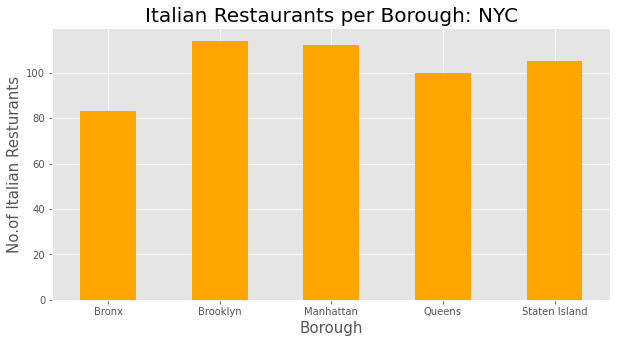

In [18]:
clr = "orange"
italian_rest_ny.groupby('Borough')['ID'].count().plot.bar(figsize=(10,5), color = clr)
plt.title('Italian Restaurants per Borough: NYC', fontsize = 20)
plt.xlabel('Borough', fontsize = 15)
plt.ylabel('No.of Italian Resturants', fontsize=15)
plt.xticks(rotation = 'horizontal')
plt.show()

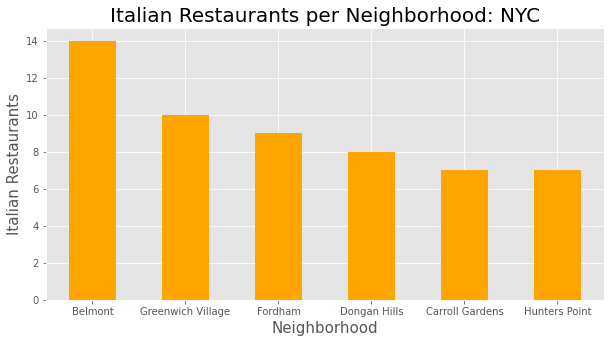

In [19]:
NOofNeigh = 6 # top number for graphing all the same past 6
italian_rest_ny.groupby('Neighborhood')['ID'].count().nlargest(NOofNeigh).plot.bar(figsize=(10,5), color=clr)
plt.title('Italian Restaurants per Neighborhood: NYC', fontsize = 20)
plt.xlabel('Neighborhood', fontsize = 15)
plt.ylabel('Italian Restaurants', fontsize=15)
plt.xticks(rotation = 'horizontal')
plt.show()

In [13]:
italian_rest_ny[italian_rest_ny['Neighborhood']=='Belmont']

,Unnamed: 0,Borough,Neighborhood,ID,Name
6,6,Bronx,Belmont,4acf80aef964a52025d420e3,Tino's Delicatessen
7,7,Bronx,Belmont,59050f51b23dfa5f6649e678,Arthur Avenue Fiasco
8,8,Bronx,Belmont,4af71916f964a520cf0522e3,Michaelangelo's Coal Fired Brick Oven Pizza Re...
9,9,Bronx,Belmont,4c9b9e7b9c663704b90463fd,Gerbasi Ristorante
10,10,Bronx,Belmont,4bb6470cef159c7465b275f7,Calabria Pork Store
11,11,Bronx,Belmont,4bc22a22920eb713bcc51b2c,Tra Di Noi
12,12,Bronx,Belmont,4af0fa29f964a52060e021e3,Antonio's Trattoria
13,13,Bronx,Belmont,4aa193d5f964a520124120e3,Mario's Restaurant & Catering
14,14,Bronx,Belmont,4b5514c4f964a5207cda27e3,Enzo's
15,15,Bronx,Belmont,4b5a4c8ff964a52049bb28e3,Emilia's Restaurant


In [20]:
column_names=['Borough', 'Neighborhood', 'ID','Name','Likes','Rating','Tips']
italian_rest_stats_ny=pd.DataFrame(columns=column_names)
count=1
for row in italian_rest_ny.values.tolist():
    Borough,Neighborhood,ID,Name=row
    try:
        venue_details=get_venue_details(ID)
        print(venue_details)
        id,name,likes,rating,tips=venue_details.values.tolist()[0]
    except IndexError:
        print('No data available for id=',ID)
        # we will assign 0 value for these resturants as they may have been 
        #recently opened or details does not exist in FourSquare Database
        id,name,likes,rating,tips=[0]*5
    print('(',count,'/',len(italian_rest_ny),')','processed')
    italian_rest_stats_ny = italian_rest_stats_ny.append({'Borough': Borough,
                                                'Neighborhood': Neighborhood, 
                                                'ID': id,
                                                'Name' : name,
                                                'Likes' : likes,
                                                'Rating' : rating,
                                                'Tips' : tips
                                               }, ignore_index=True)
    count+=1
italian_rest_stats_ny.tail()

ValueError: too many values to unpack (expected 4)